# Importing libraries and data


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
import copy
import seaborn as sns
%matplotlib inline

from statsmodels.tsa.stattools import adfuller

# setting colors for plots.
colors = ['#794C74', '#00AF91', '#F39233', '#0F9D58']
sns.set_palette(colors)
plt.rc('font', size=14)

In [ ]:
# connecting google drive
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
rainfall = pd.read_csv("/content/drive/MyDrive/MCMP/Data/Sub_Division_IMD_2017.csv")

In [ ]:
rainfall.head(20)

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,JF,MAM,JJAS,OND
0,Andaman & Nicobar Islands,1901,49.2,87.1,29.2,2.3,528.8,517.5,365.1,481.1,332.6,388.5,558.2,33.6,3373.2,136.3,560.3,1696.3,980.3
1,Andaman & Nicobar Islands,1902,0.0,159.8,12.2,0.0,446.1,537.1,228.9,753.7,666.2,197.2,359.0,160.5,3520.7,159.8,458.3,2185.9,716.7
2,Andaman & Nicobar Islands,1903,12.7,144.0,0.0,1.0,235.1,479.9,728.4,326.7,339.0,181.2,284.4,225.0,2957.4,156.7,236.1,1874.0,690.6
3,Andaman & Nicobar Islands,1904,9.4,14.7,0.0,202.4,304.5,495.1,502.0,160.1,820.4,222.2,308.7,40.1,3079.6,24.1,506.9,1977.6,571.0
4,Andaman & Nicobar Islands,1905,1.3,0.0,3.3,26.9,279.5,628.7,368.7,330.5,297.0,260.7,25.4,344.7,2566.7,1.3,309.7,1624.9,630.8
5,Andaman & Nicobar Islands,1906,36.6,0.0,0.0,0.0,556.1,733.3,247.7,320.5,164.3,267.8,128.9,79.2,2534.4,36.6,556.1,1465.8,475.9
6,Andaman & Nicobar Islands,1907,110.7,0.0,113.3,21.6,616.3,305.2,443.9,377.6,200.4,264.4,648.9,245.6,3347.9,110.7,751.2,1327.1,1158.9
7,Andaman & Nicobar Islands,1908,20.9,85.1,0.0,29.0,562.0,693.6,481.4,699.9,428.8,170.7,208.1,196.9,3576.4,106.0,591.0,2303.7,575.7
8,Andaman & Nicobar Islands,1910,26.6,22.7,206.3,89.3,224.5,472.7,264.3,337.4,626.6,208.2,267.3,153.5,2899.4,49.3,520.1,1701.0,629.0
9,Andaman & Nicobar Islands,1911,0.0,8.4,0.0,122.5,327.3,649.0,253.0,187.1,464.5,333.8,94.5,247.1,2687.2,8.4,449.8,1553.6,675.4


In [ ]:
rainfall[rainfall['YEAR'] == 2017]

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,JF,MAM,JJAS,OND
111,Andaman & Nicobar Islands,2017,228.7,5.6,33.0,108.3,275.8,349.1,389.4,414.7,372.8,263.0,205.9,243.7,2890.0,234.2,417.1,1526.0,712.6
210,Arunachal Pradesh,2017,8.2,86.2,221.8,348.2,257.1,370.8,437.8,456.4,318.6,227.1,9.9,3.4,2745.3,94.4,827.0,1583.5,240.3
327,Assam & Meghalaya,2017,1.7,37.8,116.7,310.9,268.4,485.2,429.0,483.1,345.4,212.1,10.3,11.0,2711.7,39.5,695.9,1742.7,233.5
444,Naga Mani Mizo Tripura,2017,0.8,11.9,125.3,277.6,196.7,502.7,431.5,543.3,352.2,287.6,7.6,68.1,2805.4,12.7,599.7,1829.8,363.3
561,Sub Himalayan West Bengal & Sikkim,2017,3.0,5.1,84.6,146.8,226.8,400.6,478.6,777.9,390.1,166.5,3.8,1.0,2684.9,8.1,458.2,2047.3,171.3
678,Gangetic West Bengal,2017,1.4,0.0,35.2,25.8,106.3,193.7,489.3,264.5,191.4,225.2,21.9,14.0,1568.6,1.4,167.3,1138.9,261.1
795,Orissa,2017,1.7,0.0,29.8,8.7,55.2,209.5,349.7,301.7,192.2,161.1,30.0,4.8,1344.5,1.7,93.8,1053.1,195.9
912,Jharkhand,2017,5.1,0.1,4.5,6.1,55.9,116.0,492.1,246.0,134.0,103.4,2.3,0.2,1165.8,5.2,66.6,988.2,105.9
1029,Bihar,2017,0.7,0.0,22.8,21.8,79.7,84.6,379.9,342.8,129.6,50.1,0.0,0.0,1112.0,0.7,124.3,936.8,50.2
1146,East Uttar Pradesh,2017,9.7,0.1,4.3,2.0,25.8,50.8,328.9,185.1,85.2,3.0,0.0,0.0,695.0,9.8,32.2,650.0,3.0


# EDA


In [ ]:
rainfall.shape

(4188, 19)

In [ ]:
rainfall.describe()

,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,JF,MAM,JJAS,OND
count,4188.000000,4184.000000,4185.000000,4182.000000,4184.000000,4185.000000,4183.000000,4181.000000,4184.000000,4182.000000,4181.000000,4177.000000,4178.000000,4162.000000,4182.000000,4179.000000,4178.000000,4175.000000
mean,1959.220630,18.938337,21.599427,27.412912,43.071845,85.660860,230.117475,347.020043,289.742185,197.316332,95.324707,39.496433,18.968645,1409.449207,40.522979,155.820914,1063.851580,153.648623
std,33.717097,33.793128,35.731734,46.927963,68.150985,122.695137,234.292087,268.850702,188.426071,135.547646,99.194851,68.358706,43.053759,902.599421,59.293904,201.198627,706.666045,166.863171
min,1901.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.400000,0.000000,0.000000,0.100000,0.000000,0.000000,0.000000,62.300000,0.000000,0.000000,57.400000,0.000000
25%,1930.000000,0.600000,0.500000,1.000000,3.000000,8.600000,70.800000,175.600000,155.850000,100.400000,14.600000,0.600000,0.100000,803.025000,4.000000,24.000000,573.850000,34.000000
50%,1959.000000,5.950000,6.500000,7.900000,15.450000,36.900000,138.800000,285.000000,258.500000,173.700000,65.200000,9.400000,3.000000,1120.350000,18.900000,74.800000,880.600000,97.700000
75%,1988.000000,22.000000,26.600000,31.375000,49.650000,97.800000,305.000000,418.500000,377.625000,266.125000,148.300000,45.300000,17.500000,1643.575000,50.175000,196.950000,1287.450000,211.800000
max,2017.000000,583.700000,403.500000,605.600000,595.100000,1168.600000,1609.900000,2362.800000,1664.600000,1222.000000,948.300000,648.900000,617.500000,6331.100000,699.500000,1745.800000,4536.900000,1252.500000


In [ ]:
rainfall.isna().sum()

SUBDIVISION     0
YEAR            0
JAN             4
FEB             3
MAR             6
APR             4
MAY             3
JUN             5
JUL             7
AUG             4
SEP             6
OCT             7
NOV            11
DEC            10
ANNUAL         26
JF              6
MAM             9
JJAS           10
OND            13
dtype: int64

In [ ]:
# Calculating the number of negative values in the numerical columns of the DataFrame
num_columns = rainfall.select_dtypes(include=[np.number])
negative_values = np.sum(num_columns < 0)
negative_values

YEAR      0
JAN       0
FEB       0
MAR       0
APR       0
MAY       0
JUN       0
JUL       0
AUG       0
SEP       0
OCT       0
NOV       0
DEC       0
ANNUAL    0
JF        0
MAM       0
JJAS      0
OND       0
dtype: int64

In [ ]:
# Get rows with at least one null value
num_columns = rainfall.select_dtypes(include=[np.number])
nan_rows = np.any(num_columns.isna(), axis=1)

# Display rows with at least one null value
rainfall_nan = rainfall[nan_rows]
rainfall_nan

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,JF,MAM,JJAS,OND
21,Andaman & Nicobar Islands,1923,79.5,0.0,NaN,91.3,293.5,808.4,636.9,182.2,560.5,131.9,197.4,70.6,NaN,79.5,NaN,2188.0,399.9
22,Andaman & Nicobar Islands,1924,28.7,0.0,14.8,89.7,191.2,261.2,493.3,290.9,251.2,331.1,378.6,NaN,NaN,28.7,295.7,1296.6,NaN
30,Andaman & Nicobar Islands,1932,2.8,2.5,10.1,58.2,479.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.3,548.0,NaN,NaN
34,Andaman & Nicobar Islands,1936,16.5,15.3,116.5,NaN,194.3,498.3,664.8,562.9,383.8,174.9,199.2,212.2,NaN,31.8,NaN,2109.8,586.3
40,Andaman & Nicobar Islands,1942,39.2,7.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,46.6,NaN,NaN,NaN
42,Andaman & Nicobar Islands,1947,25.1,111.1,63.2,127.7,206.3,965.6,490.0,293.7,NaN,376.0,67.5,168.6,NaN,136.2,397.2,NaN,612.1
112,Arunachal Pradesh,1916,48.1,69.8,71.1,316.1,424.6,1124.9,NaN,629.7,333.9,NaN,NaN,NaN,NaN,117.9,811.8,NaN,NaN
113,Arunachal Pradesh,1917,21.4,164.5,NaN,269.6,107.9,823.8,909.1,628.4,411.5,199.3,63.5,0.0,NaN,185.9,NaN,2772.8,262.8
146,Arunachal Pradesh,1950,38.6,92.8,205.8,425.2,274.2,NaN,377.6,241.8,285.8,356.0,49.5,43.9,NaN,131.4,905.2,NaN,449.4
149,Arunachal Pradesh,1953,56.4,106.9,236.0,214.9,314.9,409.9,512.5,245.3,449.8,NaN,10.4,23.4,NaN,163.3,765.8,1617.5,NaN


In [ ]:
rainfall.dtypes

SUBDIVISION     object
YEAR             int64
JAN            float64
FEB            float64
MAR            float64
APR            float64
MAY            float64
JUN            float64
JUL            float64
AUG            float64
SEP            float64
OCT            float64
NOV            float64
DEC            float64
ANNUAL         float64
JF             float64
MAM            float64
JJAS           float64
OND            float64
dtype: object

In [ ]:
filtered_rainfall = rainfall[rainfall['YEAR'] >= 2000]

In [ ]:
filtered_rainfall.head()

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,JF,MAM,JJAS,OND
94,Andaman & Nicobar Islands,2000,53.0,59.0,171.3,218.1,422.8,357.0,176.3,460.8,250.1,321.2,158.3,115.2,2763.2,112.0,812.2,1244.2,594.7
95,Andaman & Nicobar Islands,2001,89.0,15.7,143.3,30.1,705.3,370.7,341.3,469.0,334.4,267.6,222.6,91.8,3080.9,104.7,878.7,1515.4,582.0
96,Andaman & Nicobar Islands,2002,10.6,0.0,11.5,100.2,366.7,358.3,317.4,429.8,420.0,169.0,306.7,129.9,2620.2,10.7,478.4,1525.6,605.5
97,Andaman & Nicobar Islands,2003,44.3,7.9,149.2,19.4,296.3,159.9,494.9,379.4,371.9,310.4,74.1,48.0,2355.9,52.2,465.0,1406.1,432.5
98,Andaman & Nicobar Islands,2004,54.5,35.9,36.5,41.6,505.1,423.9,378.9,308.7,280.7,223.9,169.9,0.4,2460.1,90.4,583.2,1392.2,394.2


In [ ]:
filtered_rainfall.isna().sum()

SUBDIVISION    0
YEAR           0
JAN            1
FEB            1
MAR            0
APR            0
MAY            0
JUN            0
JUL            1
AUG            0
SEP            0
OCT            0
NOV            1
DEC            1
ANNUAL         3
JF             2
MAM            0
JJAS           1
OND            1
dtype: int64

In [ ]:
# Get rows with at least one negative number
num_columns = filtered_rainfall.select_dtypes(include=[np.number])
nan_rows = np.any(num_columns.isna(), axis=1)

# Display rows with at least one negative number
filtered_rainfall_nan = filtered_rainfall[nan_rows]
filtered_rainfall_nan

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,JF,MAM,JJAS,OND
1840,Jammu & Kashmir,2009,120.3,117.9,63.7,113.5,64.3,64.1,NaN,96.5,50.5,8.1,NaN,NaN,NaN,238.2,241.5,NaN,NaN
2182,West Madhya Pradesh,2000,0.1,NaN,0.1,0.1,30.1,93.4,320.5,136.2,31.6,1.2,0.0,0.2,NaN,NaN,30.3,581.7,1.4
3715,Coastal Karnataka,2012,NaN,11.4,5.1,77.0,22.9,650.9,754.6,1027.6,382.0,115.1,68.0,3.6,NaN,NaN,104.9,2815.1,186.7


## Fill forward imputation

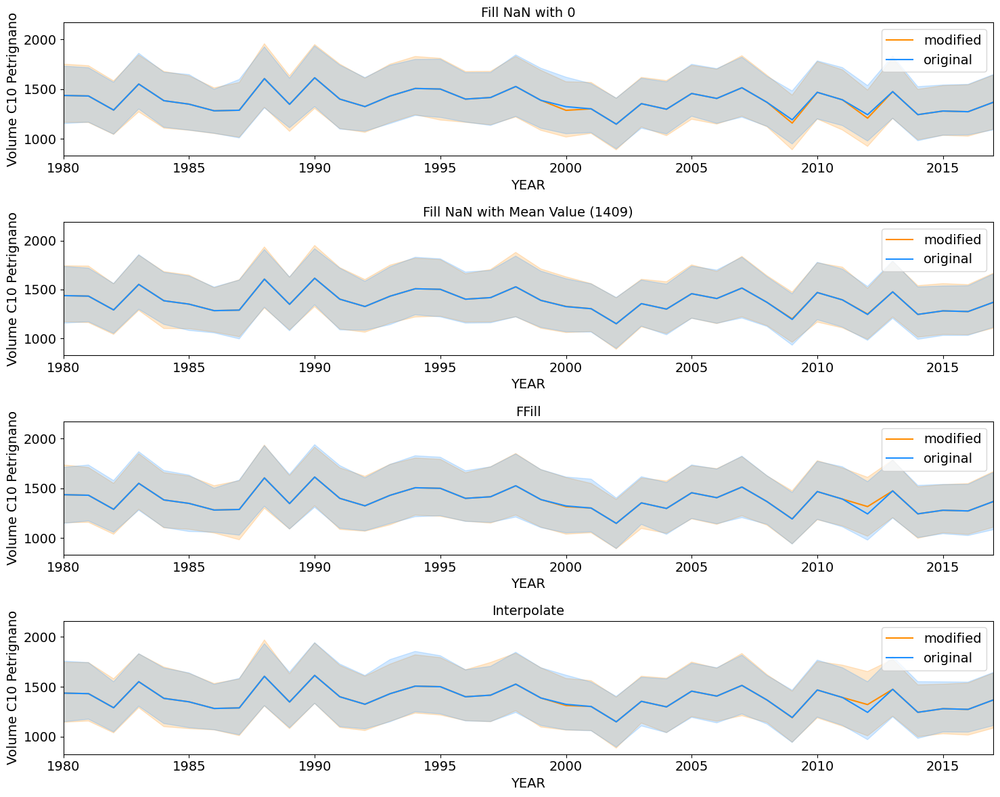

In [ ]:

# Fill NaN with 0
fig, ax = plt.subplots(nrows=4, ncols=1, figsize=(15, 12))
sns.lineplot(x=rainfall['YEAR'], y=rainfall['ANNUAL'].fillna(0), ax=ax[0], color='darkorange', label='modified')
sns.lineplot(x=rainfall['YEAR'], y=rainfall['ANNUAL'].fillna(np.inf), ax=ax[0], color='dodgerblue', label='original')
ax[0].set_title('Fill NaN with 0', fontsize=14)
ax[0].set_ylabel(ylabel='Volume C10 Petrignano', fontsize=14)

# Fill NaN with mean value
mean_value = rainfall['ANNUAL'].mean()
sns.lineplot(x=rainfall['YEAR'], y=rainfall['ANNUAL'].fillna(mean_value), ax=ax[1], color='darkorange', label='modified')
sns.lineplot(x=rainfall['YEAR'], y=rainfall['ANNUAL'].fillna(np.inf), ax=ax[1], color='dodgerblue', label='original')
ax[1].set_title(f'Fill NaN with Mean Value ({mean_value:.0f})', fontsize=14)
ax[1].set_ylabel(ylabel='Volume C10 Petrignano', fontsize=14)

# Forward fill (FFill)
sns.lineplot(x=rainfall['YEAR'], y=rainfall['ANNUAL'].ffill(), ax=ax[2], color='darkorange', label='modified')
sns.lineplot(x=rainfall['YEAR'], y=rainfall['ANNUAL'].fillna(np.inf), ax=ax[2], color='dodgerblue', label='original')
ax[2].set_title(f'FFill', fontsize=14)
ax[2].set_ylabel(ylabel='Volume C10 Petrignano', fontsize=14)

# Interpolation
sns.lineplot(x=rainfall['YEAR'], y=rainfall['ANNUAL'].interpolate(), ax=ax[3], color='darkorange', label='modified')
sns.lineplot(x=rainfall['YEAR'], y=rainfall['ANNUAL'].fillna(np.inf), ax=ax[3], color='dodgerblue', label='original')
ax[3].set_title(f'Interpolate', fontsize=14)
ax[3].set_ylabel(ylabel='Volume C10 Petrignano', fontsize=14)

for i in range(4):
    ax[i].set_xlim(1980, 2017)

plt.tight_layout()
plt.show()


In [ ]:
# Identify the monthly columns with missing values
monthly_columns_with_missing = ['JAN', 'FEB',	'MAR', 'APR',	'MAY',	'JUN',	'JUL',	'AUG',	'SEP',	'OCT',	'NOV',	'DEC']

# Apply forward fill imputation to fill missing values in monthly columns
rainfall[monthly_columns_with_missing] = rainfall[monthly_columns_with_missing].fillna(method='ffill')


In [ ]:
# Get rows with at least one null value
num_columns = rainfall.select_dtypes(include=[np.number])
nan_rows = np.any(num_columns.isna(), axis=1)

# Display rows with at least one null value
rainfall_nan = rainfall[nan_rows]
rainfall_nan

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,JF,MAM,JJAS,OND
21,Andaman & Nicobar Islands,1923,79.5,0.0,15.6,91.3,293.5,808.4,636.9,182.2,560.5,131.9,197.4,70.6,NaN,79.5,NaN,2188.0,399.9
22,Andaman & Nicobar Islands,1924,28.7,0.0,14.8,89.7,191.2,261.2,493.3,290.9,251.2,331.1,378.6,70.6,NaN,28.7,295.7,1296.6,NaN
30,Andaman & Nicobar Islands,1932,2.8,2.5,10.1,58.2,479.7,393.5,289.3,571.0,294.4,368.3,22.8,182.7,NaN,5.3,548.0,NaN,NaN
34,Andaman & Nicobar Islands,1936,16.5,15.3,116.5,133.6,194.3,498.3,664.8,562.9,383.8,174.9,199.2,212.2,NaN,31.8,NaN,2109.8,586.3
40,Andaman & Nicobar Islands,1942,39.2,7.4,0.0,77.8,251.9,497.0,302.5,311.9,516.0,382.8,266.0,279.5,NaN,46.6,NaN,NaN,NaN
42,Andaman & Nicobar Islands,1947,25.1,111.1,63.2,127.7,206.3,965.6,490.0,293.7,478.3,376.0,67.5,168.6,NaN,136.2,397.2,NaN,612.1
112,Arunachal Pradesh,1916,48.1,69.8,71.1,316.1,424.6,1124.9,389.4,629.7,333.9,263.0,205.9,243.7,NaN,117.9,811.8,NaN,NaN
113,Arunachal Pradesh,1917,21.4,164.5,71.1,269.6,107.9,823.8,909.1,628.4,411.5,199.3,63.5,0.0,NaN,185.9,NaN,2772.8,262.8
146,Arunachal Pradesh,1950,38.6,92.8,205.8,425.2,274.2,943.9,377.6,241.8,285.8,356.0,49.5,43.9,NaN,131.4,905.2,NaN,449.4
149,Arunachal Pradesh,1953,56.4,106.9,236.0,214.9,314.9,409.9,512.5,245.3,449.8,257.9,10.4,23.4,NaN,163.3,765.8,1617.5,NaN


In [ ]:
rainfall.isna().count()

SUBDIVISION    4188
YEAR           4188
JAN            4188
FEB            4188
MAR            4188
APR            4188
MAY            4188
JUN            4188
JUL            4188
AUG            4188
SEP            4188
OCT            4188
NOV            4188
DEC            4188
ANNUAL         4188
JF             4188
MAM            4188
JJAS           4188
OND            4188
dtype: int64

In [ ]:
rainfall['JF'] = np.where(rainfall['JF'].isnull(), rainfall[['JAN', 'FEB']].sum(axis=1).round(1), rainfall['JF'])
rainfall['MAM'] = np.where(rainfall['MAM'].isnull(), rainfall[['MAR', 'APR', 'MAY']].sum(axis=1).round(1), rainfall['MAM'])
rainfall['JJAS'] = np.where(rainfall['JJAS'].isnull(), rainfall[['JUN', 'JUL', 'AUG', 'SEP']].sum(axis=1).round(1), rainfall['JJAS'])
rainfall['OND'] = np.where(rainfall['OND'].isnull(), rainfall[['OCT', 'NOV', 'DEC']].sum(axis=1).round(1), rainfall['OND'])

In [ ]:
# Get rows with at least one null value
num_columns = rainfall.select_dtypes(include=[np.number])
nan_rows = np.any(num_columns.isna(), axis=1)

# Display rows with at least one null value
rainfall_nan = rainfall[nan_rows]
rainfall_nan

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,JF,MAM,JJAS,OND
21,Andaman & Nicobar Islands,1923,79.5,0.0,15.6,91.3,293.5,808.4,636.9,182.2,560.5,131.9,197.4,70.6,NaN,79.5,400.4,2188.0,399.9
22,Andaman & Nicobar Islands,1924,28.7,0.0,14.8,89.7,191.2,261.2,493.3,290.9,251.2,331.1,378.6,70.6,NaN,28.7,295.7,1296.6,780.3
30,Andaman & Nicobar Islands,1932,2.8,2.5,10.1,58.2,479.7,393.5,289.3,571.0,294.4,368.3,22.8,182.7,NaN,5.3,548.0,1548.2,573.8
34,Andaman & Nicobar Islands,1936,16.5,15.3,116.5,133.6,194.3,498.3,664.8,562.9,383.8,174.9,199.2,212.2,NaN,31.8,444.4,2109.8,586.3
40,Andaman & Nicobar Islands,1942,39.2,7.4,0.0,77.8,251.9,497.0,302.5,311.9,516.0,382.8,266.0,279.5,NaN,46.6,329.7,1627.4,928.3
42,Andaman & Nicobar Islands,1947,25.1,111.1,63.2,127.7,206.3,965.6,490.0,293.7,478.3,376.0,67.5,168.6,NaN,136.2,397.2,2227.6,612.1
112,Arunachal Pradesh,1916,48.1,69.8,71.1,316.1,424.6,1124.9,389.4,629.7,333.9,263.0,205.9,243.7,NaN,117.9,811.8,2477.9,712.6
113,Arunachal Pradesh,1917,21.4,164.5,71.1,269.6,107.9,823.8,909.1,628.4,411.5,199.3,63.5,0.0,NaN,185.9,448.6,2772.8,262.8
146,Arunachal Pradesh,1950,38.6,92.8,205.8,425.2,274.2,943.9,377.6,241.8,285.8,356.0,49.5,43.9,NaN,131.4,905.2,1849.1,449.4
149,Arunachal Pradesh,1953,56.4,106.9,236.0,214.9,314.9,409.9,512.5,245.3,449.8,257.9,10.4,23.4,NaN,163.3,765.8,1617.5,291.7


In [ ]:
# Calculate the sum of JF, MAM, JJAS, and OND columns only for missing values in the annual column
rainfall['ANNUAL'] = np.where(rainfall['ANNUAL'].isnull(), rainfall[['JF', 'MAM', 'JJAS', 'OND']].sum(axis=1).round(1), rainfall['ANNUAL'])

In [ ]:
# Get rows with at least one null value
num_columns = rainfall.select_dtypes(include=[np.number])
nan_rows = np.any(num_columns.isna(), axis=1)

# Display rows with at least one null value
rainfall_nan = rainfall[nan_rows]
rainfall_nan

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,JF,MAM,JJAS,OND


In [ ]:
rainfall.head(50)

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,JF,MAM,JJAS,OND
0,Andaman & Nicobar Islands,1901,49.2,87.1,29.2,2.3,528.8,517.5,365.1,481.1,332.6,388.5,558.2,33.6,3373.2,136.3,560.3,1696.3,980.3
1,Andaman & Nicobar Islands,1902,0.0,159.8,12.2,0.0,446.1,537.1,228.9,753.7,666.2,197.2,359.0,160.5,3520.7,159.8,458.3,2185.9,716.7
2,Andaman & Nicobar Islands,1903,12.7,144.0,0.0,1.0,235.1,479.9,728.4,326.7,339.0,181.2,284.4,225.0,2957.4,156.7,236.1,1874.0,690.6
3,Andaman & Nicobar Islands,1904,9.4,14.7,0.0,202.4,304.5,495.1,502.0,160.1,820.4,222.2,308.7,40.1,3079.6,24.1,506.9,1977.6,571.0
4,Andaman & Nicobar Islands,1905,1.3,0.0,3.3,26.9,279.5,628.7,368.7,330.5,297.0,260.7,25.4,344.7,2566.7,1.3,309.7,1624.9,630.8
5,Andaman & Nicobar Islands,1906,36.6,0.0,0.0,0.0,556.1,733.3,247.7,320.5,164.3,267.8,128.9,79.2,2534.4,36.6,556.1,1465.8,475.9
6,Andaman & Nicobar Islands,1907,110.7,0.0,113.3,21.6,616.3,305.2,443.9,377.6,200.4,264.4,648.9,245.6,3347.9,110.7,751.2,1327.1,1158.9
7,Andaman & Nicobar Islands,1908,20.9,85.1,0.0,29.0,562.0,693.6,481.4,699.9,428.8,170.7,208.1,196.9,3576.4,106.0,591.0,2303.7,575.7
8,Andaman & Nicobar Islands,1910,26.6,22.7,206.3,89.3,224.5,472.7,264.3,337.4,626.6,208.2,267.3,153.5,2899.4,49.3,520.1,1701.0,629.0
9,Andaman & Nicobar Islands,1911,0.0,8.4,0.0,122.5,327.3,649.0,253.0,187.1,464.5,333.8,94.5,247.1,2687.2,8.4,449.8,1553.6,675.4


In [ ]:
year_data = rainfall.groupby('YEAR').mean()

<ipython-input-25-9b58465be9a2>:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  year_data = rainfall.groupby('YEAR').mean()


In [ ]:
year_data.head()

,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,JF,MAM,JJAS,OND
YEAR,,,,,,,,,,,,,,,,,
1901,35.220000,40.508571,21.097143,46.388571,70.434286,194.608571,291.208571,301.325714,134.154286,73.697143,64.757143,10.808571,1284.214286,75.722857,137.920000,921.305714,149.262857
1902,8.520000,8.305714,20.951429,45.771429,72.040000,168.820000,351.145714,239.800000,258.611429,86.714286,43.457143,33.151429,1337.302857,16.814286,138.777143,1018.385714,163.334286
1903,16.851429,14.342857,26.577143,16.974286,80.237143,171.988571,362.108571,299.482857,216.620000,125.345714,52.645714,23.074286,1406.234286,31.197143,123.768571,1050.194286,201.060000
1904,11.697143,9.391429,28.880000,41.402857,92.454286,237.485714,311.971429,217.014286,167.402857,84.551429,19.757143,14.771429,1236.771429,21.077143,162.734286,933.874286,119.085714
1905,23.200000,20.477143,40.940000,34.754286,76.437143,164.805714,288.314286,246.780000,179.260000,78.168571,16.025714,17.005714,1186.177143,43.674286,152.128571,879.171429,111.205714


In [ ]:
# % rainfall in each month over the years.
months_data = year_data.loc[:,'JAN':'ANNUAL']
months_data.head()

percent_rain = {}
cols = months_data.columns[:-1]

for col in cols:
    percent_rain[col] = round((months_data[col]/months_data['ANNUAL']).sum(), 2)

percent_df = pd.DataFrame(data = percent_rain.values(), index=percent_rain.keys(), columns=['Percent_rainfall'])
percent_df.style.background_gradient()

,Percent_rainfall
JAN,1.570000
FEB,1.780000
MAR,2.290000
APR,3.580000
MAY,7.080000
JUN,19.060000
JUL,28.680000
AUG,23.960000
SEP,16.250000
OCT,7.850000


SUBDIVISION
Arunachal Pradesh    3429.501010
Coastal Karnataka    3395.289744
Konkan & Goa         2987.531624
Name: ANNUAL, dtype: float64
SUBDIVISION
Haryana Delhi & Chandigarh    528.439316
Saurashtra & Kutch            496.398291
West Rajasthan                294.125641
Name: ANNUAL, dtype: float64


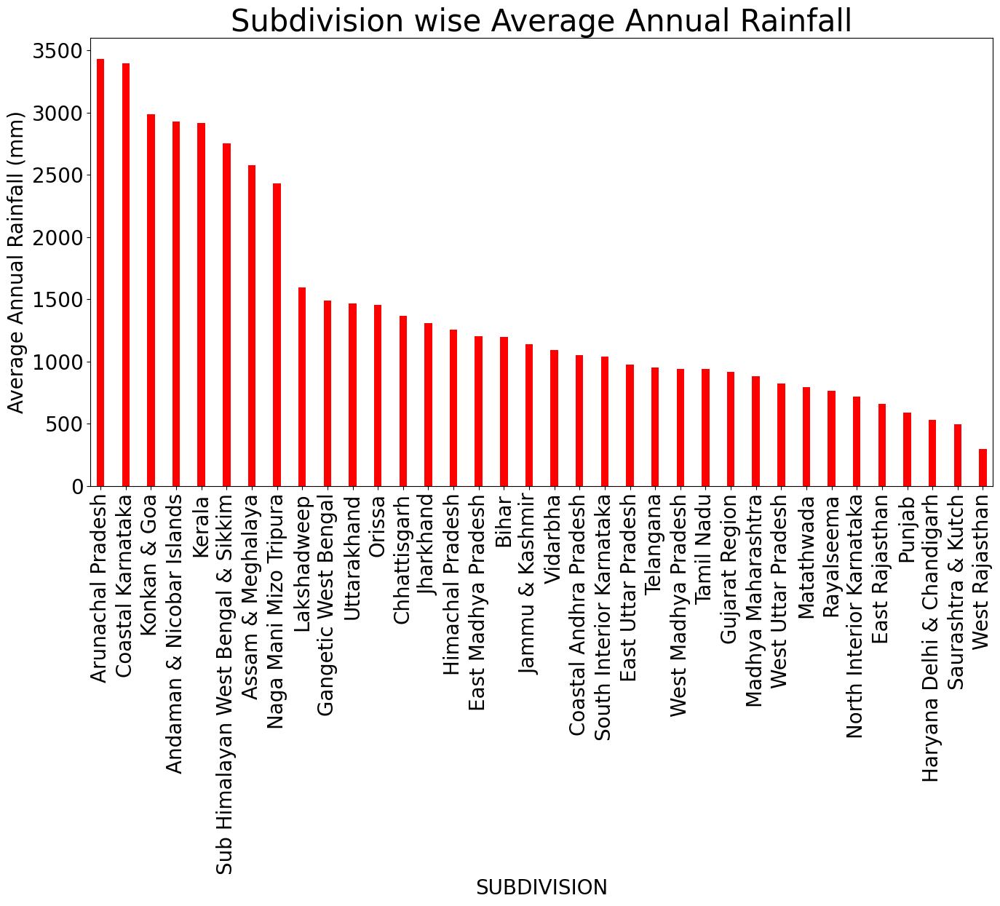

In [ ]:
fig = plt.figure(figsize=(16,8))
ax = fig.add_subplot(111)
rainfall.groupby('SUBDIVISION').mean().sort_values(by='ANNUAL', ascending=False)['ANNUAL'].plot(kind= 'bar', color='r',width=0.3,title='Subdivision wise Average Annual Rainfall', fontsize=20)
plt.xticks(rotation = 90)
plt.ylabel('Average Annual Rainfall (mm)')
ax.title.set_fontsize(30)
ax.xaxis.label.set_fontsize(20)
ax.yaxis.label.set_fontsize(20)
print(rainfall.groupby('SUBDIVISION').mean().sort_values(by='ANNUAL', ascending=False)['ANNUAL'][[0,1,2]])
print(rainfall.groupby('SUBDIVISION').mean().sort_values(by='ANNUAL', ascending=False)['ANNUAL'][[33,34,35]])

<ipython-input-29-b02578980d96>:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  dfg = rainfall.groupby('YEAR').sum()['ANNUAL']


Max: 61815.6 ocurred in [1961]
Min: 41273.6 ocurred in [1972]
Mean: 50681.28376068376


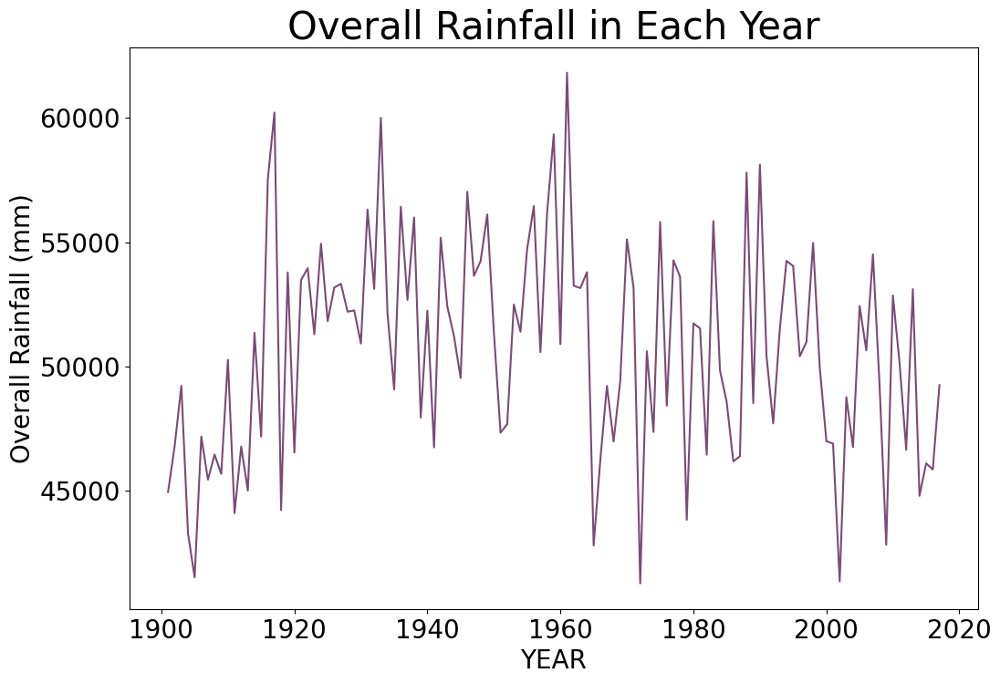

In [ ]:
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(111)
dfg = rainfall.groupby('YEAR').sum()['ANNUAL']
dfg.plot(kind= 'line', title='Overall Rainfall in Each Year', fontsize=20)
plt.ylabel('Overall Rainfall (mm)')
ax.title.set_fontsize(30)
ax.xaxis.label.set_fontsize(20)
ax.yaxis.label.set_fontsize(20)
print('Max: ' + str(dfg.max()) + ' ocurred in ' + str(dfg.loc[dfg == dfg.max()].index.values[0:]))
print('Min: ' + str(dfg.min()) + ' ocurred in ' + str(dfg.loc[dfg == dfg.min()].index.values[0:]))
print('Mean: ' + str(dfg.mean()))

Monthly Rainfalls Plot (Subdivision wise)

Max: 348.50049747373737 ocurred in ['JUL']
Min: 19.101479701120503 ocurred in ['JAN']
Mean: 118.86001679198965


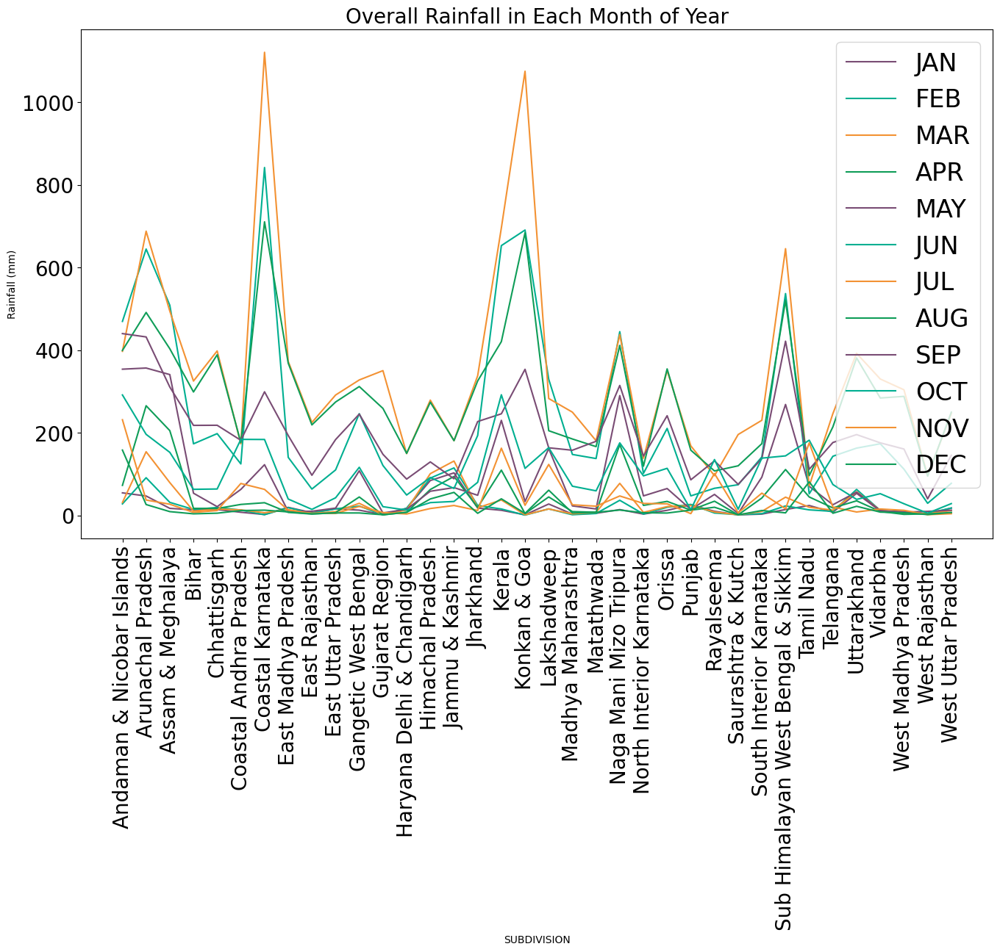

In [ ]:
months = rainfall.columns[2:14]
fig = plt.figure(figsize=(16,9))
ax = fig.add_subplot(111)
xlbls = rainfall['SUBDIVISION'].unique()
xlbls.sort()
dfg = rainfall.groupby('SUBDIVISION').mean()[months]
dfg.plot.line(title='Overall Rainfall in Each Month of Year', ax=ax,fontsize=20)
plt.xticks(np.linspace(0,35,36,endpoint=True),xlbls)
plt.xticks(  rotation = 90)
plt.ylabel('Rainfall (mm)')
plt.legend(loc='upper right', fontsize = 'xx-large')
ax.title.set_fontsize(20)
ax.xaxis.label.set_fontsize(10)
ax.yaxis.label.set_fontsize(10)

dfg = dfg.mean(axis=0)
print('Max: ' + str(dfg.max()) + ' ocurred in ' + str(dfg.loc[dfg == dfg.max()].index.values[0:]))
print('Min: ' + str(dfg.min()) + ' ocurred in ' + str(dfg.loc[dfg == dfg.min()].index.values[0:]))
print('Mean: ' + str(dfg.mean()))

Monthly Rainfalls Plot (Yearwise)

<ipython-input-31-f9626410fc09>:4: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  rainfall.groupby('YEAR').mean()[months].plot.line(title='Overall Rainfall in Each Month of Year', ax=ax,fontsize=20)


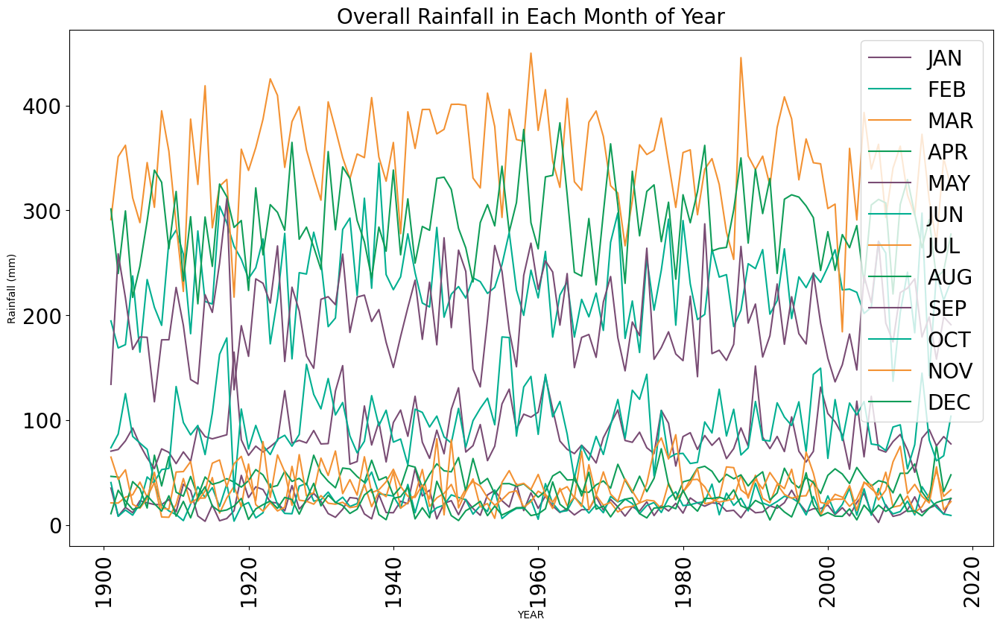

In [ ]:
months = rainfall.columns[2:14]
fig = plt.figure(figsize=(16,9))
ax = fig.add_subplot(111)
rainfall.groupby('YEAR').mean()[months].plot.line(title='Overall Rainfall in Each Month of Year', ax=ax,fontsize=20)
plt.xticks(  rotation = 90)
plt.ylabel('Rainfall (mm)')
plt.legend(loc='upper right', fontsize = 'x-large')
ax.title.set_fontsize(20)
ax.xaxis.label.set_fontsize(10)
ax.yaxis.label.set_fontsize(10)

## Pre-monsoon plots

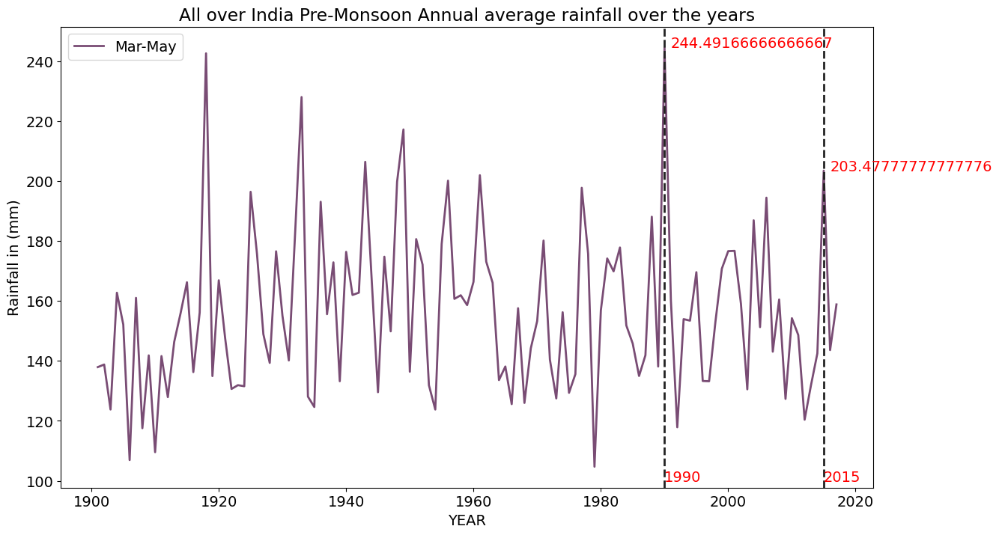

In [ ]:
# Let's examine rainfall trends in 'Mar_May'(pre-monsoon)

min_data = year_data['MAM'].min()

max_data = year_data['MAM'].max()
max_data_yr = year_data[year_data['MAM'] == max_data].index[0]

last_max_data = year_data.loc[2010:2020, 'MAM'].max()
last_max_data_yr = year_data[year_data['MAM'] == last_max_data].index[0]

plt.figure(figsize=(14, 8))
sns.lineplot(data = year_data,x = year_data.index, y = 'MAM', linewidth=2, label='Mar-May')

plt.axvline(x = max_data_yr, linewidth=2, linestyle= '--', color='#222')
plt.text(max_data_yr+1, y=max_data, s= max_data, color='r')
plt.text(max_data_yr, y=min_data-5, s= max_data_yr, color='r')

plt.axvline(x = last_max_data_yr, linewidth=2, linestyle= '--', color='#222')
plt.text(last_max_data_yr+1, y=last_max_data, s= last_max_data, color='r')
plt.text(last_max_data_yr, y=min_data-5, s= last_max_data_yr, color='r')

plt.ylabel("Rainfall in (mm)")
plt.title("All over India Pre-Monsoon Annual average rainfall over the years")

plt.show()

## Monsoon EDA

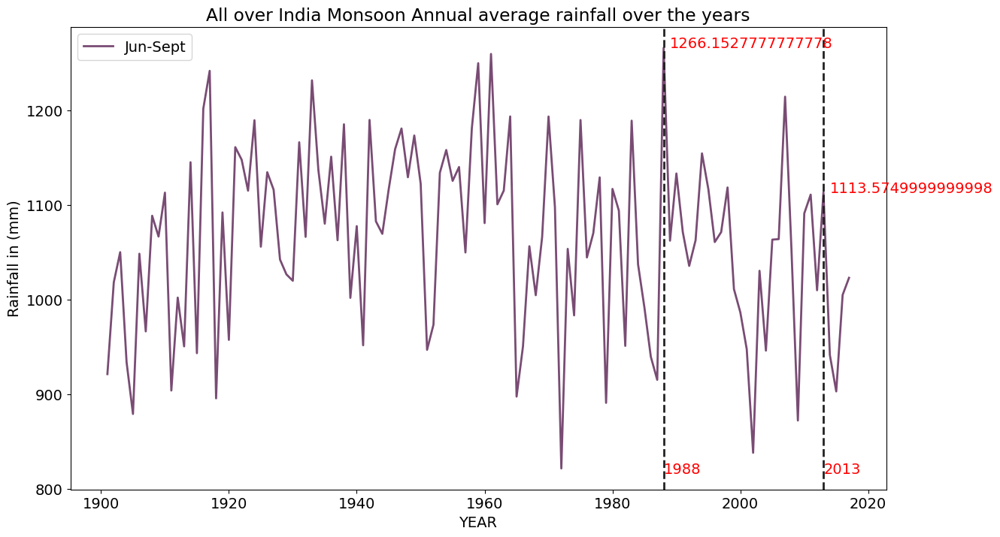

In [ ]:
# Let's examine rainfall trends in 'Jun_Sept' (monsoon)

min_data = year_data['JJAS'].min()

max_data = year_data['JJAS'].max()
max_data_yr = year_data[year_data['JJAS'] == max_data].index[0]

last_max_data = year_data.loc[2010:2020, 'JJAS'].max()
last_max_data_yr = year_data[year_data['JJAS'] == last_max_data].index[0]

plt.figure(figsize=(14, 8))
sns.lineplot(data = year_data,x = year_data.index, y = 'JJAS', linewidth=2, label='Jun-Sept')

plt.axvline(x = max_data_yr, linewidth=2, linestyle= '--', color='#222')
plt.text(max_data_yr+1, y=max_data, s= max_data, color='r')
plt.text(max_data_yr, y=min_data-5, s= max_data_yr, color='r')

plt.axvline(x = last_max_data_yr, linewidth=2, linestyle= '--', color='#222')
plt.text(last_max_data_yr+1, y=last_max_data, s= last_max_data, color='r')
plt.text(last_max_data_yr, y=min_data-5, s= last_max_data_yr, color='r')

plt.ylabel("Rainfall in (mm)")
plt.title("All over India Monsoon Annual average rainfall over the years")

plt.show()

## Monthly Average Rainfall in JULY & AUGUST

In [ ]:
def monsoon_plots(month):

    """Line plots and Trends"""

    months = {'JUL': 'July', 'AUG': 'August'}

    year_data[f'{month}_SMA_10'] = year_data[month].rolling(30, min_periods=10).mean()

    plt.figure(figsize=(14, 6))
    sns.scatterplot(data = year_data, x = year_data.index, y = month,label=months[month])
    sns.lineplot(data = year_data, x = year_data.index, y = f'{month}_SMA_10', linewidth=2, label= 'movAvg')

    plt.ylabel("Rainfall in (mm)")
    plt.title(f"Yearly Average Rainfall trend for {months[month]} month all over India.")

    plt.legend()
    plt.xticks(rotation=45)
    plt.show()

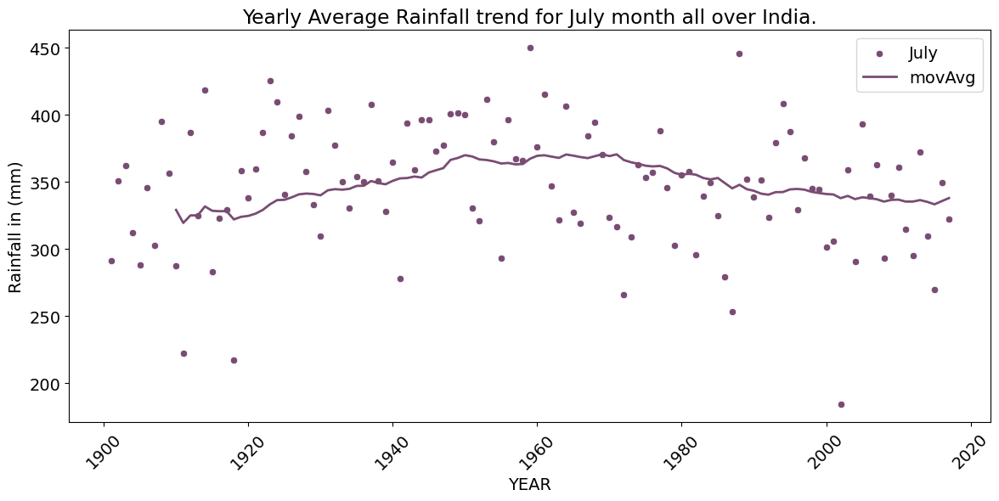

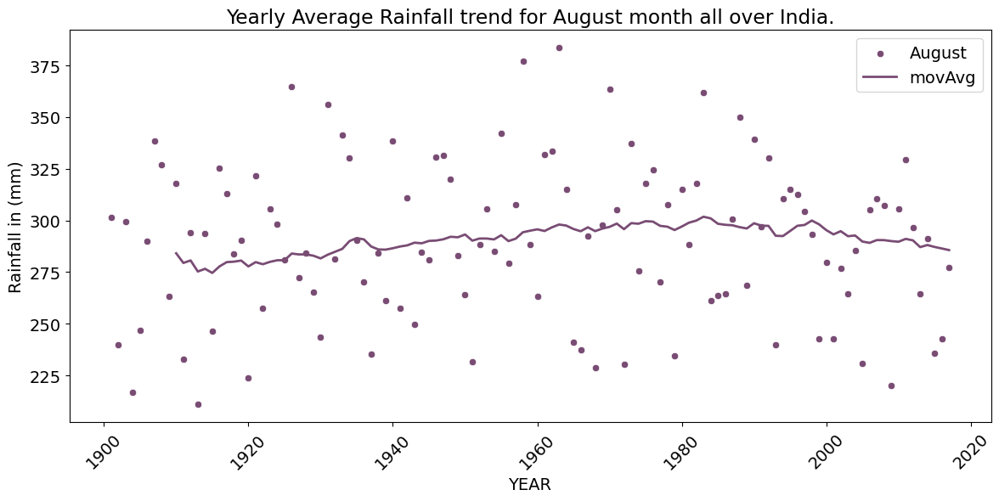

In [ ]:
# Annual Average rainfall observations in July and August.
monsoon_plots('JUL')
monsoon_plots('AUG')

We can see that, Rainfall in July shows increasing trend while rainfall in August shows decreasing trend all over India over the Years.

In [ ]:
import pandas as pd
import numpy as np

import statsmodels.api as sm
import statsmodels.tsa.api as smt
from statsmodels.tsa.stattools import adfuller
import statsmodels.formula.api as smf

import matplotlib.pyplot as plt
%matplotlib inline
import itertools

plt.style.use('bmh')

## Annual plots

<ipython-input-37-a64706b90198>:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  ax = rainfall.groupby("YEAR").mean()['ANNUAL'].plot(ylim=(600,2200),color='b',marker='o',linestyle='-',figsize=(15,8),
<ipython-input-37-a64706b90198>:6: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  rainfall['MA10'] = rainfall.groupby('YEAR').mean()['ANNUAL'].rolling(10).mean()


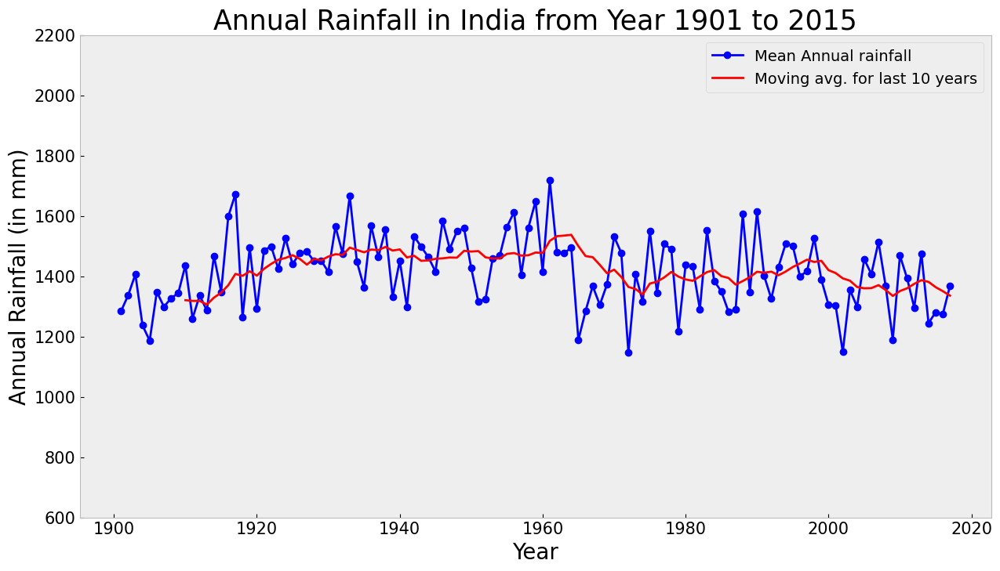

In [ ]:
# Plotting the mean annual rainfall
ax = rainfall.groupby("YEAR").mean()['ANNUAL'].plot(ylim=(600,2200),color='b',marker='o',linestyle='-',figsize=(15,8),
                                                legend=True, label='Mean Annual rainfall')

# Finding the moving average taking into consideration a period of 10 years and plotting
rainfall['MA10'] = rainfall.groupby('YEAR').mean()['ANNUAL'].rolling(10).mean()

rainfall.MA10.plot(color='r', linewidth=2, legend=True, label='Moving avg. for last 10 years' )

# Aesthetic of the plot
plt.xlabel('Year',fontsize=20)
plt.ylabel('Annual Rainfall (in mm)',fontsize=20)
plt.title('Annual Rainfall in India from Year 1901 to 2015',fontsize=25)
ax.tick_params(labelsize=15)
plt.grid()
plt.ioff()

Insights:
- Highest average rainfall in India was recored in the year 1961. This was because in 1961 India received multiple cyclones. City of Pune was flooded in the year 1961 which is remembered as Panshet Flood.

- Year 1965-66 were twin drought years and there was food scarcity in India. Prime Minister Lal Bahadur Shastri gave the Slogan Jai Jawan Jai Kissan to people of India. This lead to green revolution in India making India a food surplus country in the coming decades.

- The red line is the 10 year moving average of the rainfall in India. It seems since 1960s there is slight dip in the rainfall in India. Now a days due to global warming the period of Monsoon season has shortned. We see more of erratic rainfall pattern. This needs more study.

In [ ]:
# Annual observations for Rainfall?
year_data['SMA_10'] = year_data['ANNUAL'].rolling(20, min_periods=10).mean()

plt.figure(figsize=(14, 8))

sns.lineplot(data = year_data, x = year_data.index, y = 'ANNUAL', linewidth=2, label='Average')
sns.lineplot(data = year_data, x = year_data.index, y = 'SMA_10', linewidth=2, label='movAvg')

plt.ylabel("Rainfall in (mm)")
plt.title("Annual Average Rainfall in all over India", fontdict={'size':20})

plt.plot()

[]

### Moving average plot


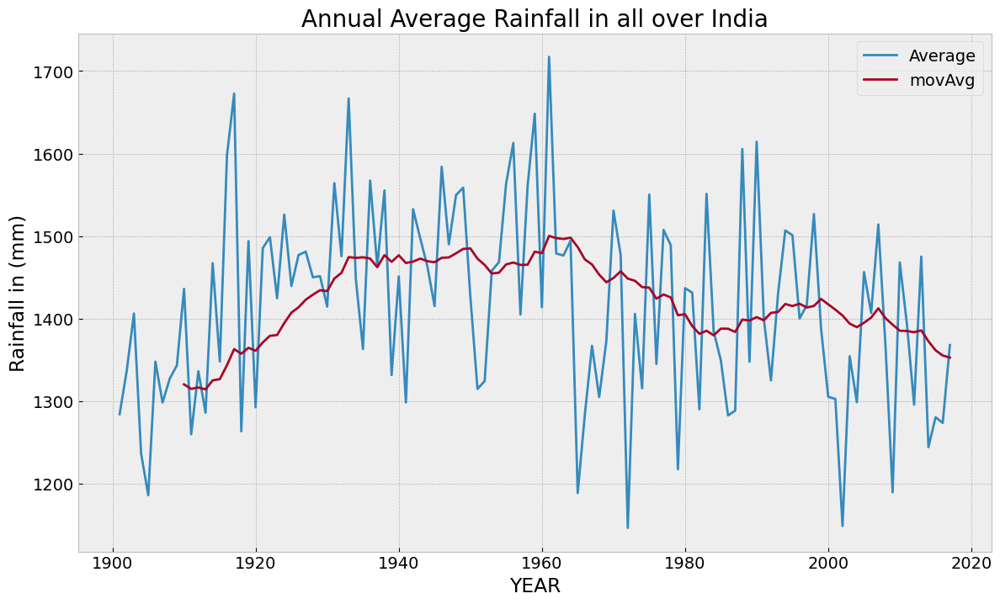

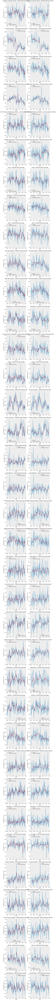

In [ ]:
subdivisions = rainfall["SUBDIVISION"].unique()
num_subdivisions = len(subdivisions)

fig, axes = plt.subplots(num_subdivisions, 2, sharey=False, sharex=False)
fig.set_figwidth(14)
fig.set_figheight(8 * num_subdivisions)

for i, subdivision in enumerate(subdivisions):
    if num_subdivisions == 1:
        ax = axes
    elif num_subdivisions > 1:
        ax = axes[i]
    else:
        break

    subdivision_rainfall = rainfall[rainfall["SUBDIVISION"] == subdivision]

    ax[0].plot(subdivision_rainfall["YEAR"], subdivision_rainfall["ANNUAL"], label='Original')
    ax[0].plot(subdivision_rainfall["YEAR"], subdivision_rainfall["ANNUAL"].rolling(window=4).mean(), label='4-Months Rolling Mean')
    ax[0].set_xlabel("Years")
    ax[0].set_ylabel("Precipitation in mm")
    ax[0].set_title(f"{subdivision} - 4-Months Moving Average")
    ax[0].legend(loc='best')

    ax[1].plot(subdivision_rainfall["YEAR"], subdivision_rainfall["ANNUAL"], label='Original')
    ax[1].plot(subdivision_rainfall["YEAR"], subdivision_rainfall["ANNUAL"].rolling(window=8).mean(), label='8-Months Rolling Mean')
    ax[1].set_xlabel("Years")
    ax[1].set_ylabel("Precipitation in mm")
    ax[1].set_title(f"{subdivision} - 8-Months Moving Average")
    ax[1].legend(loc='best')

plt.tight_layout()
plt.show()


## Feature Engineering

In [ ]:
rainfall = rainfall.drop('MA10', axis = 1)

In [ ]:
annual_rainfall = rainfall[['SUBDIVISION', 'YEAR', 'ANNUAL']].copy()

In [ ]:
annual_rainfall.head()

,SUBDIVISION,YEAR,ANNUAL
0,Andaman & Nicobar Islands,1901,3373.2
1,Andaman & Nicobar Islands,1902,3520.7
2,Andaman & Nicobar Islands,1903,2957.4
3,Andaman & Nicobar Islands,1904,3079.6
4,Andaman & Nicobar Islands,1905,2566.7


In [ ]:
annual_rainfall.describe()

,YEAR,ANNUAL
count,4188.000000,4188.000000
mean,1959.220630,1415.881137
std,33.717097,907.289225
min,1901.000000,62.300000
25%,1930.000000,805.100000
50%,1959.000000,1123.350000
75%,1988.000000,1652.200000
max,2017.000000,6331.100000


In [ ]:
seasonal_rainfall = rainfall[['SUBDIVISION', 'YEAR','JF', 'MAM', 'JJAS', 'OND']].copy()

In [ ]:
seasonal_rainfall.head()

,SUBDIVISION,YEAR,JF,MAM,JJAS,OND
0,Andaman & Nicobar Islands,1901,136.3,560.3,1696.3,980.3
1,Andaman & Nicobar Islands,1902,159.8,458.3,2185.9,716.7
2,Andaman & Nicobar Islands,1903,156.7,236.1,1874.0,690.6
3,Andaman & Nicobar Islands,1904,24.1,506.9,1977.6,571.0
4,Andaman & Nicobar Islands,1905,1.3,309.7,1624.9,630.8


In [ ]:
seasonal_rainfall.describe()

,YEAR,JF,MAM,JJAS,OND
count,4188.000000,4188.000000,4188.000000,4188.000000,4188.000000
mean,1959.220630,40.555038,156.276719,1064.639661,154.409288
std,33.717097,59.289968,201.503526,706.663713,167.754425
min,1901.000000,0.000000,0.000000,57.400000,0.000000
25%,1930.000000,4.000000,24.175000,574.225000,34.175000
50%,1959.000000,18.950000,75.150000,881.350000,98.350000
75%,1988.000000,50.200000,197.700000,1288.125000,213.025000
max,2017.000000,699.500000,1745.800000,4536.900000,1252.500000


In [ ]:
seasonal_rainfall.isna().sum()

SUBDIVISION    0
YEAR           0
JF             0
MAM            0
JJAS           0
OND            0
dtype: int64

In [ ]:
monthly_rainfall = rainfall.drop(columns=['ANNUAL', 'JF', 'MAM', 'JJAS', 'OND'])

In [ ]:
monthly_rainfall.head()

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC
0,Andaman & Nicobar Islands,1901,49.2,87.1,29.2,2.3,528.8,517.5,365.1,481.1,332.6,388.5,558.2,33.6
1,Andaman & Nicobar Islands,1902,0.0,159.8,12.2,0.0,446.1,537.1,228.9,753.7,666.2,197.2,359.0,160.5
2,Andaman & Nicobar Islands,1903,12.7,144.0,0.0,1.0,235.1,479.9,728.4,326.7,339.0,181.2,284.4,225.0
3,Andaman & Nicobar Islands,1904,9.4,14.7,0.0,202.4,304.5,495.1,502.0,160.1,820.4,222.2,308.7,40.1
4,Andaman & Nicobar Islands,1905,1.3,0.0,3.3,26.9,279.5,628.7,368.7,330.5,297.0,260.7,25.4,344.7


In [ ]:
monthly_rainfall.describe()

,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC
count,4188.000000,4188.000000,4188.000000,4188.000000,4188.000000,4188.000000,4188.000000,4188.000000,4188.000000,4188.000000,4188.000000,4188.000000,4188.000000
mean,1959.220630,18.938276,21.617192,27.468052,43.104537,85.703749,230.445415,346.998352,289.719389,197.476457,95.541070,39.702268,19.164279
std,33.717097,33.783964,35.744916,47.012573,68.136445,122.680991,234.475193,268.637116,188.441266,135.646362,99.368392,68.505406,43.433681
min,1901.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.400000,0.000000,0.000000,0.100000,0.000000,0.000000,0.000000
25%,1930.000000,0.600000,0.500000,1.000000,3.000000,8.675000,70.875000,175.900000,155.700000,100.400000,14.600000,0.600000,0.100000
50%,1959.000000,5.950000,6.500000,7.900000,15.500000,36.900000,139.000000,285.150000,258.500000,173.850000,65.750000,9.450000,3.100000
75%,1988.000000,22.000000,26.600000,31.400000,49.800000,98.050000,306.025000,418.425000,377.625000,266.325000,148.425000,45.650000,17.600000
max,2017.000000,583.700000,403.500000,605.600000,595.100000,1168.600000,1609.900000,2362.800000,1664.600000,1222.000000,948.300000,648.900000,617.500000


In [ ]:
train_rainfall = rainfall[['SUBDIVISION', 'YEAR','JUN',	'JUL',	'AUG',	'SEP', 'JJAS']].copy()

In [ ]:
train_rainfall.head()

,SUBDIVISION,YEAR,JUN,JUL,AUG,SEP,JJAS
0,Andaman & Nicobar Islands,1901,517.5,365.1,481.1,332.6,1696.3
1,Andaman & Nicobar Islands,1902,537.1,228.9,753.7,666.2,2185.9
2,Andaman & Nicobar Islands,1903,479.9,728.4,326.7,339.0,1874.0
3,Andaman & Nicobar Islands,1904,495.1,502.0,160.1,820.4,1977.6
4,Andaman & Nicobar Islands,1905,628.7,368.7,330.5,297.0,1624.9


In [ ]:
train_rainfall.describe()

,YEAR,JUN,JUL,AUG,SEP,JJAS
count,4188.000000,4188.000000,4188.000000,4188.000000,4188.000000,4188.000000
mean,1959.220630,230.445415,346.998352,289.719389,197.476457,1064.639661
std,33.717097,234.475193,268.637116,188.441266,135.646362,706.663713
min,1901.000000,0.400000,0.000000,0.000000,0.100000,57.400000
25%,1930.000000,70.875000,175.900000,155.700000,100.400000,574.225000
50%,1959.000000,139.000000,285.150000,258.500000,173.850000,881.350000
75%,1988.000000,306.025000,418.425000,377.625000,266.325000,1288.125000
max,2017.000000,1609.900000,2362.800000,1664.600000,1222.000000,4536.900000


In [ ]:
rainfall.head()

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,SEP,OCT,NOV,DEC,ANNUAL,JF,MAM,JJAS,OND
0,Andaman & Nicobar Islands,1901,49.2,87.1,29.2,2.3,528.8,517.5,365.1,481.1,332.6,388.5,558.2,33.6,3373.2,136.3,560.3,1696.3,980.3
1,Andaman & Nicobar Islands,1902,0.0,159.8,12.2,0.0,446.1,537.1,228.9,753.7,666.2,197.2,359.0,160.5,3520.7,159.8,458.3,2185.9,716.7
2,Andaman & Nicobar Islands,1903,12.7,144.0,0.0,1.0,235.1,479.9,728.4,326.7,339.0,181.2,284.4,225.0,2957.4,156.7,236.1,1874.0,690.6
3,Andaman & Nicobar Islands,1904,9.4,14.7,0.0,202.4,304.5,495.1,502.0,160.1,820.4,222.2,308.7,40.1,3079.6,24.1,506.9,1977.6,571.0
4,Andaman & Nicobar Islands,1905,1.3,0.0,3.3,26.9,279.5,628.7,368.7,330.5,297.0,260.7,25.4,344.7,2566.7,1.3,309.7,1624.9,630.8


In [ ]:
# Create a function to calculate the total rainfall for each row and store it in the respective columns
def calculate_seasonal_rainfall(row):
    row['Total Kharif'] = row['JUN'] + row['JUL'] + row['AUG'] + row['SEP']
    row['Total Rabi'] = row['OCT'] + row['NOV'] + row['DEC'] + row['JAN'] + row['FEB'] + row['MAR']
    row['Total Zaid'] = row['MAR'] + row['APR'] + row['MAY'] + row['JUN']
    return row

# Create a function to calculate the total rainfall for each row and store it in the respective columns
def calculate_avg_seasonal_rainfall(row):
    row['Kharif (Avg. Jun-Sept)'] = round((row['JUN'] + row['JUL'] + row['AUG'] + row['SEP']) / 4, 1)
    row['Rabi (Avg. Oct-Mar)'] = round((row['OCT'] + row['NOV'] + row['DEC'] + row['JAN'] + row['FEB'] + row['MAR']) / 6, 1)
    row['Zaid (Avg. Mar-Jun)'] = round((row['MAR'] + row['APR'] + row['MAY'] + row['JUN']) / 4, 1)
    return row

# Apply the function to each row of the DataFrame
rainfall = rainfall.apply(calculate_seasonal_rainfall, axis=1)
# Apply the function to each row of the DataFrame
rainfall = rainfall.apply(calculate_avg_seasonal_rainfall, axis=1)

# Display the updated DataFrame
print(rainfall)


                    SUBDIVISION  YEAR   JAN    FEB    MAR    APR    MAY  \
0     Andaman & Nicobar Islands  1901  49.2   87.1   29.2    2.3  528.8   
1     Andaman & Nicobar Islands  1902   0.0  159.8   12.2    0.0  446.1   
2     Andaman & Nicobar Islands  1903  12.7  144.0    0.0    1.0  235.1   
3     Andaman & Nicobar Islands  1904   9.4   14.7    0.0  202.4  304.5   
4     Andaman & Nicobar Islands  1905   1.3    0.0    3.3   26.9  279.5   
...                         ...   ...   ...    ...    ...    ...    ...   
4183                Lakshadweep  2013  26.2   34.4   37.5    5.3   88.3   
4184                Lakshadweep  2014  53.2   16.1    4.4   14.9   57.4   
4185                Lakshadweep  2015   2.2    0.5    3.7   87.1  133.1   
4186                Lakshadweep  2016  59.6   12.1    3.2    2.6   77.4   
4187                Lakshadweep  2017  21.3    0.9  100.2    1.8  145.7   

        JUN    JUL    AUG  ...     JF    MAM    JJAS    OND  Total Kharif  \
0     517.5  365.1  48


1. Kharif Season: Starts from June and extends to September.
2. Rabi Season: Starts from October and extends to March.
3. Zaid Season: Starts from March and extends to June.

The distinct timing of these crop seasons allows Indian farmers to optimize their agricultural practices and utilize the varying climatic conditions in different months for growing a diverse range of crops throughout the year.

In [ ]:
rainfall_copy = rainfall.copy(deep = True)

In [ ]:
rainfall_copy.head()

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,...,JF,MAM,JJAS,OND,Total Kharif,Total Rabi,Total Zaid,Kharif (Avg. Jun-Sept),Rabi (Avg. Oct-Mar),Zaid (Avg. Mar-Jun)
0,Andaman & Nicobar Islands,1901,49.2,87.1,29.2,2.3,528.8,517.5,365.1,481.1,...,136.3,560.3,1696.3,980.3,1696.3,1145.8,1077.8,424.1,191.0,269.4
1,Andaman & Nicobar Islands,1902,0.0,159.8,12.2,0.0,446.1,537.1,228.9,753.7,...,159.8,458.3,2185.9,716.7,2185.9,888.7,995.4,546.5,148.1,248.9
2,Andaman & Nicobar Islands,1903,12.7,144.0,0.0,1.0,235.1,479.9,728.4,326.7,...,156.7,236.1,1874.0,690.6,1874.0,847.3,716.0,468.5,141.2,179.0
3,Andaman & Nicobar Islands,1904,9.4,14.7,0.0,202.4,304.5,495.1,502.0,160.1,...,24.1,506.9,1977.6,571.0,1977.6,595.1,1002.0,494.4,99.2,250.5
4,Andaman & Nicobar Islands,1905,1.3,0.0,3.3,26.9,279.5,628.7,368.7,330.5,...,1.3,309.7,1624.9,630.8,1624.9,635.4,938.4,406.2,105.9,234.6


In [ ]:
# Filter rows with year 2017
rainfall_2017 = rainfall_copy.loc[rainfall_copy['YEAR'] == 2017]

# Display the filtered DataFrame
print(rainfall_2017)

                             SUBDIVISION  YEAR    JAN    FEB    MAR    APR  \
111            Andaman & Nicobar Islands  2017  228.7    5.6   33.0  108.3   
210                    Arunachal Pradesh  2017    8.2   86.2  221.8  348.2   
327                    Assam & Meghalaya  2017    1.7   37.8  116.7  310.9   
444               Naga Mani Mizo Tripura  2017    0.8   11.9  125.3  277.6   
561   Sub Himalayan West Bengal & Sikkim  2017    3.0    5.1   84.6  146.8   
678                 Gangetic West Bengal  2017    1.4    0.0   35.2   25.8   
795                               Orissa  2017    1.7    0.0   29.8    8.7   
912                            Jharkhand  2017    5.1    0.1    4.5    6.1   
1029                               Bihar  2017    0.7    0.0   22.8   21.8   
1146                  East Uttar Pradesh  2017    9.7    0.1    4.3    2.0   
1263                  West Uttar Pradesh  2017   22.0    1.1    8.5    1.4   
1380                         Uttarakhand  2017   36.6   13.5   4

In [ ]:
rainfall[rainfall['YEAR'] == 2017]

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,...,JF,MAM,JJAS,OND,Total Kharif,Total Rabi,Total Zaid,Kharif (Avg. Jun-Sept),Rabi (Avg. Oct-Mar),Zaid (Avg. Mar-Jun)
111,Andaman & Nicobar Islands,2017,228.7,5.6,33.0,108.3,275.8,349.1,389.4,414.7,...,234.2,417.1,1526.0,712.6,1526.0,979.9,766.2,381.5,163.3,191.6
210,Arunachal Pradesh,2017,8.2,86.2,221.8,348.2,257.1,370.8,437.8,456.4,...,94.4,827.0,1583.5,240.3,1583.6,556.6,1197.9,395.9,92.8,299.5
327,Assam & Meghalaya,2017,1.7,37.8,116.7,310.9,268.4,485.2,429.0,483.1,...,39.5,695.9,1742.7,233.5,1742.7,389.6,1181.2,435.7,64.9,295.3
444,Naga Mani Mizo Tripura,2017,0.8,11.9,125.3,277.6,196.7,502.7,431.5,543.3,...,12.7,599.7,1829.8,363.3,1829.7,501.3,1102.3,457.4,83.6,275.6
561,Sub Himalayan West Bengal & Sikkim,2017,3.0,5.1,84.6,146.8,226.8,400.6,478.6,777.9,...,8.1,458.2,2047.3,171.3,2047.2,264.0,858.8,511.8,44.0,214.7
678,Gangetic West Bengal,2017,1.4,0.0,35.2,25.8,106.3,193.7,489.3,264.5,...,1.4,167.3,1138.9,261.1,1138.9,297.7,361.0,284.7,49.6,90.2
795,Orissa,2017,1.7,0.0,29.8,8.7,55.2,209.5,349.7,301.7,...,1.7,93.8,1053.1,195.9,1053.1,227.4,303.2,263.3,37.9,75.8
912,Jharkhand,2017,5.1,0.1,4.5,6.1,55.9,116.0,492.1,246.0,...,5.2,66.6,988.2,105.9,988.1,115.6,182.5,247.0,19.3,45.6
1029,Bihar,2017,0.7,0.0,22.8,21.8,79.7,84.6,379.9,342.8,...,0.7,124.3,936.8,50.2,936.9,73.6,208.9,234.2,12.3,52.2
1146,East Uttar Pradesh,2017,9.7,0.1,4.3,2.0,25.8,50.8,328.9,185.1,...,9.8,32.2,650.0,3.0,650.0,17.1,82.9,162.5,2.8,20.7


In [ ]:
# Export the rainfall DataFrame to a CSV file for frontend interface
# rainfall.to_csv('preprocessed_rainfall.csv', index=False)

## PCA

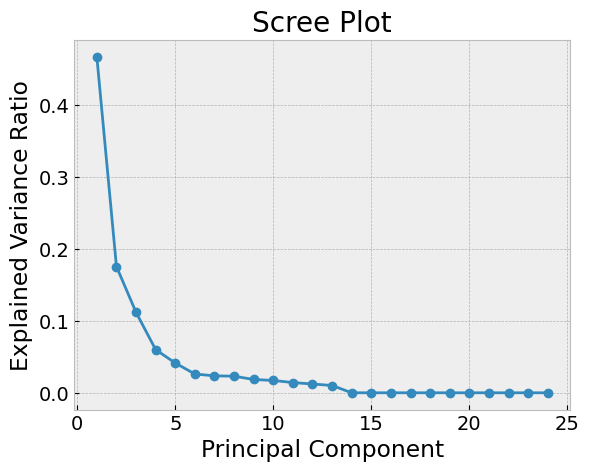

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder, StandardScaler

# Load your rainfall dataframe here
# rainfall = pd.read_csv('rainfall_data.csv')

# Drop the categorical 'SUBDIVISION' column
rainfall_data = rainfall.drop('SUBDIVISION', axis=1)

# Perform Label Encoding on 'SUBDIVISION' column
label_encoder = LabelEncoder()
rainfall['SUBDIVISION_ENCODED'] = label_encoder.fit_transform(rainfall['SUBDIVISION'])

# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(rainfall_data)

# Perform PCA
pca = PCA()
pca.fit(scaled_data)

# Get the explained variance ratio
explained_var_ratio = pca.explained_variance_ratio_

# Create a scree plot to visualize the importance of each component
plt.plot(np.arange(1, len(explained_var_ratio) + 1), explained_var_ratio, marker='o')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Scree Plot')
plt.show()


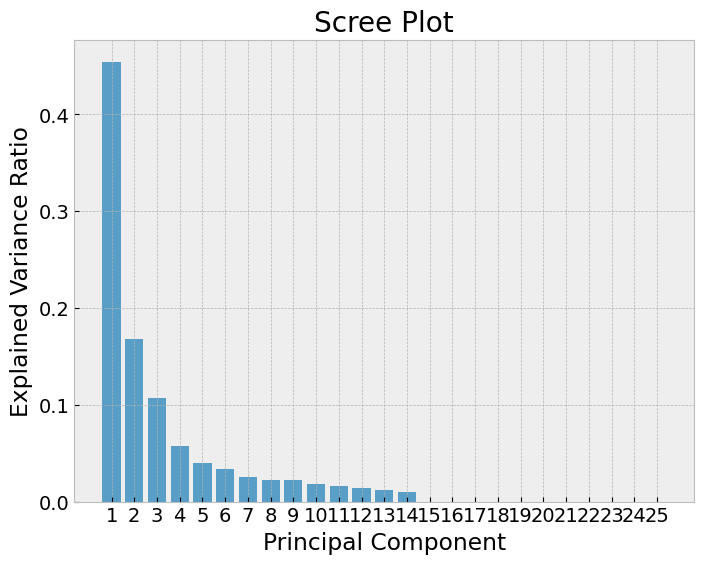

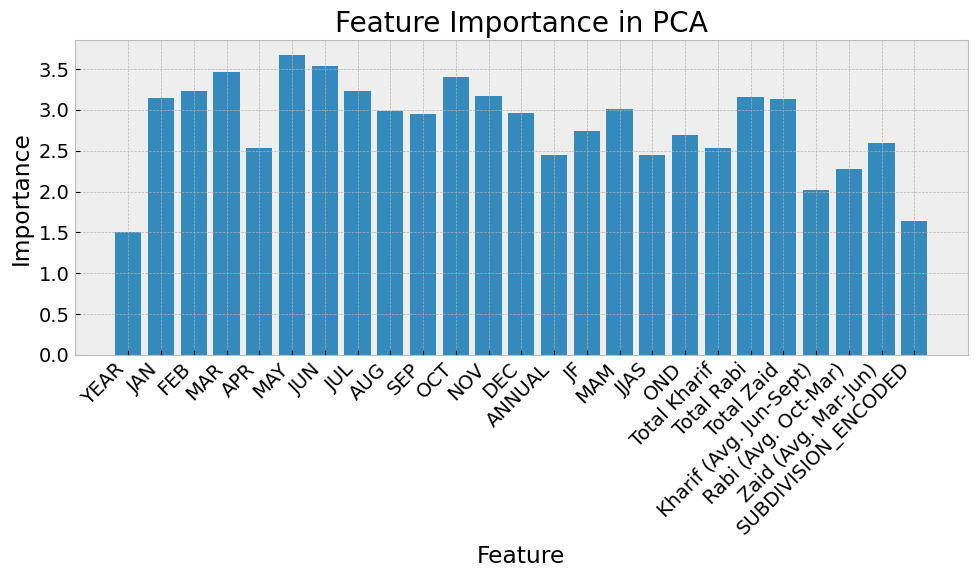

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Load your rainfall dataframe here
# rainfall = pd.read_csv('rainfall_data.csv')

# Drop the 'SUBDIVISION' column as it is categorical
rainfall_data = rainfall.drop(columns=['SUBDIVISION'])

# Standardize the data
scaler = StandardScaler()
standardized_data = scaler.fit_transform(rainfall_data)

# Perform PCA
pca = PCA()
pca.fit(standardized_data)

# Get the explained variance ratio for each principal component
explained_variance_ratio = pca.explained_variance_ratio_

# Plot the scree plot
plt.figure(figsize=(8, 6))
plt.bar(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, alpha=0.8)
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Scree Plot')
plt.xticks(range(1, len(explained_variance_ratio) + 1))
plt.show()

# Plot the bar graph showing the importance of each feature
feature_importance = np.abs(pca.components_)
feature_names = rainfall_data.columns

plt.figure(figsize=(10, 6))
plt.bar(feature_names, feature_importance.sum(axis=0))
plt.xlabel('Feature')
plt.ylabel('Importance')
plt.title('Feature Importance in PCA')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


# Subdivision EDA

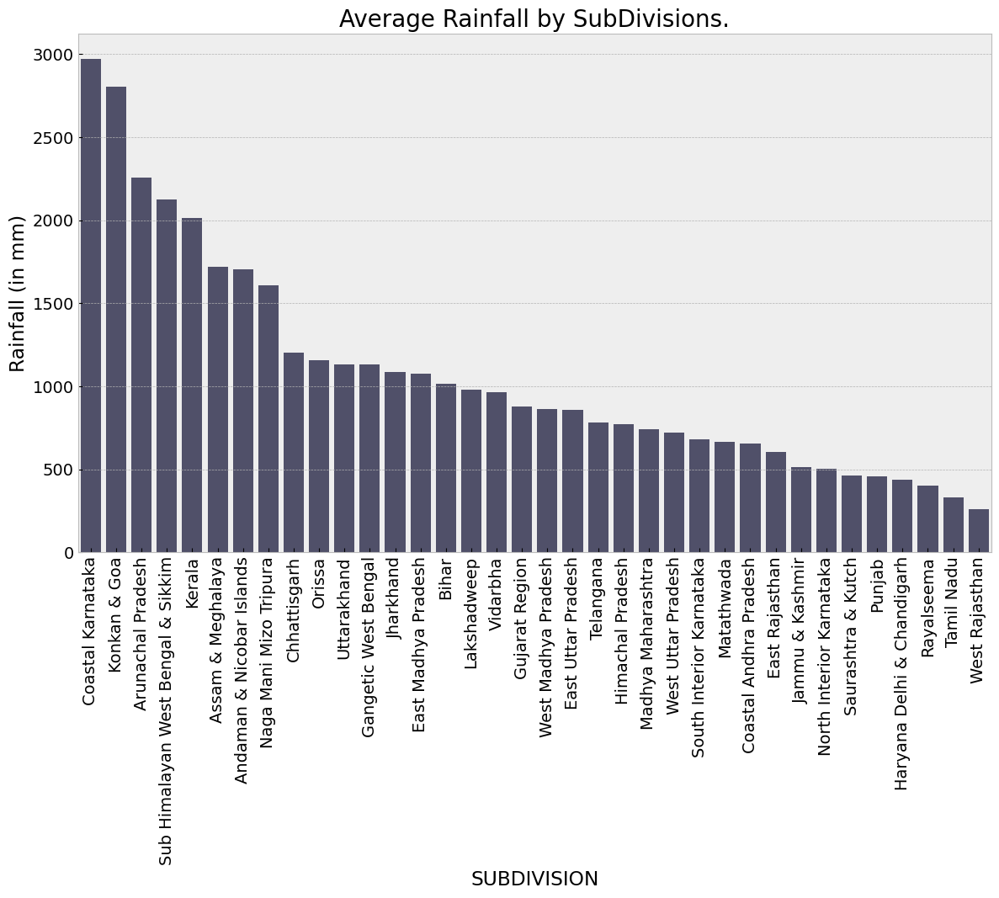

In [ ]:
# Average rainfall by subdivision.
avgSubDiv = rainfall.groupby(by = ['SUBDIVISION']).agg(['mean', 'std'])['JJAS']
avgSubDiv['CV'] = avgSubDiv['std'] / avgSubDiv['mean']
avgSubDiv.sort_values(by=['mean'], ascending=False, inplace=True)

# plot
plt.figure(figsize=(14, 8))
sns.barplot(data=avgSubDiv, x=avgSubDiv.index, y='mean', color='#4C4C6D')

plt.ylabel('Rainfall (in mm)')
plt.title("Average Rainfall by SubDivisions.", fontdict={'size':20})

plt.xticks(rotation=90)
plt.show()

High average rainfall is observed in NorthEast and SouthWest Regions of India.

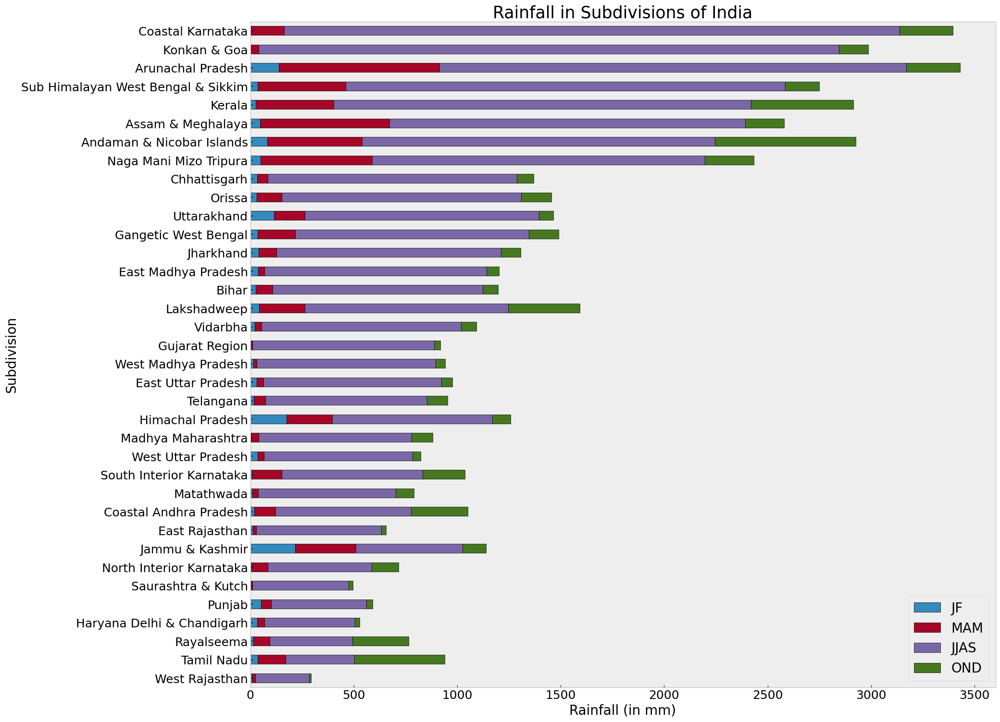

In [ ]:
# Plotting a bar plot of the mean seasonal rainfall
ax = (rainfall[['SUBDIVISION', 'JF', 'MAM', 'JJAS', 'OND']]
      .groupby("SUBDIVISION").mean().sort_values('JJAS')
      .plot.barh(width=0.5,
                 edgecolor='k',
                 align='center',
                 stacked=True, figsize=(20, 18)))

# Aesthetic of the plot
ax.set_xlabel('Rainfall (in mm)', fontsize=20)
ax.set_ylabel('Subdivision', fontsize=20)
ax.set_title('Rainfall in Subdivisions of India', fontsize=25)
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
ax.legend(loc=4, prop={'size': 20})
ax.grid(False)
plt.ioff()
plt.show()

Insights:
- From the above graph we can see that majority of rainfall is received in the month of Jun-Sep which is the Monsoon season. Oct-Dec is time of return monsoon. Jan-Feb are the winter months during which least rainfall is observed in most regions, Mar-May is time for Summer rains in India.

- Coastal Karnataka, Arunachal Pradesh,Konkan Goa and Kerala receive highest rainfall.

- Rajastan, Gujrat, Haryana and Punjab receives low rainfall

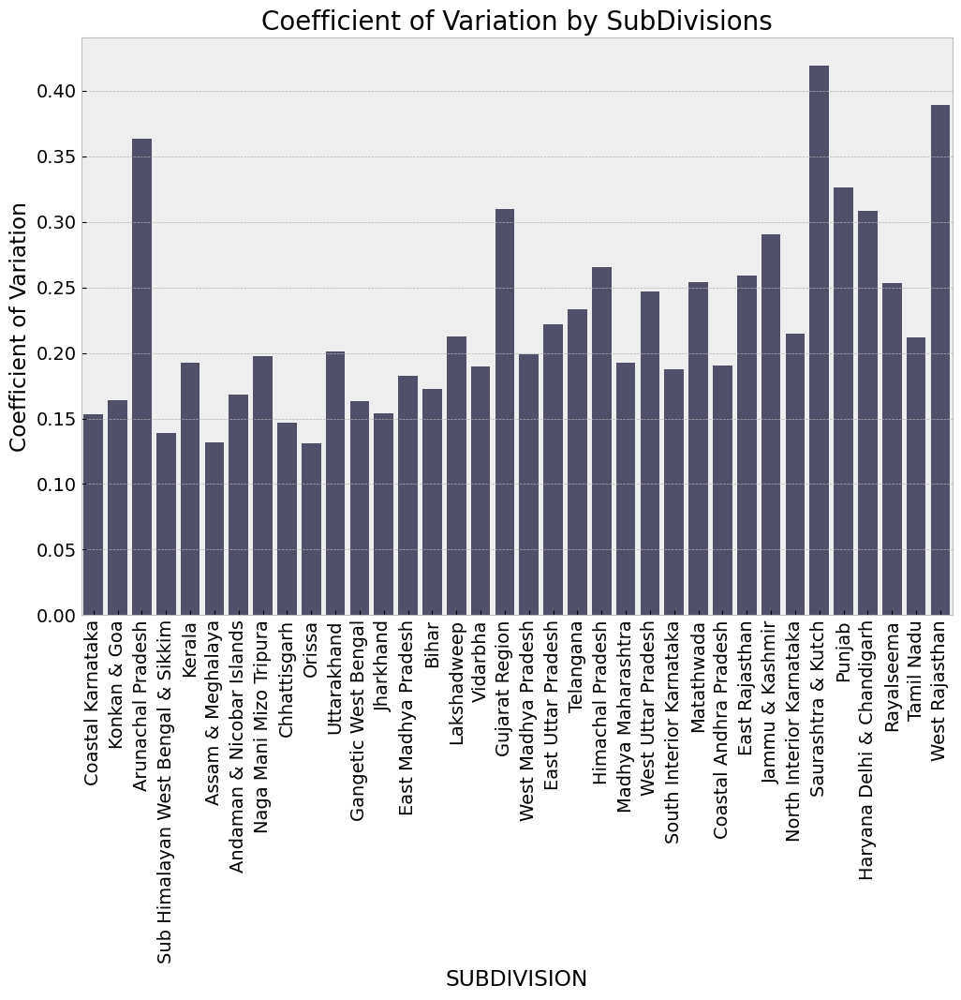

In [ ]:
# Coefficient of Variation in rainfall by subdivision.

# Visualization.
plt.figure(figsize=(12, 8))
sns.barplot(data=avgSubDiv, x=avgSubDiv.index, y='CV', color='#4C4C6D')

plt.ylabel('Coefficient of Variation')
plt.title("Coefficient of Variation by SubDivisions",fontdict={'size':20})

plt.xticks(rotation=90)
plt.show()


Higher rainfall subdivisions has lower coeffient of variation, whereas lower average rainfall subdivisions has higher coefficient of variation.

In [ ]:
rainfall.head()

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,...,MAM,JJAS,OND,Total Kharif,Total Rabi,Total Zaid,Kharif (Avg. Jun-Sept),Rabi (Avg. Oct-Mar),Zaid (Avg. Mar-Jun),SUBDIVISION_ENCODED
0,Andaman & Nicobar Islands,1901,49.2,87.1,29.2,2.3,528.8,517.5,365.1,481.1,...,560.3,1696.3,980.3,1696.3,1145.8,1077.8,424.1,191.0,269.4,0
1,Andaman & Nicobar Islands,1902,0.0,159.8,12.2,0.0,446.1,537.1,228.9,753.7,...,458.3,2185.9,716.7,2185.9,888.7,995.4,546.5,148.1,248.9,0
2,Andaman & Nicobar Islands,1903,12.7,144.0,0.0,1.0,235.1,479.9,728.4,326.7,...,236.1,1874.0,690.6,1874.0,847.3,716.0,468.5,141.2,179.0,0
3,Andaman & Nicobar Islands,1904,9.4,14.7,0.0,202.4,304.5,495.1,502.0,160.1,...,506.9,1977.6,571.0,1977.6,595.1,1002.0,494.4,99.2,250.5,0
4,Andaman & Nicobar Islands,1905,1.3,0.0,3.3,26.9,279.5,628.7,368.7,330.5,...,309.7,1624.9,630.8,1624.9,635.4,938.4,406.2,105.9,234.6,0


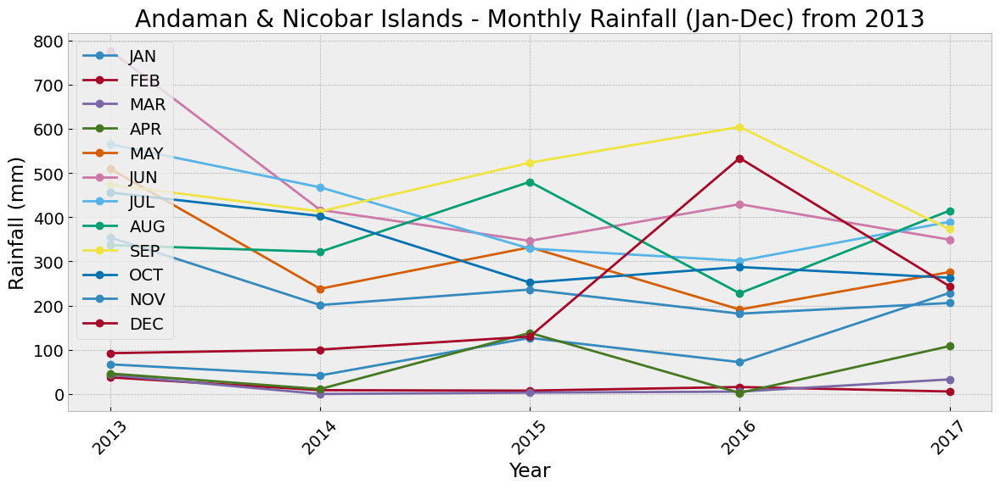

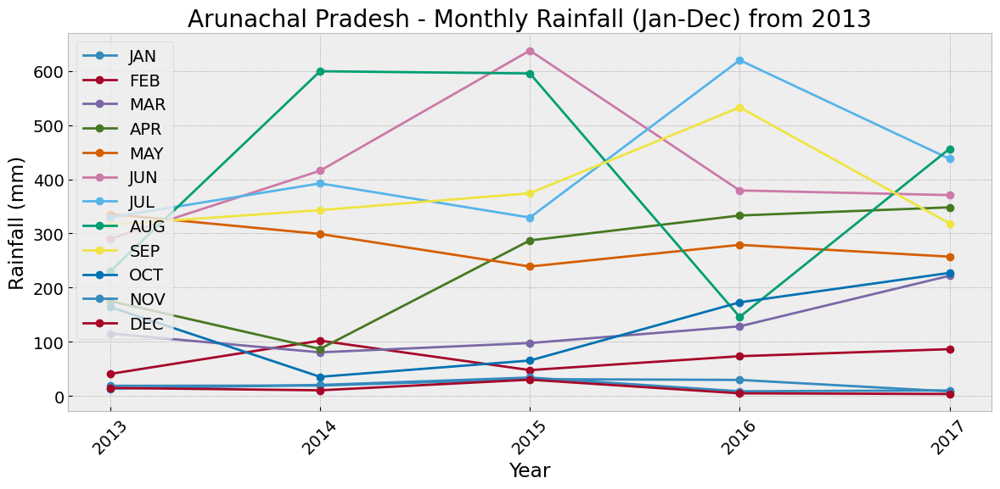

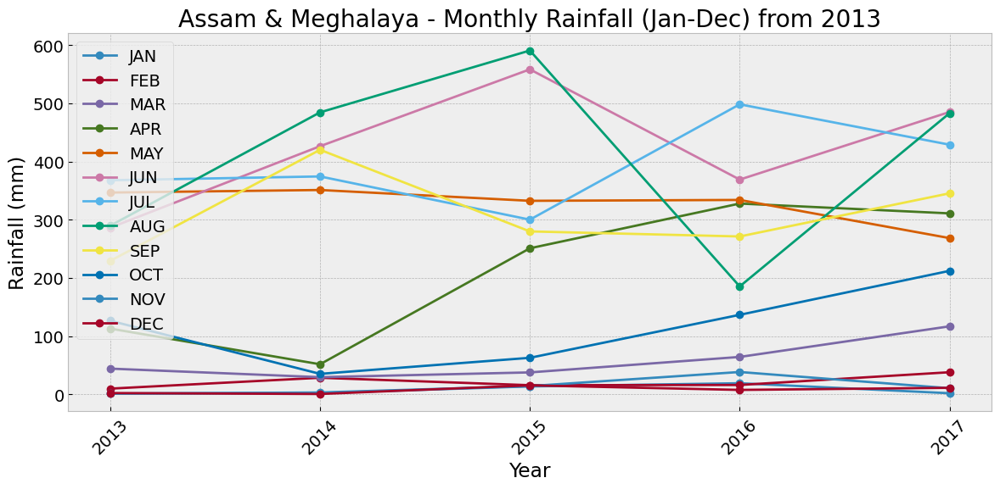

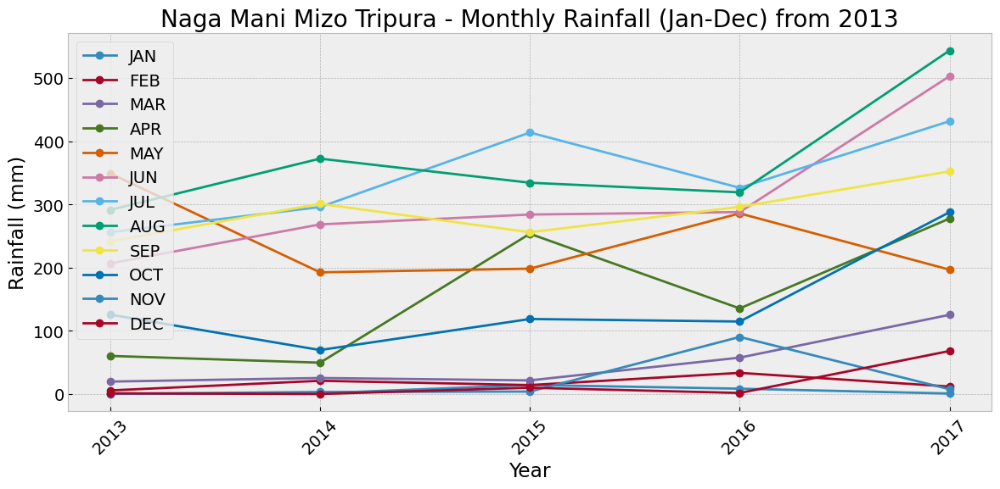

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load your rainfall dataframe here
# rainfall = pd.read_csv('rainfall_data.csv')

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data from 2013 onwards
rainfall = rainfall[rainfall['YEAR'] >= 2013]

# Loop over the first 4 unique subdivisions
for subdivision in subdivisions:
    # Filter data for the current subdivision
    subdivision_rainfall = rainfall[rainfall['SUBDIVISION'] == subdivision]

    # Group the data by 'YEAR' and calculate the mean monthly rainfall for each year
    yearly_rainfall = subdivision_rainfall.groupby('YEAR')[['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']].mean()

    # Create a line plot to visualize the monthly rainfall for each year
    fig, ax = plt.subplots(figsize=(12, 6))
    yearly_rainfall.plot(ax=ax, marker='o')
    ax.set_xlabel('Year')
    ax.set_ylabel('Rainfall (mm)')
    ax.set_title(f'{subdivision} - Monthly Rainfall (Jan-Dec) from 2013')
    plt.xticks(yearly_rainfall.index, rotation=45)
    plt.legend(loc='upper left')
    plt.tight_layout()
    plt.show()


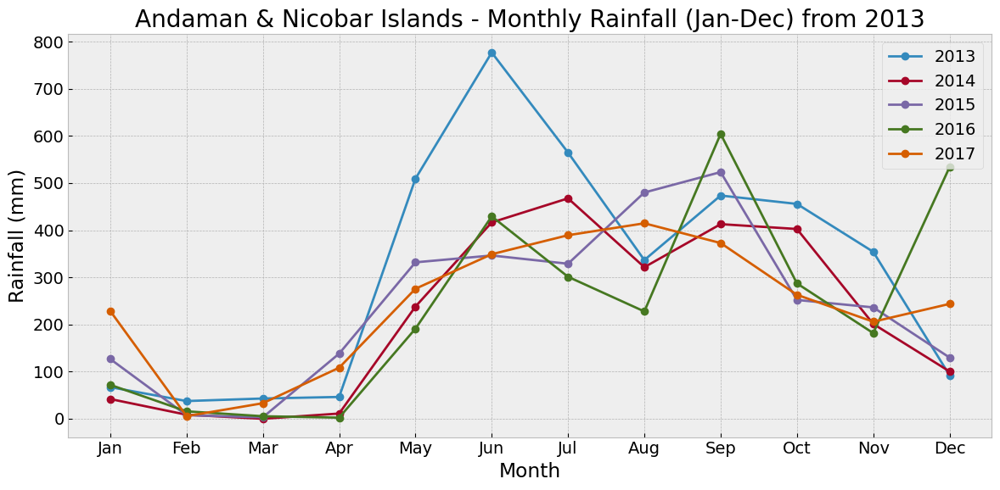

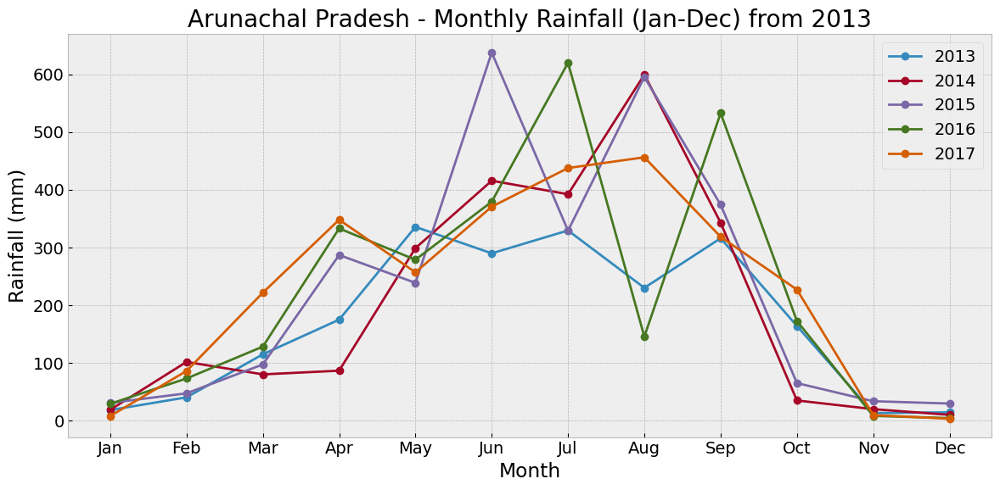

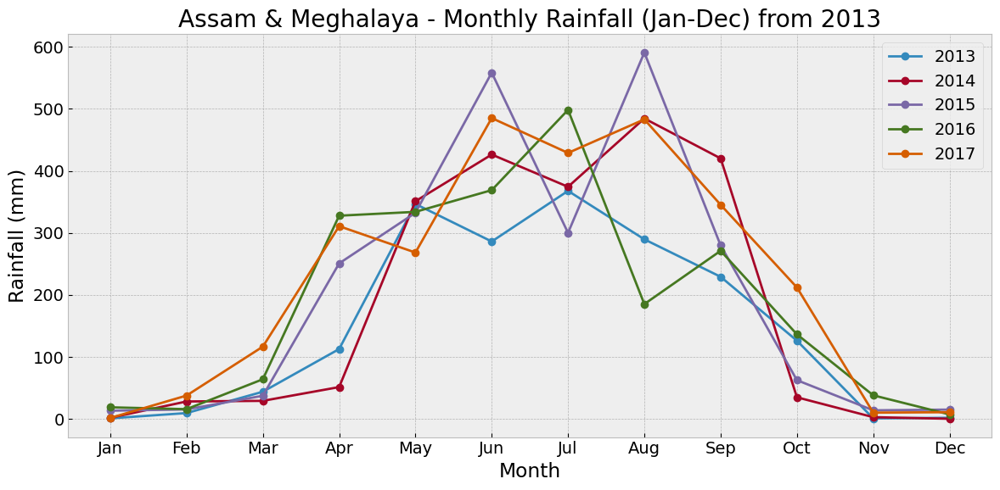

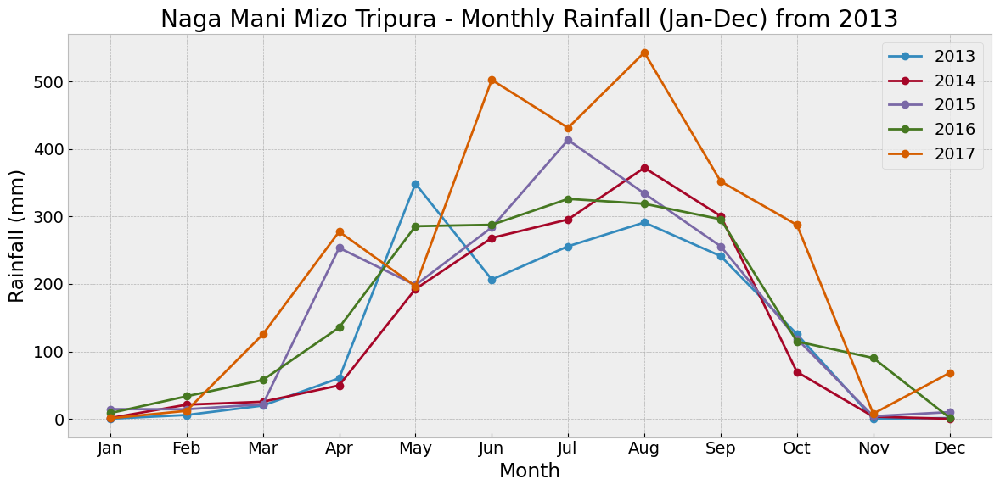

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load your rainfall dataframe here
# rainfall = pd.read_csv('rainfall_data.csv')

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data from 2013 onwards
rainfall = rainfall[rainfall['YEAR'] >= 2013]

# Melt the dataframe to reshape it for plotting
melted_rainfall = pd.melt(rainfall, id_vars=['SUBDIVISION', 'YEAR'], value_vars=['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC'], var_name='MONTH', value_name='Rainfall (mm)')

# Loop over the first 4 unique subdivisions
for subdivision in subdivisions:
    # Filter data for the current subdivision
    subdivision_rainfall = melted_rainfall[melted_rainfall['SUBDIVISION'] == subdivision]

    # Create a line plot to visualize the monthly rainfall for each year
    fig, ax = plt.subplots(figsize=(12, 6))
    for year, data in subdivision_rainfall.groupby('YEAR'):
        data.plot(x='MONTH', y='Rainfall (mm)', label=str(year), ax=ax, marker='o')
    ax.set_xlabel('Month')
    ax.set_ylabel('Rainfall (mm)')
    ax.set_title(f'{subdivision} - Monthly Rainfall (Jan-Dec) from 2013')
    plt.xticks(range(12), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
    plt.legend(loc='upper right')
    plt.tight_layout()
    plt.show()


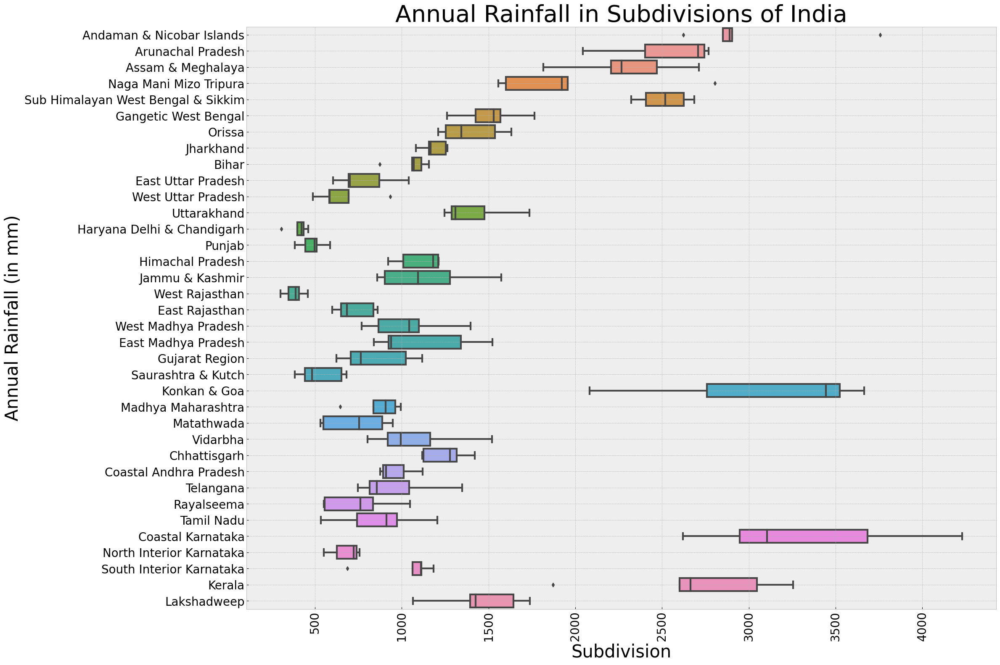

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.rcParams['figure.figsize'] = (23, 18)

# Creating boxplot as per subdivisions
ax = sns.boxplot(y="SUBDIVISION", x="ANNUAL", data=rainfall, width=0.8, linewidth=3)

# Aesthetics of the plot
ax.set_xlabel('Subdivision', fontsize=30)
ax.set_ylabel('Annual Rainfall (in mm)', fontsize=30)
ax.set_title('Annual Rainfall in Subdivisions of India', fontsize=40)
ax.tick_params(axis='x', labelsize=20, rotation=90)
ax.tick_params(axis='y', labelsize=20, rotation=0)
ax.grid(True)
plt.ioff()
plt.show()


Insights:
- We can see Subdivision Arunachal Pradesh shows highest highest difference between Maximum and Minimum rainfall received.
- Costal Karnataka receives close to 3400 mm of Annual rainfall which is the highest in India. West Rajastan receives the least amount of rainfall.

## Maharashtra rainfall southwest monsoon analysis.

In [ ]:
# select Maharashtra's subdivision
sub_div = rainfall.set_index('SUBDIVISION')

# select last 30 years
sub_div = sub_div.loc[sub_div.YEAR > 1987]

MahaData = sub_div.loc['Konkan & Goa':'Vidarbha']
MahaData.reset_index(inplace=True)
MahaData.head()

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,...,MAM,JJAS,OND,Total Kharif,Total Rabi,Total Zaid,Kharif (Avg. Jun-Sept),Rabi (Avg. Oct-Mar),Zaid (Avg. Mar-Jun),SUBDIVISION_ENCODED
0,Konkan & Goa,2013,1.8,5.4,0.1,0.1,18.5,1028.3,1478.5,497.6,...,18.7,3345.2,152.8,3345.1,160.2,1047.0,836.3,26.7,261.8,17
1,Konkan & Goa,2014,1.3,5.3,1.8,0.7,21.3,238.2,1293.2,658.0,...,23.8,2608.8,118.4,2608.9,126.8,262.0,652.2,21.1,65.5,17
2,Konkan & Goa,2015,2.7,0.0,36.8,3.6,11.3,764.0,526.5,377.3,...,51.7,1908.7,118.8,1908.7,158.2,815.7,477.2,26.4,203.9,17
3,Konkan & Goa,2016,0.0,0.1,2.0,0.3,2.1,806.5,1327.3,817.0,...,4.4,3551.0,108.5,3551.0,110.5,810.9,887.8,18.4,202.7,17
4,Konkan & Goa,2017,0.0,0.0,0.0,0.0,47.0,840.4,1095.3,731.2,...,47.0,3213.8,182.6,3213.8,182.6,887.4,803.4,30.4,221.8,17


## Subdivision Andaman

In [ ]:
rainfall['SUBDIVISION'].unique()

array(['Andaman & Nicobar Islands', 'Arunachal Pradesh',
       'Assam & Meghalaya', 'Naga Mani Mizo Tripura',
       'Sub Himalayan West Bengal & Sikkim', 'Gangetic West Bengal',
       'Orissa', 'Jharkhand', 'Bihar', 'East Uttar Pradesh',
       'West Uttar Pradesh', 'Uttarakhand', 'Haryana Delhi & Chandigarh',
       'Punjab', 'Himachal Pradesh', 'Jammu & Kashmir', 'West Rajasthan',
       'East Rajasthan', 'West Madhya Pradesh', 'East Madhya Pradesh',
       'Gujarat Region', 'Saurashtra & Kutch', 'Konkan & Goa',
       'Madhya Maharashtra', 'Matathwada', 'Vidarbha', 'Chhattisgarh',
       'Coastal Andhra Pradesh', 'Telangana', 'Rayalseema', 'Tamil Nadu',
       'Coastal Karnataka', 'North Interior Karnataka',
       'South Interior Karnataka', 'Kerala', 'Lakshadweep'], dtype=object)

In [ ]:
andaman_rainfall = rainfall.loc[rainfall['SUBDIVISION'] == 'Andaman & Nicobar Islands']
andaman_rainfall['SUBDIVISION'].unique()

array(['Andaman & Nicobar Islands'], dtype=object)

In [ ]:
andaman_rainfall.columns

Index(['SUBDIVISION', 'YEAR', 'JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL',
       'AUG', 'SEP', 'OCT', 'NOV', 'DEC', 'ANNUAL', 'JF', 'MAM', 'JJAS', 'OND',
       'Total Kharif', 'Total Rabi', 'Total Zaid', 'Kharif (Avg. Jun-Sept)',
       'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)', 'SUBDIVISION_ENCODED'],
      dtype='object')

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
from dateutil.parser import parse

In [ ]:
andaman_rainfall.reset_index(inplace=True)

## MA Plot


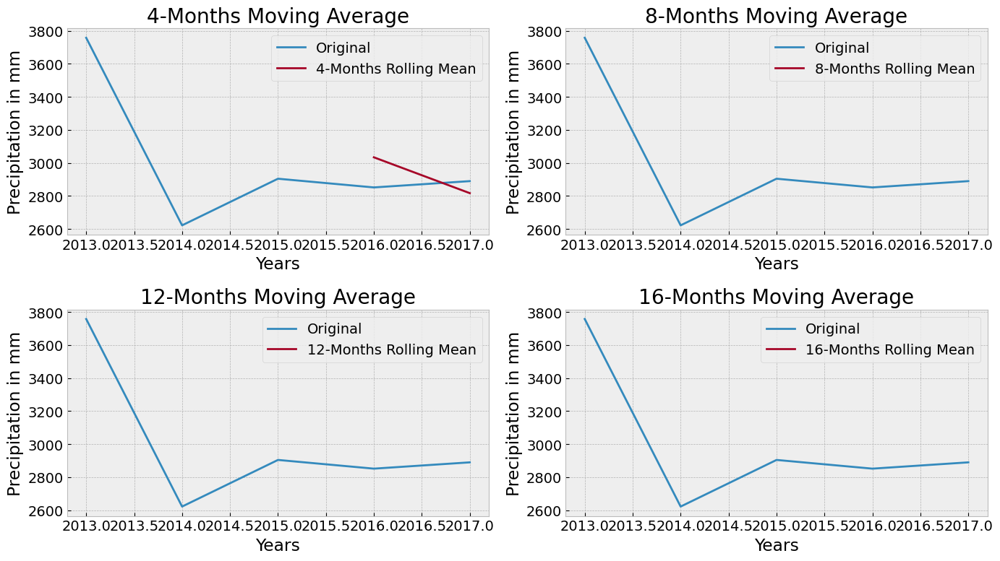

In [ ]:
fig, axes = plt.subplots(2, 2, sharey=False, sharex=False)
fig.set_figwidth(14)
fig.set_figheight(8)

axes[0][0].plot(andaman_rainfall["YEAR"], andaman_rainfall["ANNUAL"], label='Original')
axes[0][0].plot(andaman_rainfall["YEAR"], andaman_rainfall["ANNUAL"].rolling(window=4).mean(), label='4-Months Rolling Mean')
axes[0][0].set_xlabel("Years")
axes[0][0].set_ylabel("Precipitation in mm")
axes[0][0].set_title("4-Months Moving Average")
axes[0][0].legend(loc='best')

axes[0][1].plot(andaman_rainfall["YEAR"], andaman_rainfall["ANNUAL"], label='Original')
axes[0][1].plot(andaman_rainfall["YEAR"], andaman_rainfall["ANNUAL"].rolling(window=8).mean(), label='8-Months Rolling Mean')
axes[0][1].set_xlabel("Years")
axes[0][1].set_ylabel("Precipitation in mm")
axes[0][1].set_title("8-Months Moving Average")
axes[0][1].legend(loc='best')

axes[1][0].plot(andaman_rainfall["YEAR"], andaman_rainfall["ANNUAL"], label='Original')
axes[1][0].plot(andaman_rainfall["YEAR"], andaman_rainfall["ANNUAL"].rolling(window=12).mean(), label='12-Months Rolling Mean')
axes[1][0].set_xlabel("Years")
axes[1][0].set_ylabel("Precipitation in mm")
axes[1][0].set_title("12-Months Moving Average")
axes[1][0].legend(loc='best')

axes[1][1].plot(andaman_rainfall["YEAR"], andaman_rainfall["ANNUAL"], label='Original')
axes[1][1].plot(andaman_rainfall["YEAR"], andaman_rainfall["ANNUAL"].rolling(window=16).mean(), label='16-Months Rolling Mean')
axes[1][1].set_xlabel("Years")
axes[1][1].set_ylabel("Precipitation in mm")
axes[1][1].set_title("16-Months Moving Average")
axes[1][1].legend(loc='best')

plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt
plt.rcParams.update({'figure.figsize': (10,6)})
plt.plot(andaman_rainfall['ANNUAL'])

## ACF and PACF on Annual data


In [ ]:
# Ignore value warnings
warnings.filterwarnings("ignore")

In [ ]:
annual_rainfall.reset_index(inplace=True)

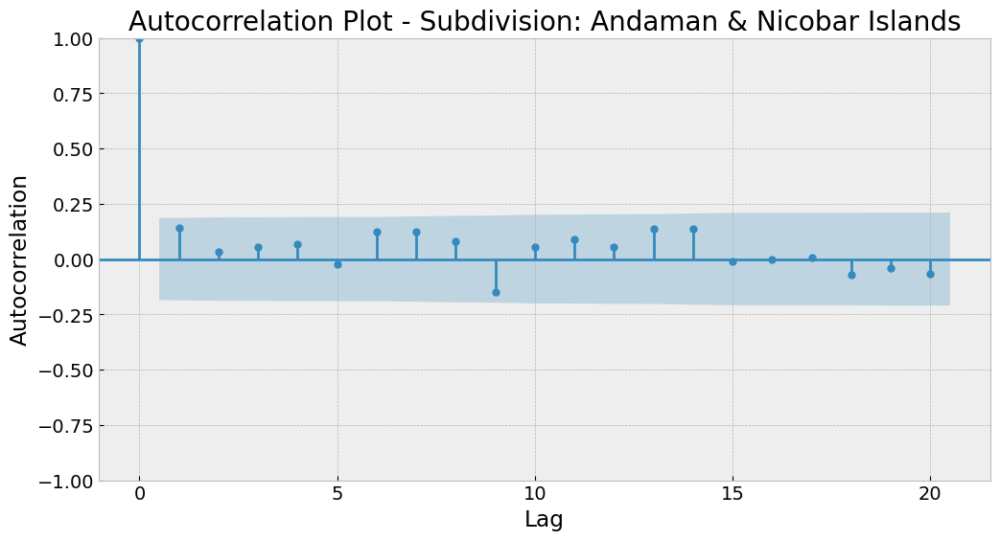

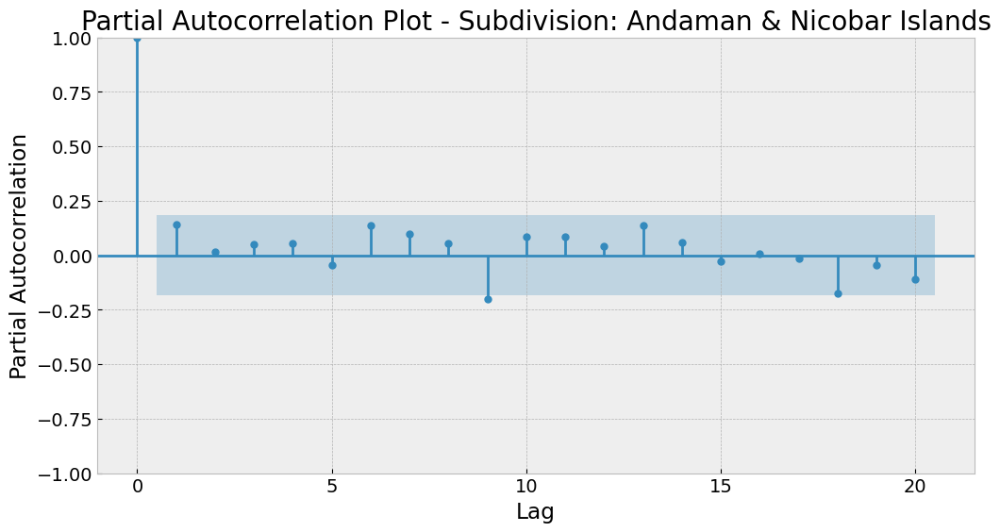

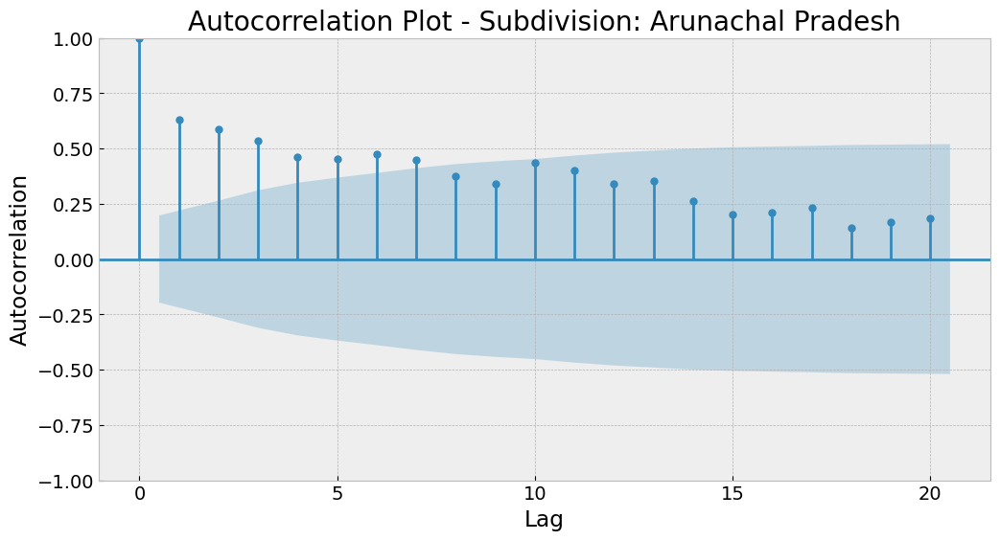

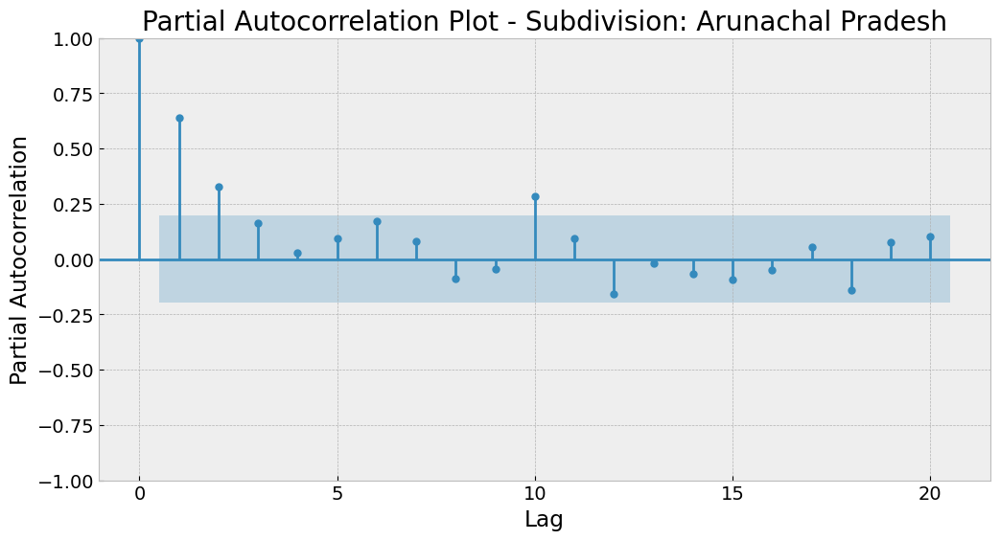

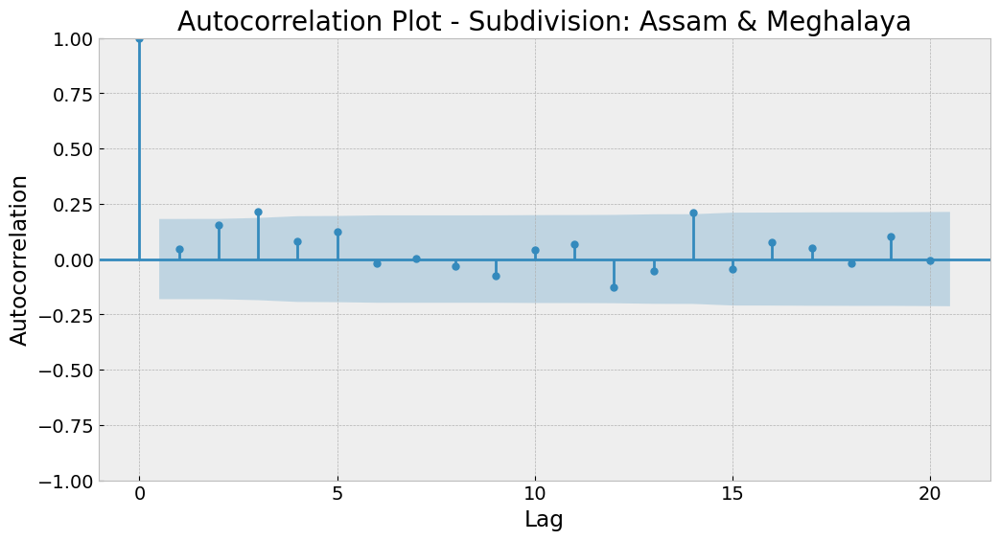

...

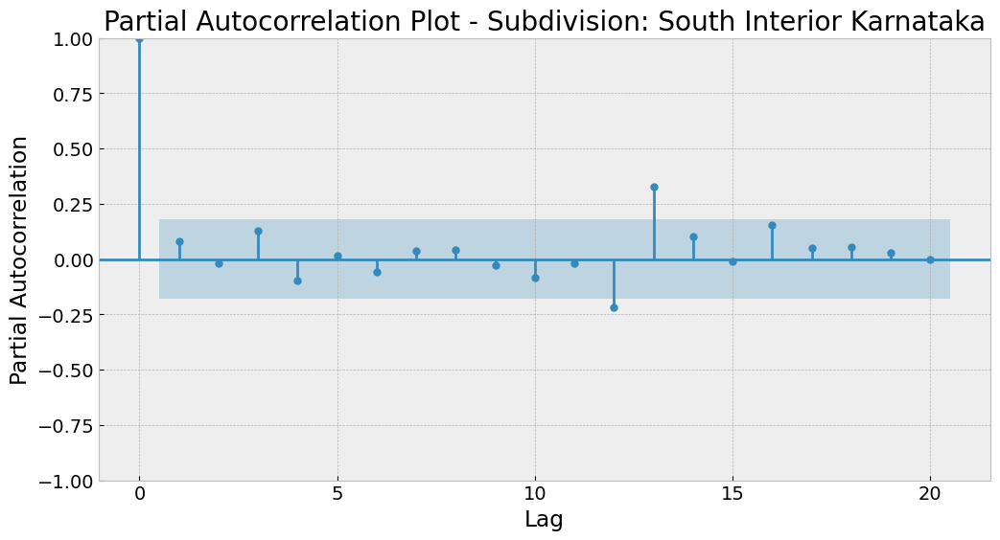

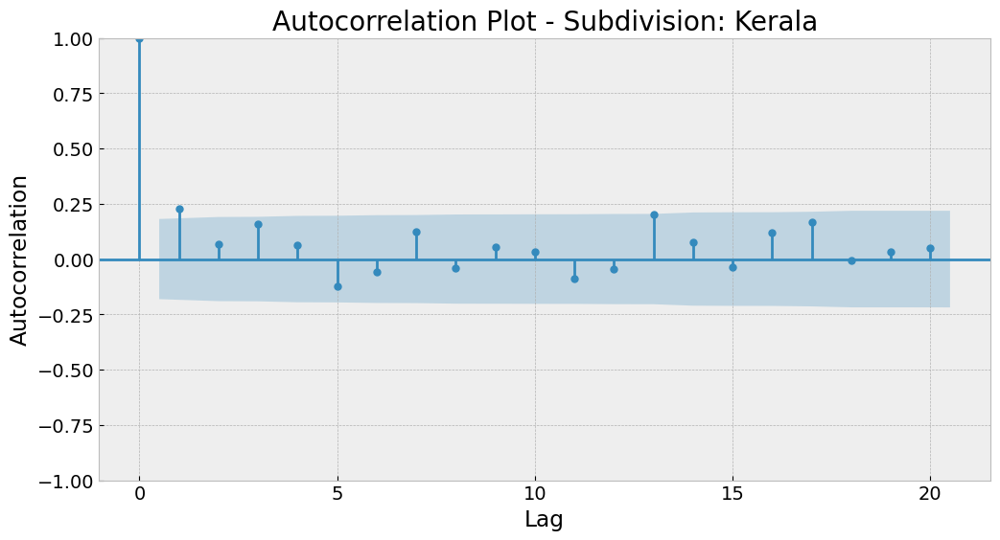

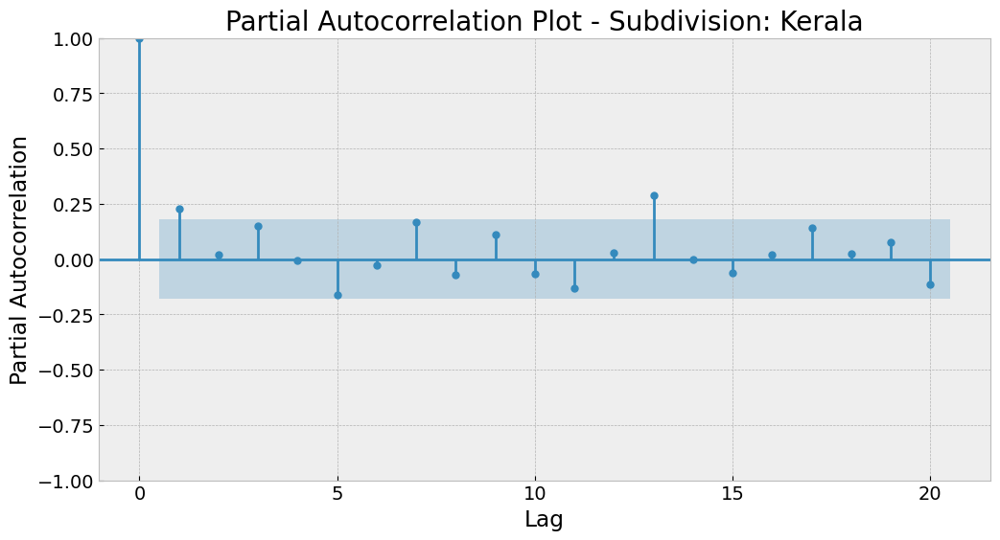

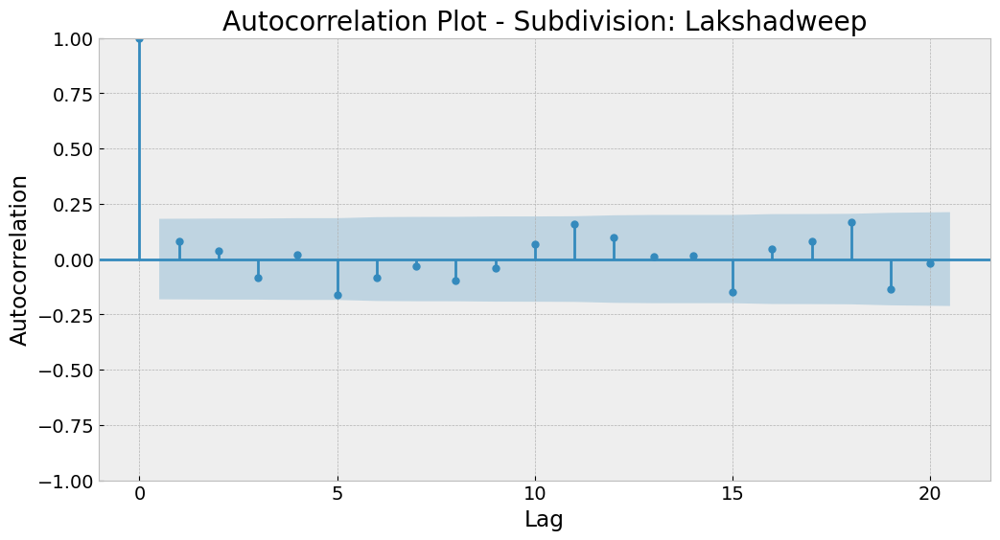

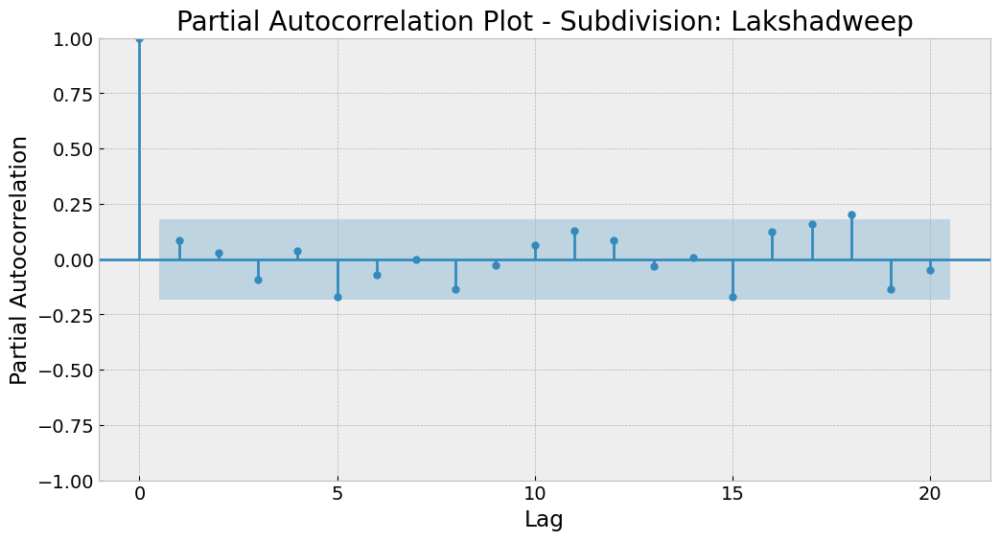

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Assuming your dataframe is named 'df'

# Get unique subdivisions from the dataframe
subdivisions = annual_rainfall['SUBDIVISION'].unique()

# Iterate over each subdivision
for subdivision in subdivisions:
    # Select data for the current subdivision
    subdivision_data = annual_rainfall[annual_rainfall['SUBDIVISION'] == subdivision]

    # Convert 'YEAR' column to datetime format
    subdivision_data['YEAR'] = pd.to_datetime(subdivision_data['YEAR'], format='%Y')

    # Set 'YEAR' column as the index
    subdivision_data.set_index('YEAR', inplace=True)

    # Sort the dataframe by the index in ascending order
    subdivision_data.sort_index(ascending=True, inplace=True)

    # Split the data into training and testing sets
    train_data = subdivision_data.iloc[:-5]
    test_data = subdivision_data.iloc[-5:]

    # Build and fit the ARIMA model
    model = sm.tsa.ARIMA(train_data['ANNUAL'], order=(1, 1, 1))
    model_fit = model.fit()

    # Generate autocorrelation and partial autocorrelation plots
    fig, ax = plt.subplots(figsize=(12, 6))
    plot_acf(subdivision_data['ANNUAL'], ax=ax, lags=20)
    plt.xlabel('Lag')
    plt.ylabel('Autocorrelation')
    plt.title('Autocorrelation Plot - Subdivision: ' + subdivision)
    plt.show()

    fig, ax = plt.subplots(figsize=(12, 6))
    plot_pacf(subdivision_data['ANNUAL'], ax=ax, lags=20)
    plt.xlabel('Lag')
    plt.ylabel('Partial Autocorrelation')
    plt.title('Partial Autocorrelation Plot - Subdivision: ' + subdivision)
    plt.show()


# Multiplicative and Additive Decomposition

In [ ]:
# Multiplicative Decomposition
mul_result = seasonal_decompose(andaman_rainfall['ANNUAL'], model='multiplicative',period=1)

# Additive Decomposition
add_result = seasonal_decompose(andaman_rainfall['ANNUAL'], model='additive',period=1)

In [ ]:
# Plot
plt.rcParams.update({'figure.figsize': (10,10)})
mul_result.plot().suptitle('\nMultiplicative Decompose', fontsize=12)

Text(0.5, 0.98, '\nMultiplicative Decompose')

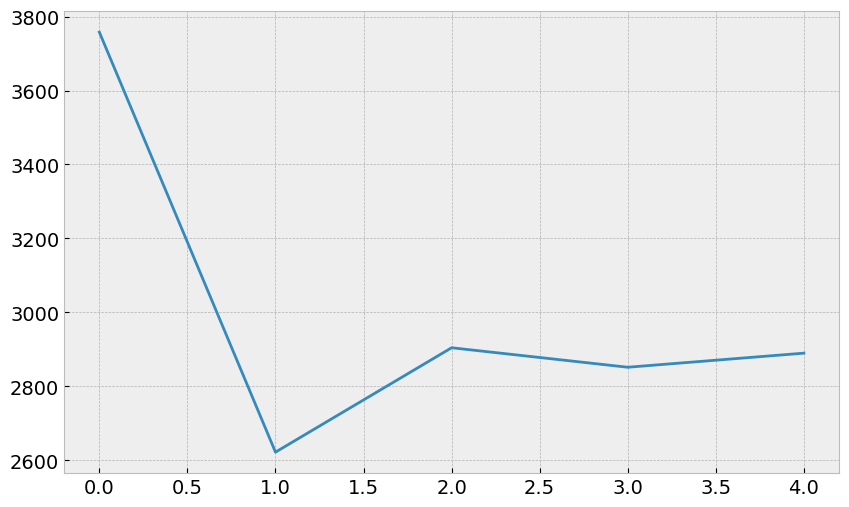

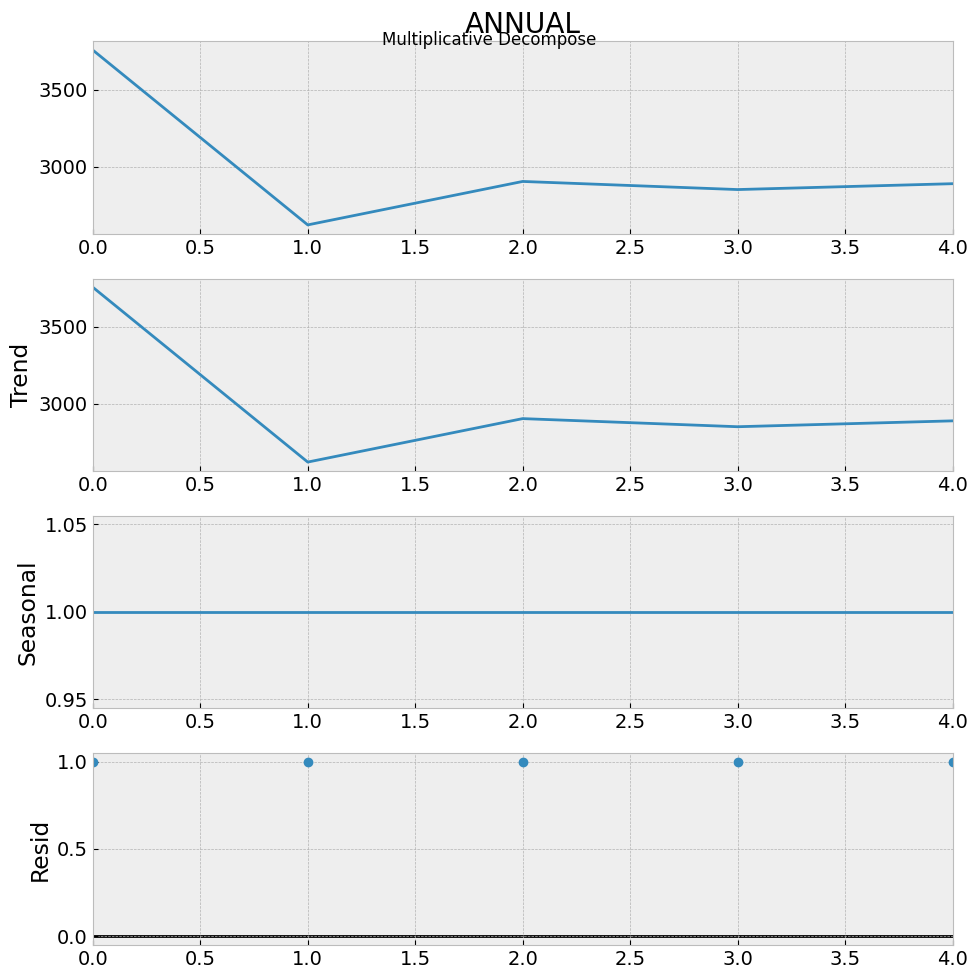

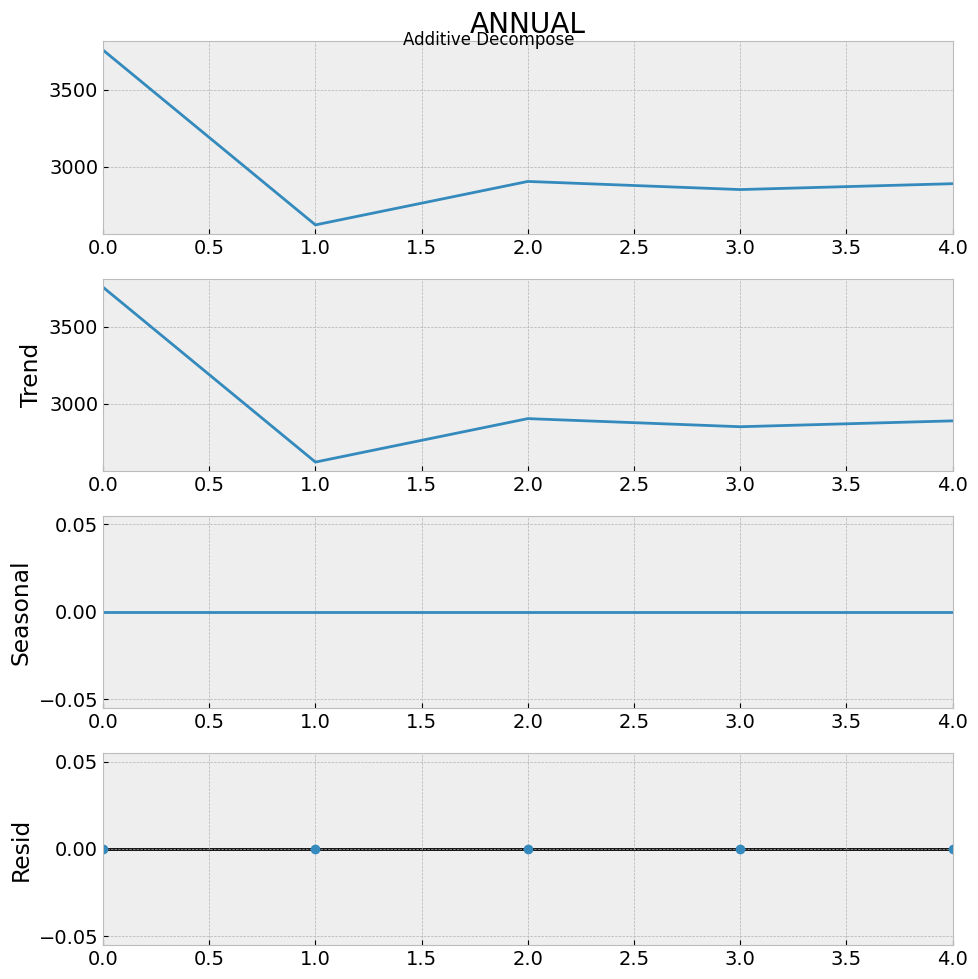

In [ ]:
add_result.plot().suptitle('\nAdditive Decompose', fontsize=12)
plt.show()

In [ ]:
#Additive
andaman_monsoon_add = pd.concat([add_result.seasonal, add_result.trend, add_result.resid, add_result.observed], axis=1)
andaman_monsoon_add.columns = ['seasoanilty', 'trend', 'residual', 'actual_values']
andaman_monsoon_add.head(5)

,seasoanilty,trend,residual,actual_values
0,0.0,3757.8,0.0,3757.8
1,0.0,2622.4,0.0,2622.4
2,0.0,2904.6,0.0,2904.6
3,0.0,2851.9,0.0,2851.9
4,0.0,2890.0,0.0,2890.0


In [ ]:
#Multiplicative
andaman_monsoon_mult = pd.concat([mul_result.seasonal, mul_result.trend, mul_result.resid, mul_result.observed], axis=1)
andaman_monsoon_mult.columns = ['seasoanilty', 'trend', 'residual', 'actual_values']
andaman_monsoon_mult.head(5)

,seasoanilty,trend,residual,actual_values
0,1.0,3757.8,1.0,3757.8
1,1.0,2622.4,1.0,2622.4
2,1.0,2904.6,1.0,2904.6
3,1.0,2851.9,1.0,2851.9
4,1.0,2890.0,1.0,2890.0


For a time series data, the interpretation of seasonal and residual components depends on the specific values they take in the additive or multiplicative decomposition.

1. Additive Decomposition:
- When the seasonal component equals 0: This suggests that there is no recurring pattern or seasonality present in the data. The values in the time series do not exhibit any predictable cyclic behavior over a specific time frame.
- When the residual component equals 0: It indicates that all the variability or fluctuations in the data can be explained by the trend and seasonal patterns. There is no random noise or unexplained variation remaining.

2. Multiplicative Decomposition:
- When the seasonal component equals 1: This implies that the seasonal patterns have a multiplicative effect on the overall trend. The magnitude of the seasonal fluctuations is proportional to the trend component. The data exhibit consistent relative changes due to seasonality.
- When the residual component equals 1: It means that the trend and seasonal patterns fully account for all the variability in the data. There is no additional random variation or unexplained noise beyond the trend and seasonal components.


In short,
In additive decomposition:
- When the seasonal component equals 0, there is no repeating pattern in the time series.
- When the residual component equals 0, all variations in the data are explained by the trend and seasonal patterns.

In multiplicative decomposition:
- When the seasonal component equals 1, the seasonal patterns scale proportionally with the trend.
- When the residual component equals 1, all variations in the data are accounted for by the trend and seasonal patterns without any additional random fluctuations.

# Adfuller test for Stationary (Constant mean and variance)

In [ ]:
# ADF Test - nul hypothesis - non-stationary - if p-value < 5% reject null hypothesis
adfuller_result = adfuller(annual_rainfall['ANNUAL'].values, autolag='AIC')

print(f'ADF Statistic: {adfuller_result[0]}')

print(f'p-value: {adfuller_result[1]}')

for key, value in adfuller_result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')

ADF Statistic: -4.058577572182672
p-value: 0.0011330069709649302
Critial Values:
   1%, -3.4319225399457394
Critial Values:
   5%, -2.8622348617775657
Critial Values:
   10%, -2.567139881056983


Here, the P value is less than 5% (0.05). Hence, we reject the null hypothesis (which assumed that the data is non-stationary)

# Implementing previous work

<ipython-input-65-1db26c6edbd3>:15: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  X = rainfall.drop('ANNUAL', 1)
<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Andaman & Nicobar Islands
Algorithm: Multiple Linear Regression
RMSE: 0.08
R2 Score: 1.00

Subdivision: Andaman & Nicobar Islands
Algorithm: Random Forest Regression
RMSE: 170.44
R2 Score: 0.81

Subdivision: Andaman & Nicobar Islands
Algorithm: K Neighbors Regression
RMSE: 197.16
R2 Score: 0.74

Subdivision: Andaman & Nicobar Islands
Algorithm: Support Vector Regression
RMSE: 384.75
R2 Score: 0.01

Subdivision: Andaman & Nicobar Islands
Algorithm: Decision Tree Regression
RMSE: 249.80
R2 Score: 0.58

Subdivision: Arunachal Pradesh
Algorithm: Multiple Linear Regression
RMSE: 0.06
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Arunachal Pradesh
Algorithm: Random Forest Regression
RMSE: 189.51
R2 Score: 0.82

Subdivision: Arunachal Pradesh
Algorithm: K Neighbors Regression
RMSE: 124.99
R2 Score: 0.92

Subdivision: Arunachal Pradesh
Algorithm: Support Vector Regression
RMSE: 1191.06
R2 Score: -6.13

Subdivision: Arunachal Pradesh
Algorithm: Decision Tree Regression
RMSE: 267.87
R2 Score: 0.64

Subdivision: Assam & Meghalaya
Algorithm: Multiple Linear Regression
RMSE: 0.08
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Assam & Meghalaya
Algorithm: Random Forest Regression
RMSE: 148.47
R2 Score: 0.79

Subdivision: Assam & Meghalaya
Algorithm: K Neighbors Regression
RMSE: 120.14
R2 Score: 0.86

Subdivision: Assam & Meghalaya
Algorithm: Support Vector Regression
RMSE: 385.79
R2 Score: -0.43

Subdivision: Assam & Meghalaya
Algorithm: Decision Tree Regression
RMSE: 149.27
R2 Score: 0.79

Subdivision: Naga Mani Mizo Tripura
Algorithm: Multiple Linear Regression
RMSE: 0.06
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Naga Mani Mizo Tripura
Algorithm: Random Forest Regression
RMSE: 118.46
R2 Score: 0.85

Subdivision: Naga Mani Mizo Tripura
Algorithm: K Neighbors Regression
RMSE: 91.28
R2 Score: 0.91

Subdivision: Naga Mani Mizo Tripura
Algorithm: Support Vector Regression
RMSE: 495.33
R2 Score: -1.69

Subdivision: Naga Mani Mizo Tripura
Algorithm: Decision Tree Regression
RMSE: 214.71
R2 Score: 0.49

Subdivision: Sub Himalayan West Bengal & Sikkim
Algorithm: Multiple Linear Regression
RMSE: 0.08
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Sub Himalayan West Bengal & Sikkim
Algorithm: Random Forest Regression
RMSE: 129.18
R2 Score: 0.87

Subdivision: Sub Himalayan West Bengal & Sikkim
Algorithm: K Neighbors Regression
RMSE: 99.03
R2 Score: 0.93

Subdivision: Sub Himalayan West Bengal & Sikkim
Algorithm: Support Vector Regression
RMSE: 366.40
R2 Score: -0.02

Subdivision: Sub Himalayan West Bengal & Sikkim
Algorithm: Decision Tree Regression
RMSE: 177.46
R2 Score: 0.76

Subdivision: Gangetic West Bengal
Algorithm: Multiple Linear Regression
RMSE: 0.06
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Gangetic West Bengal
Algorithm: Random Forest Regression
RMSE: 120.40
R2 Score: 0.66

Subdivision: Gangetic West Bengal
Algorithm: K Neighbors Regression
RMSE: 72.98
R2 Score: 0.88

Subdivision: Gangetic West Bengal
Algorithm: Support Vector Regression
RMSE: 255.64
R2 Score: -0.51

Subdivision: Gangetic West Bengal
Algorithm: Decision Tree Regression
RMSE: 192.97
R2 Score: 0.14

Subdivision: Orissa
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Orissa
Algorithm: Random Forest Regression
RMSE: 85.81
R2 Score: 0.81

Subdivision: Orissa
Algorithm: K Neighbors Regression
RMSE: 68.86
R2 Score: 0.88

Subdivision: Orissa
Algorithm: Support Vector Regression
RMSE: 196.50
R2 Score: 0.02

Subdivision: Orissa
Algorithm: Decision Tree Regression
RMSE: 114.11
R2 Score: 0.67

Subdivision: Jharkhand
Algorithm: Multiple Linear Regression
RMSE: 0.06
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Jharkhand
Algorithm: Random Forest Regression
RMSE: 82.66
R2 Score: 0.83

Subdivision: Jharkhand
Algorithm: K Neighbors Regression
RMSE: 58.63
R2 Score: 0.92

Subdivision: Jharkhand
Algorithm: Support Vector Regression
RMSE: 218.88
R2 Score: -0.17

Subdivision: Jharkhand
Algorithm: Decision Tree Regression
RMSE: 122.10
R2 Score: 0.64

Subdivision: Bihar
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Bihar
Algorithm: Random Forest Regression
RMSE: 63.98
R2 Score: 0.89

Subdivision: Bihar
Algorithm: K Neighbors Regression
RMSE: 49.95
R2 Score: 0.93

Subdivision: Bihar
Algorithm: Support Vector Regression
RMSE: 220.81
R2 Score: -0.27

Subdivision: Bihar
Algorithm: Decision Tree Regression
RMSE: 72.13
R2 Score: 0.86

Subdivision: East Uttar Pradesh
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: East Uttar Pradesh
Algorithm: Random Forest Regression
RMSE: 68.43
R2 Score: 0.82

Subdivision: East Uttar Pradesh
Algorithm: K Neighbors Regression
RMSE: 62.79
R2 Score: 0.85

Subdivision: East Uttar Pradesh
Algorithm: Support Vector Regression
RMSE: 275.93
R2 Score: -1.97

Subdivision: East Uttar Pradesh
Algorithm: Decision Tree Regression
RMSE: 80.70
R2 Score: 0.75

Subdivision: West Uttar Pradesh
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: West Uttar Pradesh
Algorithm: Random Forest Regression
RMSE: 41.33
R2 Score: 0.94

Subdivision: West Uttar Pradesh
Algorithm: K Neighbors Regression
RMSE: 36.10
R2 Score: 0.95

Subdivision: West Uttar Pradesh
Algorithm: Support Vector Regression
RMSE: 225.46
R2 Score: -0.89

Subdivision: West Uttar Pradesh
Algorithm: Decision Tree Regression
RMSE: 100.85
R2 Score: 0.62

Subdivision: Uttarakhand
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Uttarakhand
Algorithm: Random Forest Regression
RMSE: 91.13
R2 Score: 0.88

Subdivision: Uttarakhand
Algorithm: K Neighbors Regression
RMSE: 83.39
R2 Score: 0.90

Subdivision: Uttarakhand
Algorithm: Support Vector Regression
RMSE: 284.99
R2 Score: -0.19

Subdivision: Uttarakhand
Algorithm: Decision Tree Regression
RMSE: 132.49
R2 Score: 0.74

Subdivision: Haryana Delhi & Chandigarh
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Haryana Delhi & Chandigarh
Algorithm: Random Forest Regression
RMSE: 34.36
R2 Score: 0.94

Subdivision: Haryana Delhi & Chandigarh
Algorithm: K Neighbors Regression
RMSE: 36.35
R2 Score: 0.93

Subdivision: Haryana Delhi & Chandigarh
Algorithm: Support Vector Regression
RMSE: 133.18
R2 Score: 0.02

Subdivision: Haryana Delhi & Chandigarh
Algorithm: Decision Tree Regression
RMSE: 51.78
R2 Score: 0.85

Subdivision: Punjab
Algorithm: Multiple Linear Regression
RMSE: 0.05
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Punjab
Algorithm: Random Forest Regression
RMSE: 42.35
R2 Score: 0.91

Subdivision: Punjab
Algorithm: K Neighbors Regression
RMSE: 39.21
R2 Score: 0.92

Subdivision: Punjab
Algorithm: Support Vector Regression
RMSE: 151.67
R2 Score: -0.20

Subdivision: Punjab
Algorithm: Decision Tree Regression
RMSE: 66.15
R2 Score: 0.77

Subdivision: Himachal Pradesh
Algorithm: Multiple Linear Regression
RMSE: 0.06
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Himachal Pradesh
Algorithm: Random Forest Regression
RMSE: 59.67
R2 Score: 0.88

Subdivision: Himachal Pradesh
Algorithm: K Neighbors Regression
RMSE: 59.35
R2 Score: 0.88

Subdivision: Himachal Pradesh
Algorithm: Support Vector Regression
RMSE: 202.70
R2 Score: -0.35

Subdivision: Himachal Pradesh
Algorithm: Decision Tree Regression
RMSE: 101.81
R2 Score: 0.66

Subdivision: Jammu & Kashmir
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Jammu & Kashmir
Algorithm: Random Forest Regression
RMSE: 94.50
R2 Score: 0.89

Subdivision: Jammu & Kashmir
Algorithm: K Neighbors Regression
RMSE: 109.87
R2 Score: 0.85

Subdivision: Jammu & Kashmir
Algorithm: Support Vector Regression
RMSE: 297.28
R2 Score: -0.09

Subdivision: Jammu & Kashmir
Algorithm: Decision Tree Regression
RMSE: 142.84
R2 Score: 0.75

Subdivision: West Rajasthan
Algorithm: Multiple Linear Regression
RMSE: 0.06
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: West Rajasthan
Algorithm: Random Forest Regression
RMSE: 21.68
R2 Score: 0.94

Subdivision: West Rajasthan
Algorithm: K Neighbors Regression
RMSE: 26.52
R2 Score: 0.92

Subdivision: West Rajasthan
Algorithm: Support Vector Regression
RMSE: 101.99
R2 Score: -0.24

Subdivision: West Rajasthan
Algorithm: Decision Tree Regression
RMSE: 30.46
R2 Score: 0.89

Subdivision: East Rajasthan
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: East Rajasthan
Algorithm: Random Forest Regression
RMSE: 33.23
R2 Score: 0.95

Subdivision: East Rajasthan
Algorithm: K Neighbors Regression
RMSE: 35.27
R2 Score: 0.94

Subdivision: East Rajasthan
Algorithm: Support Vector Regression
RMSE: 146.31
R2 Score: -0.01

Subdivision: East Rajasthan
Algorithm: Decision Tree Regression
RMSE: 41.96
R2 Score: 0.92

Subdivision: West Madhya Pradesh
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: West Madhya Pradesh
Algorithm: Random Forest Regression
RMSE: 51.71
R2 Score: 0.92

Subdivision: West Madhya Pradesh
Algorithm: K Neighbors Regression
RMSE: 45.93
R2 Score: 0.93

Subdivision: West Madhya Pradesh
Algorithm: Support Vector Regression
RMSE: 175.59
R2 Score: 0.02

Subdivision: West Madhya Pradesh
Algorithm: Decision Tree Regression
RMSE: 69.01
R2 Score: 0.85

Subdivision: East Madhya Pradesh
Algorithm: Multiple Linear Regression
RMSE: 0.08
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: East Madhya Pradesh
Algorithm: Random Forest Regression
RMSE: 74.52
R2 Score: 0.90

Subdivision: East Madhya Pradesh
Algorithm: K Neighbors Regression
RMSE: 64.68
R2 Score: 0.93

Subdivision: East Madhya Pradesh
Algorithm: Support Vector Regression
RMSE: 266.08
R2 Score: -0.26

Subdivision: East Madhya Pradesh
Algorithm: Decision Tree Regression
RMSE: 96.13
R2 Score: 0.84

Subdivision: Gujarat Region
Algorithm: Multiple Linear Regression
RMSE: 0.09
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Gujarat Region
Algorithm: Random Forest Regression
RMSE: 44.53
R2 Score: 0.97

Subdivision: Gujarat Region
Algorithm: K Neighbors Regression
RMSE: 48.41
R2 Score: 0.97

Subdivision: Gujarat Region
Algorithm: Support Vector Regression
RMSE: 264.62
R2 Score: 0.05

Subdivision: Gujarat Region
Algorithm: Decision Tree Regression
RMSE: 71.26
R2 Score: 0.93

Subdivision: Saurashtra & Kutch
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Saurashtra & Kutch
Algorithm: Random Forest Regression
RMSE: 74.16
R2 Score: 0.86

Subdivision: Saurashtra & Kutch
Algorithm: K Neighbors Regression
RMSE: 72.13
R2 Score: 0.87

Subdivision: Saurashtra & Kutch
Algorithm: Support Vector Regression
RMSE: 217.82
R2 Score: -0.17

Subdivision: Saurashtra & Kutch
Algorithm: Decision Tree Regression
RMSE: 77.02
R2 Score: 0.85

Subdivision: Konkan & Goa
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Konkan & Goa
Algorithm: Random Forest Regression
RMSE: 91.84
R2 Score: 0.96

Subdivision: Konkan & Goa
Algorithm: K Neighbors Regression
RMSE: 91.08
R2 Score: 0.96

Subdivision: Konkan & Goa
Algorithm: Support Vector Regression
RMSE: 453.06
R2 Score: -0.08

Subdivision: Konkan & Goa
Algorithm: Decision Tree Regression
RMSE: 142.81
R2 Score: 0.89

Subdivision: Madhya Maharashtra
Algorithm: Multiple Linear Regression
RMSE: 0.08
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Madhya Maharashtra
Algorithm: Random Forest Regression
RMSE: 92.05
R2 Score: 0.71

Subdivision: Madhya Maharashtra
Algorithm: K Neighbors Regression
RMSE: 87.36
R2 Score: 0.74

Subdivision: Madhya Maharashtra
Algorithm: Support Vector Regression
RMSE: 172.75
R2 Score: -0.03

Subdivision: Madhya Maharashtra
Algorithm: Decision Tree Regression
RMSE: 98.04
R2 Score: 0.67

Subdivision: Matathwada
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Matathwada
Algorithm: Random Forest Regression
RMSE: 39.15
R2 Score: 0.93

Subdivision: Matathwada
Algorithm: K Neighbors Regression
RMSE: 44.03
R2 Score: 0.91

Subdivision: Matathwada
Algorithm: Support Vector Regression
RMSE: 148.77
R2 Score: 0.01

Subdivision: Matathwada
Algorithm: Decision Tree Regression
RMSE: 82.43
R2 Score: 0.70

Subdivision: Vidarbha
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Vidarbha
Algorithm: Random Forest Regression
RMSE: 52.93
R2 Score: 0.93

Subdivision: Vidarbha
Algorithm: K Neighbors Regression
RMSE: 53.07
R2 Score: 0.93

Subdivision: Vidarbha
Algorithm: Support Vector Regression
RMSE: 194.92
R2 Score: 0.01

Subdivision: Vidarbha
Algorithm: Decision Tree Regression
RMSE: 78.02
R2 Score: 0.84

Subdivision: Chhattisgarh
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Chhattisgarh
Algorithm: Random Forest Regression
RMSE: 51.42
R2 Score: 0.93

Subdivision: Chhattisgarh
Algorithm: K Neighbors Regression
RMSE: 55.49
R2 Score: 0.92

Subdivision: Chhattisgarh
Algorithm: Support Vector Regression
RMSE: 225.14
R2 Score: -0.25

Subdivision: Chhattisgarh
Algorithm: Decision Tree Regression
RMSE: 63.74
R2 Score: 0.90

Subdivision: Coastal Andhra Pradesh
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Coastal Andhra Pradesh
Algorithm: Random Forest Regression
RMSE: 84.31
R2 Score: 0.85

Subdivision: Coastal Andhra Pradesh
Algorithm: K Neighbors Regression
RMSE: 87.66
R2 Score: 0.84

Subdivision: Coastal Andhra Pradesh
Algorithm: Support Vector Regression
RMSE: 219.83
R2 Score: -0.01

Subdivision: Coastal Andhra Pradesh
Algorithm: Decision Tree Regression
RMSE: 128.72
R2 Score: 0.65

Subdivision: Telangana
Algorithm: Multiple Linear Regression
RMSE: 0.06
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Telangana
Algorithm: Random Forest Regression
RMSE: 73.25
R2 Score: 0.84

Subdivision: Telangana
Algorithm: K Neighbors Regression
RMSE: 66.84
R2 Score: 0.87

Subdivision: Telangana
Algorithm: Support Vector Regression
RMSE: 183.26
R2 Score: 0.02

Subdivision: Telangana
Algorithm: Decision Tree Regression
RMSE: 86.60
R2 Score: 0.78

Subdivision: Rayalseema
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Rayalseema
Algorithm: Random Forest Regression
RMSE: 91.65
R2 Score: 0.74

Subdivision: Rayalseema
Algorithm: K Neighbors Regression
RMSE: 87.47
R2 Score: 0.76

Subdivision: Rayalseema
Algorithm: Support Vector Regression
RMSE: 189.44
R2 Score: -0.13

Subdivision: Rayalseema
Algorithm: Decision Tree Regression
RMSE: 96.39
R2 Score: 0.71

Subdivision: Tamil Nadu
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Tamil Nadu
Algorithm: Random Forest Regression
RMSE: 133.88
R2 Score: 0.73

Subdivision: Tamil Nadu
Algorithm: K Neighbors Regression
RMSE: 123.17
R2 Score: 0.77

Subdivision: Tamil Nadu
Algorithm: Support Vector Regression
RMSE: 261.90
R2 Score: -0.02

Subdivision: Tamil Nadu
Algorithm: Decision Tree Regression
RMSE: 140.76
R2 Score: 0.70

Subdivision: Coastal Karnataka
Algorithm: Multiple Linear Regression
RMSE: 0.08
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Coastal Karnataka
Algorithm: Random Forest Regression
RMSE: 153.63
R2 Score: 0.89

Subdivision: Coastal Karnataka
Algorithm: K Neighbors Regression
RMSE: 176.03
R2 Score: 0.86

Subdivision: Coastal Karnataka
Algorithm: Support Vector Regression
RMSE: 487.50
R2 Score: -0.06

Subdivision: Coastal Karnataka
Algorithm: Decision Tree Regression
RMSE: 233.40
R2 Score: 0.76

Subdivision: North Interior Karnataka
Algorithm: Multiple Linear Regression
RMSE: 0.05
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: North Interior Karnataka
Algorithm: Random Forest Regression
RMSE: 53.36
R2 Score: 0.84

Subdivision: North Interior Karnataka
Algorithm: K Neighbors Regression
RMSE: 46.78
R2 Score: 0.88

Subdivision: North Interior Karnataka
Algorithm: Support Vector Regression
RMSE: 133.78
R2 Score: 0.02

Subdivision: North Interior Karnataka
Algorithm: Decision Tree Regression
RMSE: 85.05
R2 Score: 0.60

Subdivision: South Interior Karnataka
Algorithm: Multiple Linear Regression
RMSE: 0.07
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: South Interior Karnataka
Algorithm: Random Forest Regression
RMSE: 57.36
R2 Score: 0.87

Subdivision: South Interior Karnataka
Algorithm: K Neighbors Regression
RMSE: 53.46
R2 Score: 0.89

Subdivision: South Interior Karnataka
Algorithm: Support Vector Regression
RMSE: 168.19
R2 Score: -0.08

Subdivision: South Interior Karnataka
Algorithm: Decision Tree Regression
RMSE: 102.56
R2 Score: 0.60

Subdivision: Kerala
Algorithm: Multiple Linear Regression
RMSE: 0.06
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Kerala
Algorithm: Random Forest Regression
RMSE: 158.12
R2 Score: 0.85

Subdivision: Kerala
Algorithm: K Neighbors Regression
RMSE: 127.75
R2 Score: 0.90

Subdivision: Kerala
Algorithm: Support Vector Regression
RMSE: 405.90
R2 Score: -0.02

Subdivision: Kerala
Algorithm: Decision Tree Regression
RMSE: 301.76
R2 Score: 0.44

Subdivision: Lakshadweep
Algorithm: Multiple Linear Regression
RMSE: 0.00
R2 Score: 1.00



<ipython-input-65-1db26c6edbd3>:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdivision_data.sort_values(by='YEAR', inplace=True)


Subdivision: Lakshadweep
Algorithm: Random Forest Regression
RMSE: 155.60
R2 Score: 0.69

Subdivision: Lakshadweep
Algorithm: K Neighbors Regression
RMSE: 143.01
R2 Score: 0.74

Subdivision: Lakshadweep
Algorithm: Support Vector Regression
RMSE: 279.24
R2 Score: 0.01

Subdivision: Lakshadweep
Algorithm: Decision Tree Regression
RMSE: 184.87
R2 Score: 0.57



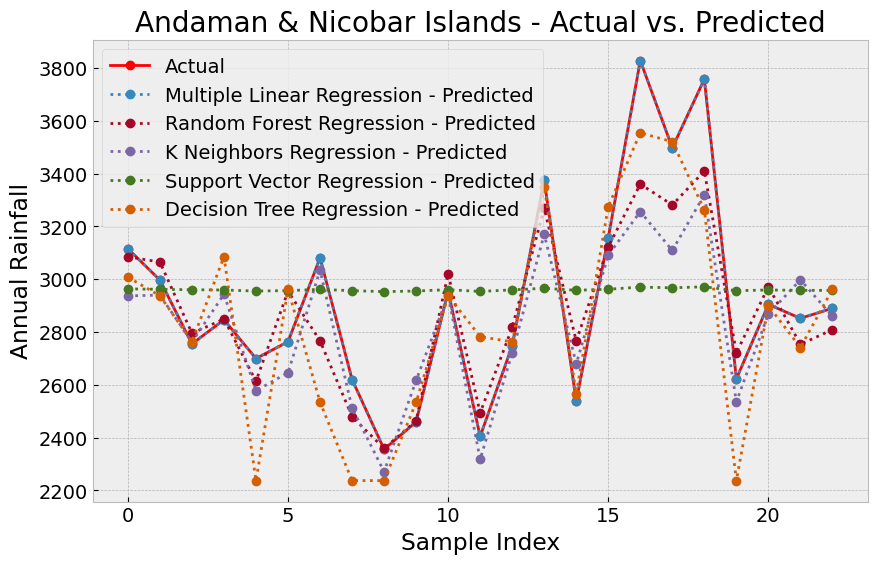

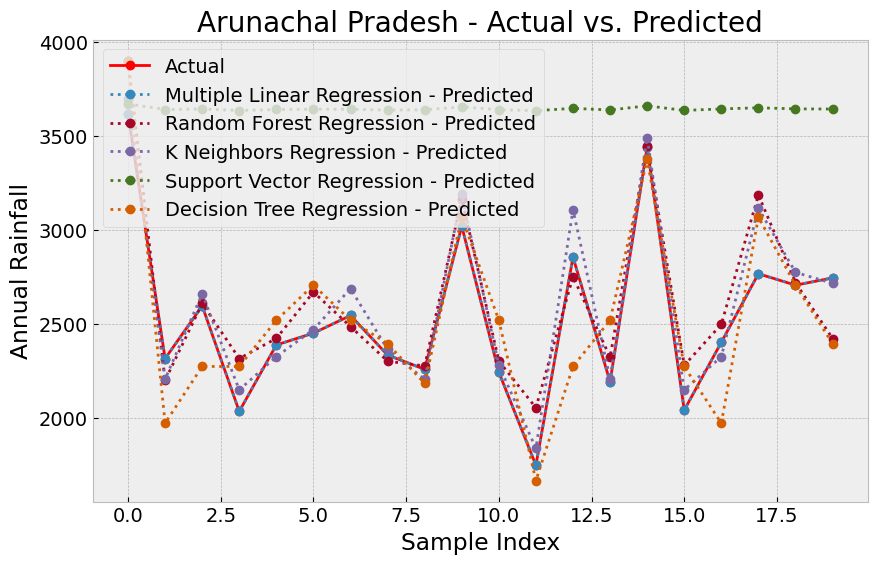

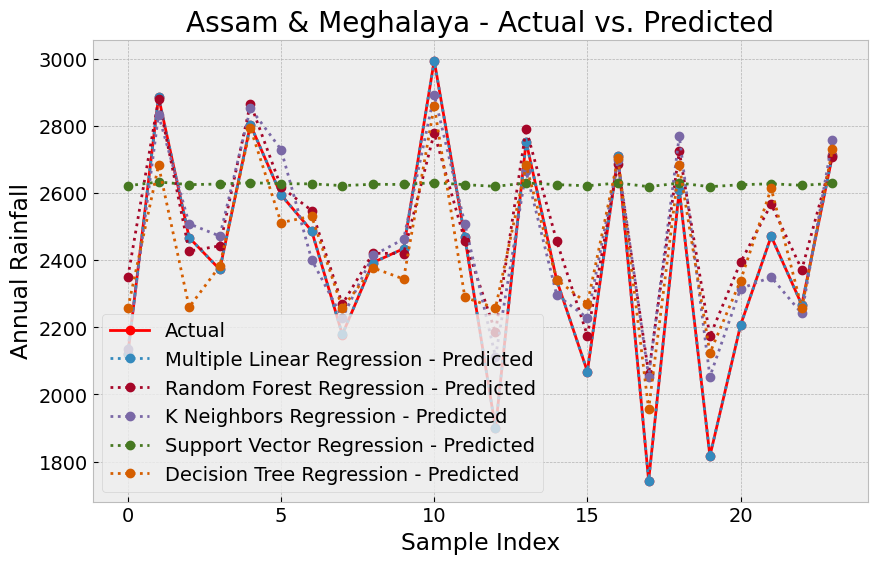

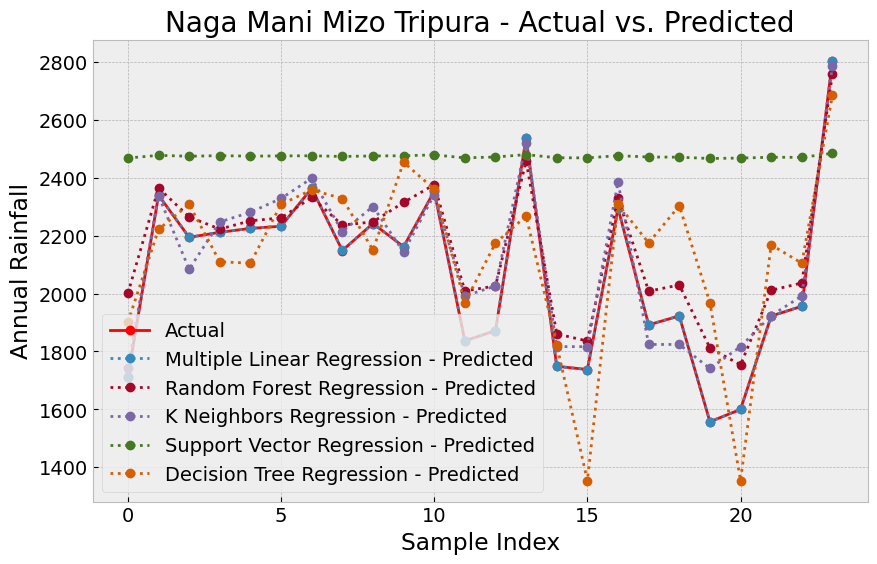

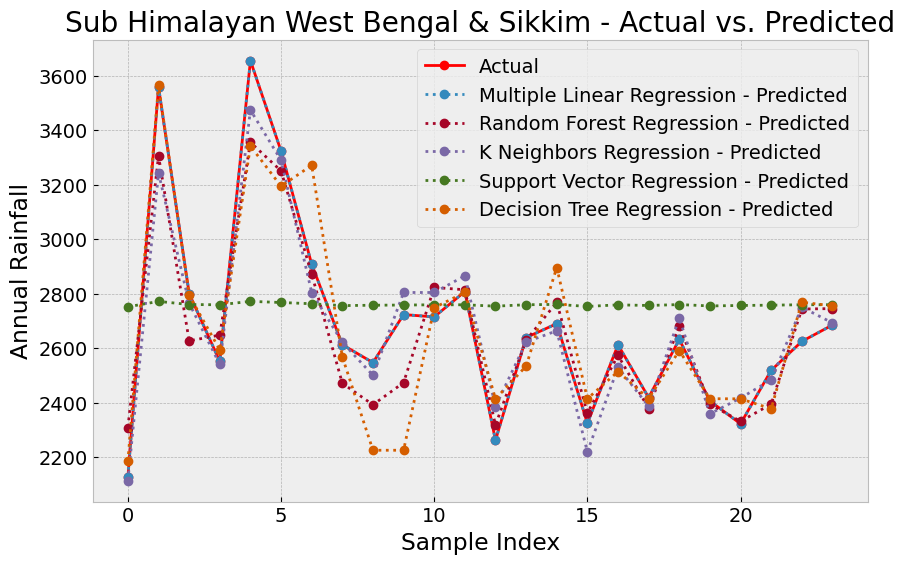

...

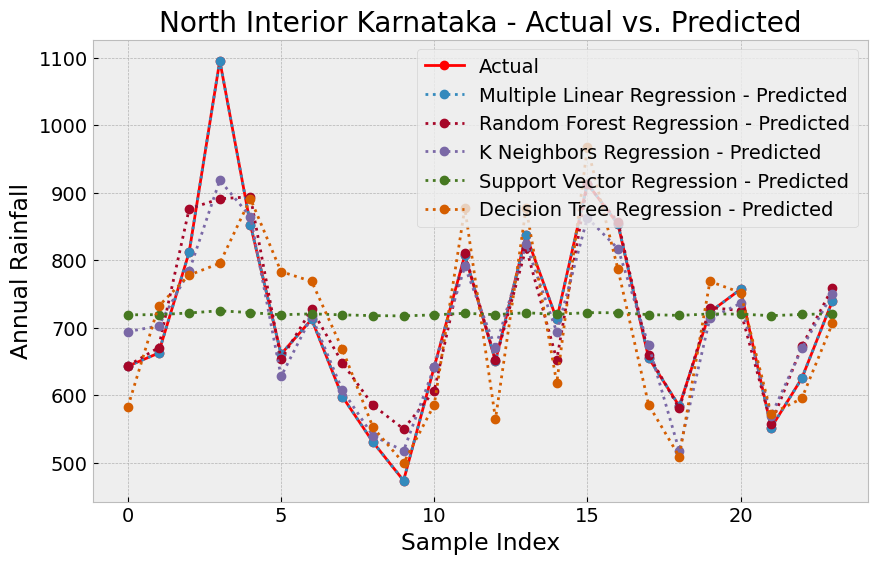

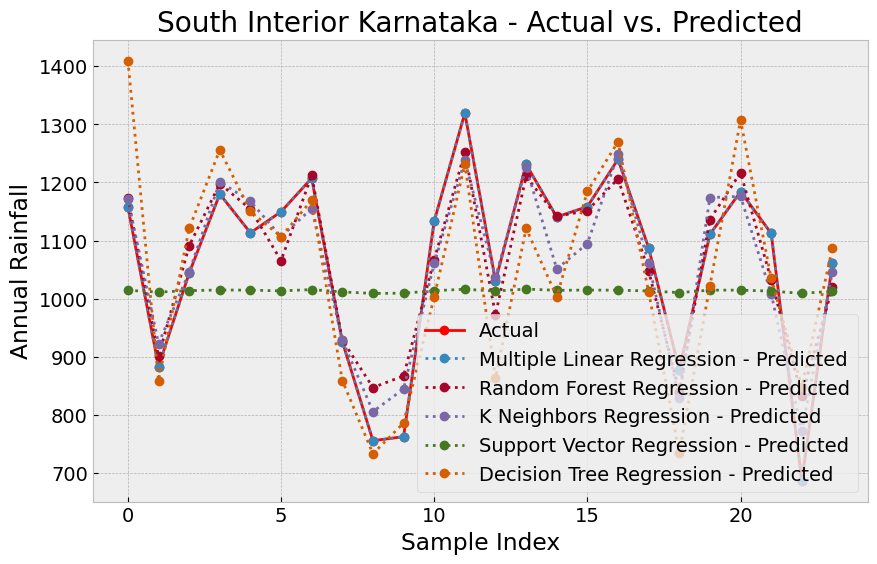

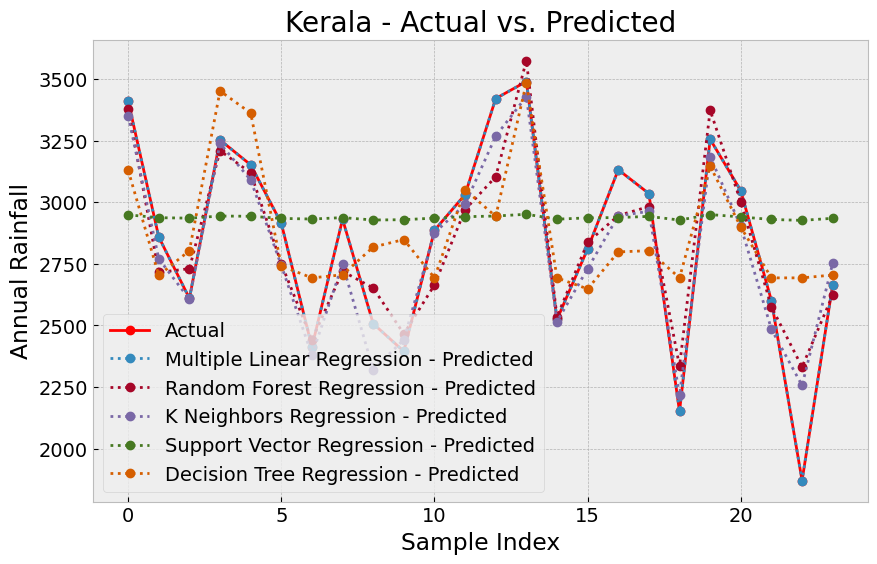

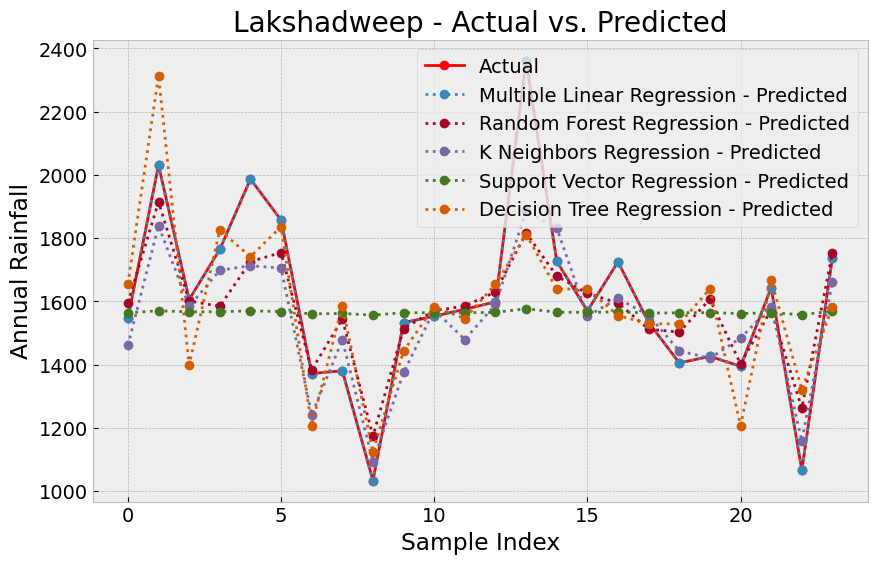

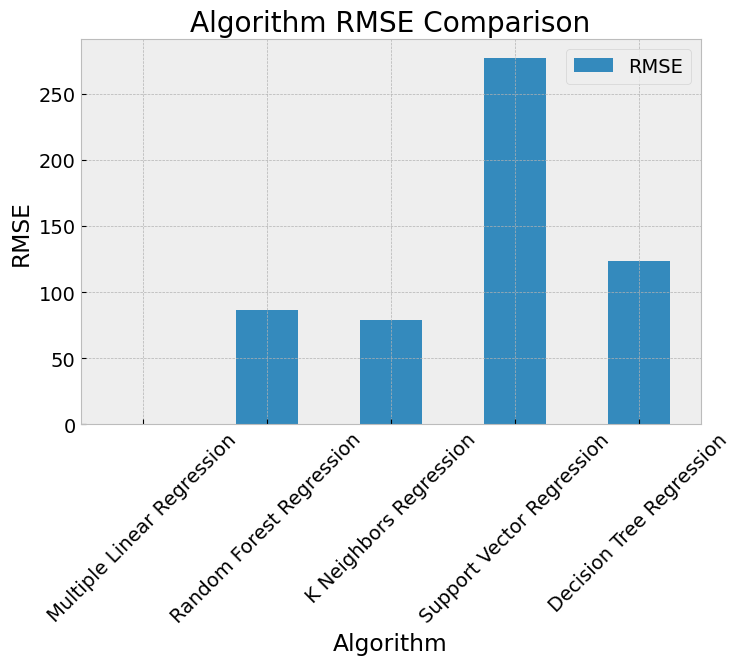

                           Subdivision                              Algorithm  \
0            Andaman & Nicobar Islands     [100.0, 80.66, 74.12, 1.43, 58.45]   
1                    Arunachal Pradesh  [100.0, 81.94, 92.14, -613.32, 63.92]   
2                    Assam & Meghalaya   [100.0, 78.78, 86.11, -43.27, 78.55]   
3               Naga Mani Mizo Tripura   [100.0, 84.6, 90.86, -169.27, 49.41]   
4   Sub Himalayan West Bengal & Sikkim    [100.0, 87.38, 92.58, -1.51, 76.19]   
5                 Gangetic West Bengal    [100.0, 66.45, 87.67, -51.26, 13.8]   
6                               Orissa     [100.0, 81.26, 87.93, 1.71, 66.86]   
7                            Jharkhand   [100.0, 83.34, 91.62, -16.81, 63.65]   
8                                Bihar     [100.0, 89.3, 93.48, -27.48, 86.4]   
9                   East Uttar Pradesh  [100.0, 81.77, 84.65, -196.51, 74.64]   
10                  West Uttar Pradesh   [100.0, 93.64, 95.15, -89.34, 62.12]   
11                         U

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import LabelEncoder


# Separate the features (X) and target variable (Y)
X = rainfall.drop('ANNUAL', 1)
Y = rainfall['ANNUAL']

# Encoding the categorical variables
labelencoder_X = LabelEncoder()
X['SUBDIVISION'] = labelencoder_X.fit_transform(X['SUBDIVISION'])

# List to store the results for each model
results = []

# Get the unique subdivisions
subdivisions = X['SUBDIVISION'].unique()

# Loop over the subdivisions
for subdivision in subdivisions:
    # Filter data for the current subdivision
    subdivision_data = X[X['SUBDIVISION'] == subdivision]
    subdivision_target = Y[X['SUBDIVISION'] == subdivision]

    # Sort data by 'YEAR' within the current subdivision
    subdivision_data.sort_values(by='YEAR', inplace=True)
    subdivision_target.sort_index(inplace=True)

    # Split the data into training and testing sets
    train_size = int(0.8 * len(subdivision_data))
    X_train = subdivision_data.iloc[:train_size]
    X_test = subdivision_data.iloc[train_size:]
    Y_train = subdivision_target.iloc[:train_size]
    Y_test = subdivision_target.iloc[train_size:]

    # Preparing models
    models = [
        ('Multiple Linear Regression', LinearRegression()),
        ('Random Forest Regression', RandomForestRegressor()),
        ('K Neighbors Regression', KNeighborsRegressor(n_neighbors=3)),
        ('Support Vector Regression', SVR(C=2.0, epsilon=0.5)),
        ('Decision Tree Regression', DecisionTreeRegressor(random_state=0))
    ]

    # Evaluate each model in turn
    rmse_scores = []
    r_scores = []
    predicted_values = []

    for name, model in models:
        model.fit(X_train, Y_train)

        # Predicting the Test set results
        y_pred = np.round(model.predict(X_test), decimals=2)
        rmse = np.sqrt(mean_squared_error(Y_test, y_pred))
        r_score = r2_score(Y_test, y_pred)

        # Storing values to be used in data frame
        predicted_values.append(y_pred)
        rmse_scores.append(np.round(rmse, 2))
        r_scores.append(np.round(r_score * 100, 2))

        print(f"Subdivision: {labelencoder_X.inverse_transform([subdivision])[0]}")
        print(f"Algorithm: {name}")
        print(f"RMSE: {rmse:.2f}")
        print(f"R2 Score: {r_score:.2f}")
        print()

    # Store the results for the current subdivision
    results.append((subdivision, models, rmse_scores, r_scores, predicted_values, Y_test))

# Plotting the predicted and actual values for each subdivision
for subdivision, _, _, _, predicted_values, Y_test in results:
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.plot(Y_test.values, label='Actual', color='red', linestyle='-', marker='o')
    for i, (name, _) in enumerate(models):
        ax.plot(predicted_values[i], label=f'{name} - Predicted', linestyle='dotted', marker='o')
    ax.set_xlabel('Sample Index')
    ax.set_ylabel('Annual Rainfall')
    ax.set_title(f'{labelencoder_X.inverse_transform([subdivision])[0]} - Actual vs. Predicted')
    ax.legend()
    plt.show()

# Plotting the RMSE comparison
rmse_scores_avg = np.mean([r for _, _, r, _, _, _ in results], axis=0)
plotdata = pd.DataFrame({"RMSE": rmse_scores_avg}, index=[name for name, _ in models])
plotdata.plot.bar(figsize=(8, 5), title="Algorithm RMSE Comparison")
plt.xlabel("Algorithm")
plt.ylabel("RMSE")
plt.xticks(rotation=45)
plt.show()

# Display the DataFrame with the results
results_df = pd.DataFrame({
    'Subdivision': [labelencoder_X.inverse_transform([subdivision])[0] for subdivision, _, _, _, _, _ in results],
    'Algorithm': [name for _, _, _, name, _, _ in results],
    'RMSE': [r for _, _, _, r, _, _ in results],
    'R2 Score': [s for _, _, _, _, s, _ in results]
})
print(results_df)


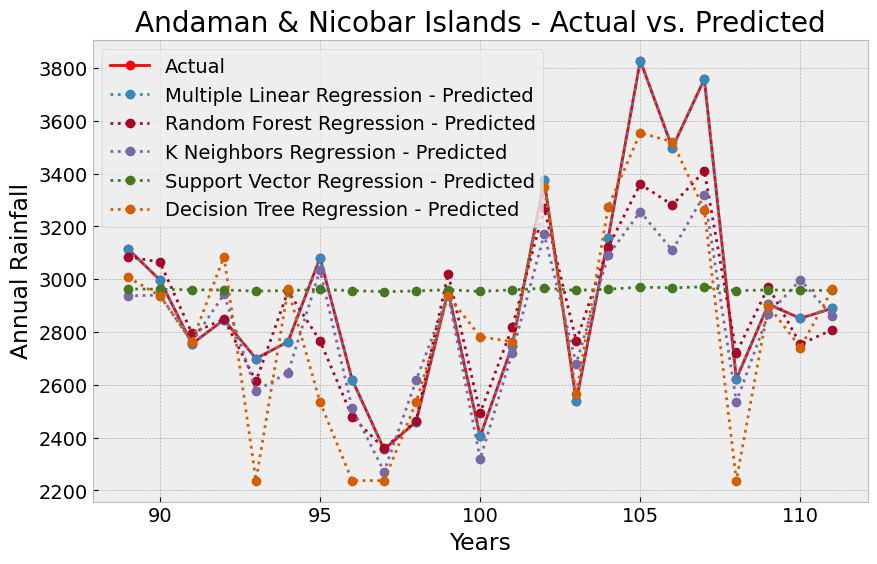

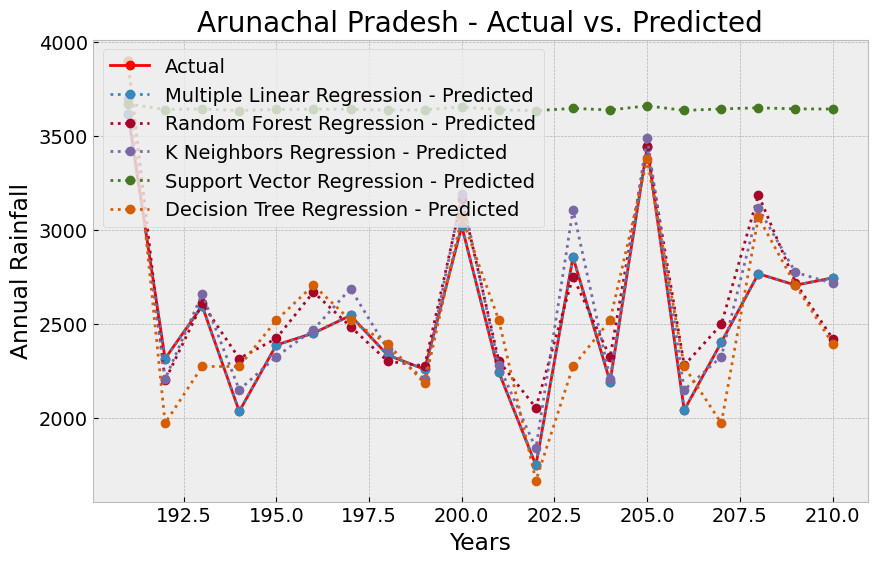

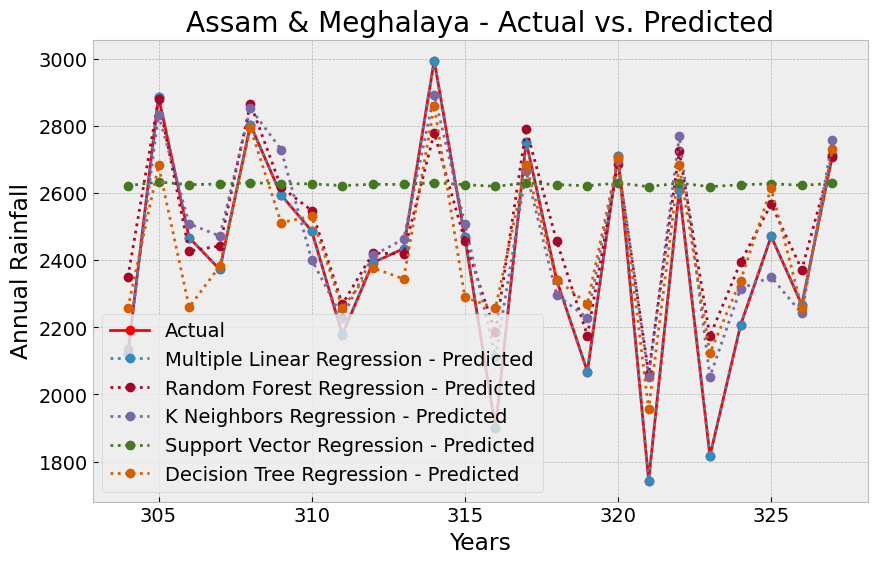

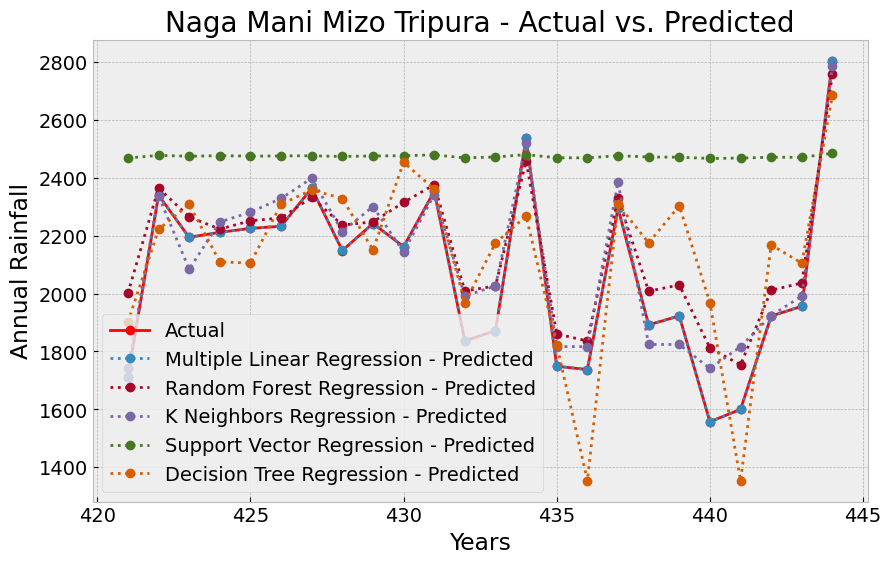

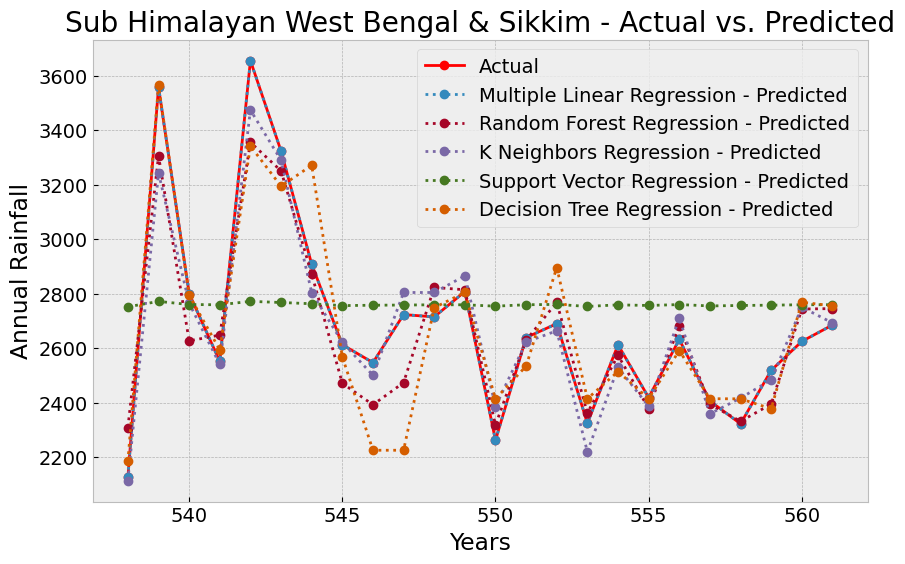

...

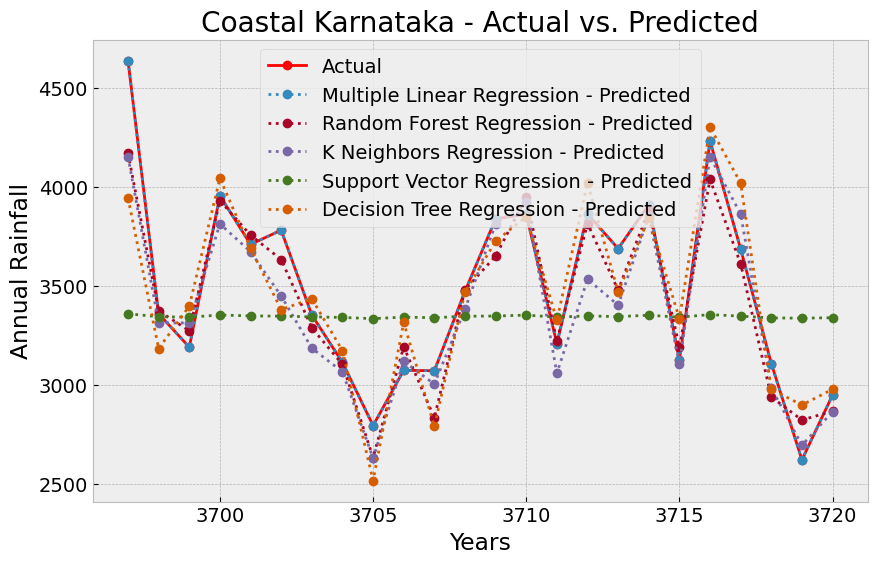

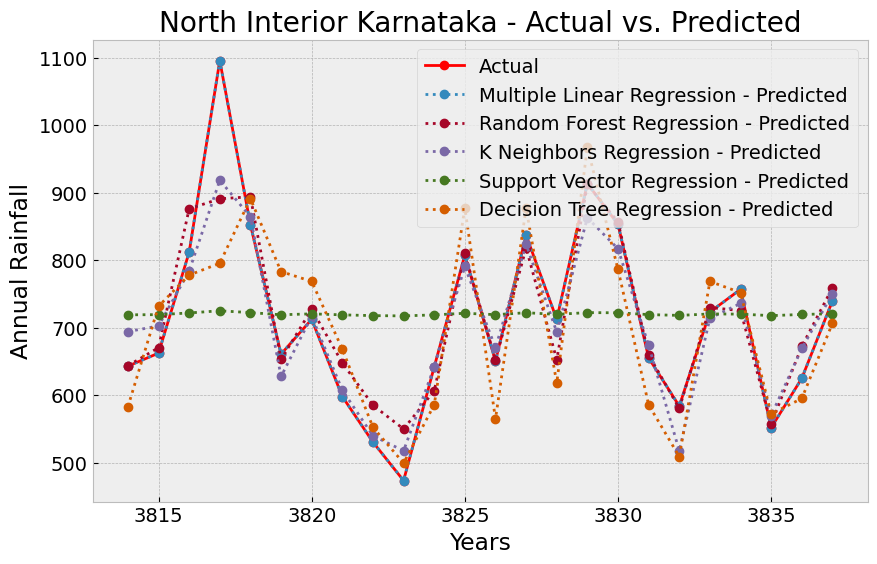

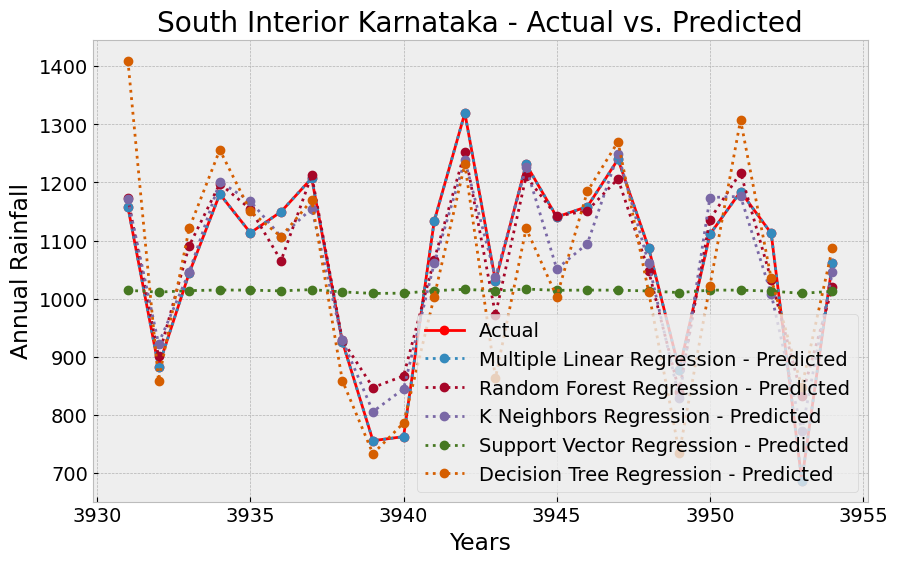

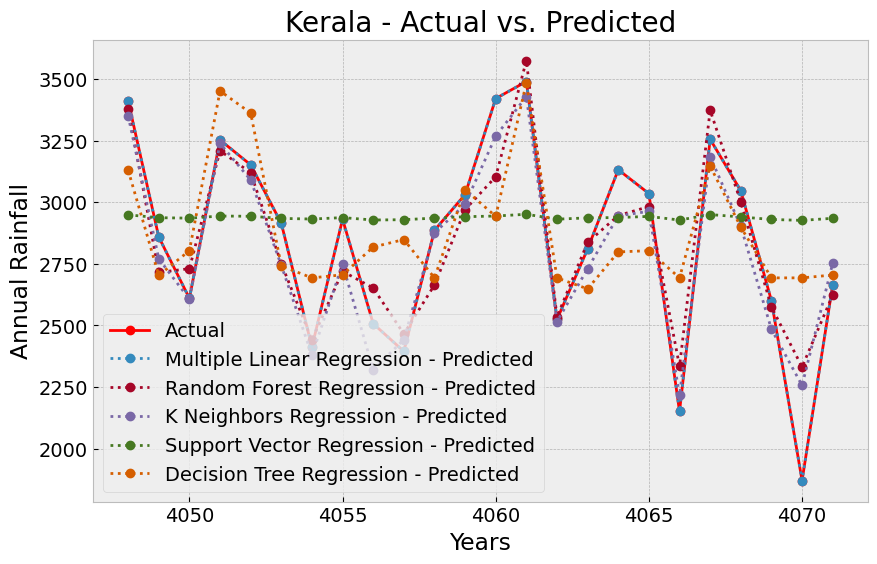

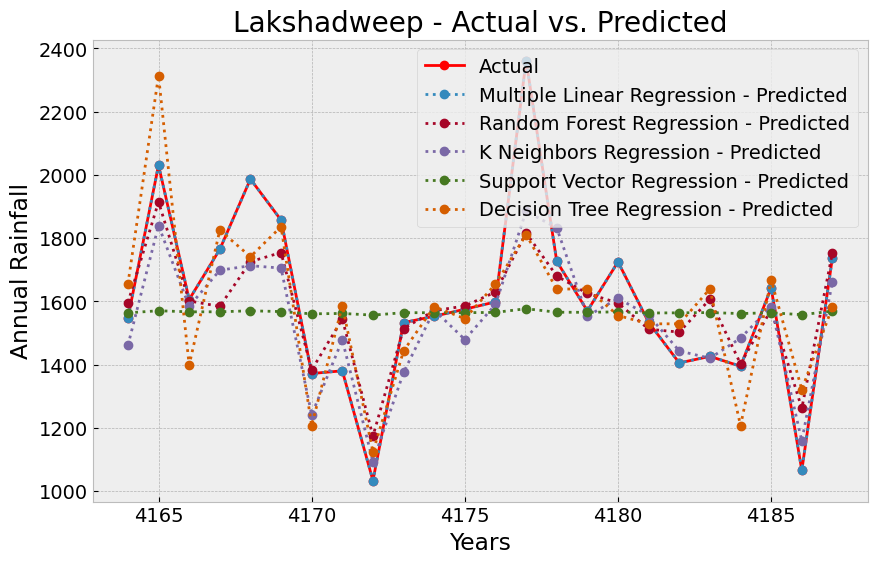

In [ ]:
# Plotting the predicted and actual values for each subdivision
for subdivision, _, _, _, predicted_values, Y_test in results:
    fig, ax = plt.subplots(figsize=(10, 6))
    years = Y_test.index  # Get the years from the index of Y_test

    # Plot the actual rainfall data
    ax.plot(years, Y_test.values, label='Actual', color='red', linestyle='-', marker='o')

    # Plot the predicted rainfall data for each algorithm
    for i, (name, _) in enumerate(models):
        ax.plot(years, predicted_values[i], label=f'{name} - Predicted', linestyle='dotted', marker='o')

    ax.set_xlabel('Years')
    ax.set_ylabel('Annual Rainfall')
    ax.set_title(f'{labelencoder_X.inverse_transform([subdivision])[0]} - Actual vs. Predicted')
    ax.legend()
    plt.show()


Insight- These models help to predict data only from the existing X features and do not help in forecasting future data. Hence, we will try forecasting methods

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

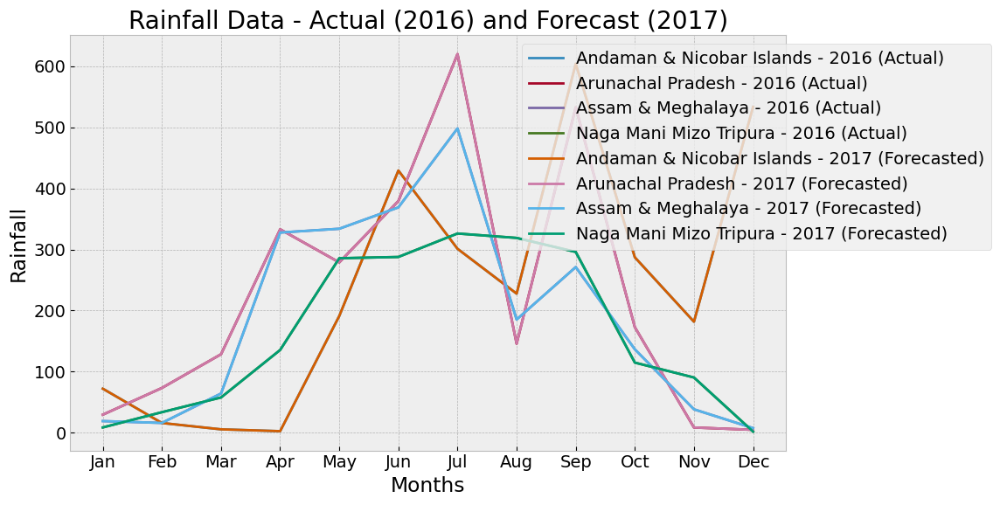

RMSE for Andaman & Nicobar Islands: 139.00523071692902
RMSE for Arunachal Pradesh: 125.42412380931083
RMSE for Assam & Meghalaya: 102.93492685510914
RMSE for Naga Mani Mizo Tripura: 124.20838337245999


In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt
import calendar
import warnings

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data for 2016 and 2017
train_data = rainfall[rainfall['YEAR'] == 2016]
forecast_data = rainfall[rainfall['YEAR'] == 2017]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore")
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)
    return forecast  # Extract the first value from the forecast array

# Forecasting for each subdivision and each column (JAN till DEC)
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 12

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter training data for the current subdivision (data until 2016)
    train_subdivision_data = train_data[train_data['SUBDIVISION'] == subdivision]

    for column in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
        # Separate the target variable (Y) for the current column from training data
        Y_train = train_subdivision_data[column]

        # Define the order of ARIMA model
        arima_order = (2, 1, 2)  # You can tune these hyperparameters as needed

        # Fit ARIMA model and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=arima_order, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

# Create a line chart to visualize the data
plt.figure(figsize=(12, 6))

# Plot actual data for the year 2016
for subdivision in subdivisions[:4]:
    data_2016 = train_data[(train_data['SUBDIVISION'] == subdivision) & (train_data['YEAR'] == 2016)]
    plt.plot(calendar.month_abbr[1:], data_2016.iloc[:, 2:14].values[0], label=f'{subdivision} - 2016 (Actual)')

# Plot forecasted data for the year 2017
for subdivision, forecast_df in forecast_results.items():
    plt.plot(calendar.month_abbr[1:], forecast_df.iloc[:, :-1].values[0], label=f'{subdivision} - 2017 (Forecasted)')

# Customize the plot
plt.xlabel('Months')
plt.ylabel('Rainfall')
plt.title('Rainfall Data - Actual (2016) and Forecast (2017)')
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1))
plt.grid(True)

# Show the plot
plt.tight_layout()
plt.show()

# Evaluate the forecasts for 2017
forecast_evaluation = {}

for subdivision, forecast_df in forecast_results.items():
    # Check if the subdivision exists in the forecast_data for the year 2017
    if subdivision in forecast_data['SUBDIVISION'].unique():
        actual_values = forecast_data[forecast_data['SUBDIVISION'] == subdivision].iloc[:, 2:14].values[0]
        forecasted_values = forecast_df.iloc[:, :-1].values[0]
        rmse = np.sqrt(np.mean((actual_values - forecasted_values) ** 2))
        forecast_evaluation[subdivision] = rmse

# Display the evaluation results
for subdivision, rmse in forecast_evaluation.items():
    print(f'RMSE for {subdivision}: {rmse}')



In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)
    return forecast

# Forecasting for each subdivision and each column (JAN till DEC)
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Define the order of ARIMA model
        arima_order = (2, 1, 2)  # You can tune these hyperparameters as needed

        # Fit ARIMA model and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=arima_order, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

# Evaluate the forecast results for each subdivision and each column
for subdivision, forecast_df in forecast_results.items():
    print(f"Forecast results for {subdivision} (2017):\n")
    print(forecast_df)
    print("\n")

    # Get the actual data for the year 2017 for the current subdivision
    actual_data_2017 = rainfall[(rainfall['SUBDIVISION'] == subdivision) & (rainfall['YEAR'] == 2017)]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate RMSE for each month's forecast
        for month in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
            forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][month].values[0]
            actual_value = actual_data_2017[month].values[0]
            rmse = np.sqrt((forecasted_value - actual_value) ** 2)
            print(f"RMSE for {month}: {rmse}")
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")



/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

Forecast results for Andaman & Nicobar Islands (2017):

          JAN       FEB        MAR        APR         MAY         JUN  \
111  61.08574  27.20888  47.189518  81.009805  357.599444  478.781606   

            JUL         AUG         SEP         OCT         NOV         DEC  \
111  393.862211  421.176644  446.548797  304.009203  228.089759  162.156079   

     YEAR  
111  2017  


No actual data available for Andaman & Nicobar Islands in the year 2017.
Forecast results for Arunachal Pradesh (2017):

          JAN        FEB         MAR         APR         MAY         JUN  \
98  55.137548  67.958124  140.756952  272.089507  265.579801  427.743547   

           JUL         AUG         SEP        OCT        NOV        DEC  YEAR  
98  540.068486  311.385275  377.225716  124.53104  28.387242  23.551504  2017  


No actual data available for Arunachal Pradesh in the year 2017.
Forecast results for Assam & Meghalaya (2017):

           JAN        FEB        MAR         APR         MAY   

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)
    return forecast

# Forecasting for each subdivision and each column (JAN till DEC)
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Define the order of ARIMA model
        arima_order = (2, 1, 2)  # You can tune these hyperparameters as needed

        # Fit ARIMA model and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=arima_order, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

# Evaluate the forecast results for each subdivision and each column
for subdivision, forecast_df in forecast_results.items():
    print(f"Forecast results for {subdivision} (2017):\n")
    print(forecast_df)
    print("\n")

    # Get the actual data for the year 2017 for the current subdivision from rainfall_2017
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate RMSE for each month's forecast
        for month in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
            forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][month].values[0]
            actual_value = actual_data_2017[month].values[0]
            rmse = np.sqrt((forecasted_value - actual_value) ** 2)
            print(f"RMSE for {month}: {rmse}")
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

Forecast results for Andaman & Nicobar Islands (2017):

          JAN       FEB        MAR        APR         MAY         JUN  \
111  61.08574  27.20888  47.189518  81.009805  357.599444  478.781606   

            JUL         AUG         SEP         OCT         NOV         DEC  \
111  393.862211  421.176644  446.548797  304.009203  228.089759  162.156079   

     YEAR  
111  2017  


RMSE for JAN: 167.61425970294442
RMSE for FEB: 21.608880065440466
RMSE for MAR: 14.189517674727057
RMSE for APR: 27.290195362665685
RMSE for MAY: 81.79944422774264
RMSE for JUN: 129.68160550264423
RMSE for JUL: 4.4622111976520955
RMSE for AUG: 6.476644008128801
RMSE for SEP: 73.74879680234511
RMSE for OCT: 41.00920334355635
RMSE for NOV: 22.189758609148726
RMSE for DEC: 81.54392054122576
Forecast results for Arunachal Pradesh (2017):

          JAN        FEB         MAR         APR         MAY         JUN  \
98  55.137548  67.958124  140.756952  272.089507  265.579801  427.743547   

           JUL      

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    best_rmse = float('inf')
    best_arima = None

    for p in range(5):
        for d in range(3):
            for q in range(5):
                try:
                    arima_order = (p, d, q)
                    arima_forecast = fit_arima_model(train_data, order=arima_order, forecast_steps=forecast_steps)
                    rmse = np.sqrt(np.mean((train_data.values[-1] - arima_forecast) ** 2))
                    if rmse < best_rmse:
                        best_rmse = rmse
                        best_arima = arima_order
                except:
                    continue

    return best_arima

# Forecasting for each subdivision and each column (JAN till DEC)
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Fit ARIMA model with the best combination and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=best_arima, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

# Evaluate the forecast results for each subdivision and each column
for subdivision, forecast_df in forecast_results.items():
    print(f"Forecast results for {subdivision} (2017):\n")
    print(forecast_df)
    print("\n")

    # Get the actual data for the year 2017 for the current subdivision from rainfall_2017
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate RMSE for each month's forecast
        for month in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
            if month in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][month].values[0]
                actual_value = actual_data_2017[month].values[0]
                rmse = np.sqrt((forecasted_value - actual_value) ** 2)
                print(f"RMSE for {month}: {rmse}")
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported ind

Forecast results for Andaman & Nicobar Islands (2017):

      JAN   FEB  MAR  APR    MAY    JUN    JUL    AUG    SEP    OCT    NOV  \
111  72.0  15.8  5.4  2.4  191.1  429.4  301.2  227.7  604.3  287.2  181.7   

       DEC  YEAR  
111  533.7  2017  


RMSE for JAN: 156.7
RMSE for FEB: 10.200000000000003
RMSE for MAR: 27.6
RMSE for APR: 105.89999999999999
RMSE for MAY: 84.70000000000005
RMSE for JUN: 80.29999999999995
RMSE for JUL: 88.20000000000005
RMSE for AUG: 186.99999999999997
RMSE for SEP: 231.49999999999994
RMSE for OCT: 24.19999999999999
RMSE for NOV: 24.200000000000017
RMSE for DEC: 290.00000000000006
Forecast results for Arunachal Pradesh (2017):

     JAN   FEB    MAR    APR    MAY    JUN    JUL    AUG    SEP    OCT  NOV  \
98  29.4  73.2  128.4  333.1  278.9  379.4  620.1  145.7  532.9  172.7  8.4   

    DEC  YEAR  
98  4.6  2017  


RMSE for JAN: 21.2
RMSE for FEB: 13.0
RMSE for MAR: 93.4
RMSE for APR: 15.099999999999966
RMSE for MAY: 21.799999999999955
RMSE for JUN: 8.59

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

If the forecasting problem is sensitive to large errors and outliers, RMSE might be a better choice as it emphasizes the importance of minimizing large errors.
If the forecasting problem is more concerned with overall forecasting accuracy and wants to understand the relative percentage error, MAPE might be preferred.

# ARIMA

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings


# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    best_mape = float('inf')
    best_arima = None

    for p in range(5):
        for d in range(3):
            for q in range(5):
                try:
                    arima_order = (p, d, q)
                    arima_forecast = fit_arima_model(train_data, order=arima_order, forecast_steps=forecast_steps)
                    mape = calculate_mape(train_data.values[-1], arima_forecast)
                    if mape < best_mape:
                        best_mape = mape
                        best_arima = arima_order
                except:
                    continue

    return best_arima

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Forecasting for each subdivision and each column (JAN till DEC)
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Fit ARIMA model with the best combination and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=best_arima, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

# Load the rainfall_2017 DataFrame here (assuming you have already loaded it)
# rainfall_2017 = pd.read_csv('rainfall_2017.csv')

# Evaluate the forecast results for each subdivision and each column
for subdivision, forecast_df in forecast_results.items():
    print(f"Forecast results for {subdivision} (2017):\n")
    print(forecast_df.round(2))
    print("\n")

    # Get the actual data for the year 2017 for the current subdivision from rainfall_2017
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate MAPE for each month's forecast
        for month in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
            if month in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][month].values[0]
                actual_value = actual_data_2017[month].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                print(f"MAPE for {month}: {mape:.2f}%")
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported ind

Forecast results for Andaman & Nicobar Islands (2017):

      JAN   FEB  MAR  APR    MAY    JUN    JUL    AUG    SEP    OCT    NOV  \
111  72.0  15.8  5.4  2.4  191.1  429.4  301.2  227.7  604.3  287.2  181.7   

       DEC  YEAR  
111  533.7  2017  


MAPE for JAN: 68.52%
MAPE for FEB: 182.14%
MAPE for MAR: 83.64%
MAPE for APR: 97.78%
MAPE for MAY: 30.71%
MAPE for JUN: 23.00%
MAPE for JUL: 22.65%
MAPE for AUG: 45.09%
MAPE for SEP: 62.10%
MAPE for OCT: 9.20%
MAPE for NOV: 11.75%
MAPE for DEC: 119.00%


Forecast results for Arunachal Pradesh (2017):

     JAN   FEB    MAR    APR    MAY    JUN    JUL    AUG    SEP    OCT  NOV  \
98  29.4  73.2  128.4  333.1  278.9  379.4  620.1  145.7  532.9  172.7  8.4   

    DEC  YEAR  
98  4.6  2017  


MAPE for JAN: 258.54%
MAPE for FEB: 15.08%
MAPE for MAR: 42.11%
MAPE for APR: 4.34%
MAPE for MAY: 8.48%
MAPE for JUN: 2.32%
MAPE for JUL: 41.64%
MAPE for AUG: 68.08%
MAPE for SEP: 67.26%
MAPE for OCT: 23.95%
MAPE for NOV: 15.15%
MAPE for DEC: 35.29%



/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    best_rmse = float('inf')
    best_arima = None

    for p in range(5):
        for d in range(3):
            for q in range(5):
                try:
                    arima_order = (p, d, q)
                    arima_forecast = fit_arima_model(train_data, order=arima_order, forecast_steps=forecast_steps)
                    rmse = np.sqrt(np.mean((train_data.values[-1] - arima_forecast) ** 2))
                    if rmse < best_rmse:
                        best_rmse = rmse
                        best_arima = arima_order
                except:
                    continue

    return best_arima

# Function to find the best ARIMA combination for each month with MAPE > 50%
def find_best_arima_combination_with_high_mape(train_data, forecast_steps):
    best_mape = 50.0  # Threshold for MAPE
    best_arima = None

    for p in range(5):
        for d in range(3):
            for q in range(5):
                try:
                    arima_order = (p, d, q)
                    arima_forecast = fit_arima_model(train_data, order=arima_order, forecast_steps=forecast_steps)
                    mape = np.mean(np.abs((train_data.values[-1] - arima_forecast) / train_data.values[-1])) * 100
                    if mape < best_mape:
                        best_mape = mape
                        best_arima = arima_order
                except:
                    continue

    return best_arima

# Forecasting for each subdivision and each column (JAN till DEC)
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        if find_best_arima_combination_with_high_mape(Y_train, forecast_steps) is None:
            continue  # Skip this column if no improvement is possible

        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Fit ARIMA model with the best combination and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=best_arima, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

# Evaluate the forecast results for each subdivision and each column
for subdivision, forecast_df in forecast_results.items():
    print(f"Forecast results for {subdivision} (2017):\n")
    print(forecast_df.round(2))
    print("\n")

    # Get the actual data for the year 2017 for the current subdivision from rainfall_2017
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate MAPE for each month's forecast
        for month in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
            if month in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][month].values[0]
                actual_value = actual_data_2017[month].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                print(f"MAPE for {month}: {mape:.2f}%")
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported ind

Forecast results for Andaman & Nicobar Islands (2017):

      JAN   FEB  MAR  APR    MAY    JUN    JUL    AUG    SEP    OCT    NOV  \
111  72.0  15.8  5.4  2.4  191.1  429.4  301.2  227.7  604.3  287.2  181.7   

       DEC  YEAR  
111  533.7  2017  


MAPE for JAN: 68.52%
MAPE for FEB: 182.14%
MAPE for MAR: 83.64%
MAPE for APR: 97.78%
MAPE for MAY: 30.71%
MAPE for JUN: 23.00%
MAPE for JUL: 22.65%
MAPE for AUG: 45.09%
MAPE for SEP: 62.10%
MAPE for OCT: 9.20%
MAPE for NOV: 11.75%
MAPE for DEC: 119.00%


Forecast results for Arunachal Pradesh (2017):

     JAN   FEB    MAR    APR    MAY    JUN    JUL    AUG    SEP    OCT  NOV  \
98  29.4  73.2  128.4  333.1  278.9  379.4  620.1  145.7  532.9  172.7  8.4   

    DEC  YEAR  
98  4.6  2017  


MAPE for JAN: 258.54%
MAPE for FEB: 15.08%
MAPE for MAR: 42.11%
MAPE for APR: 4.34%
MAPE for MAY: 8.48%
MAPE for JUN: 2.32%
MAPE for JUL: 41.64%
MAPE for AUG: 68.08%
MAPE for SEP: 67.26%
MAPE for OCT: 23.95%
MAPE for NOV: 15.15%
MAPE for DEC: 35.29%



/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    best_mape = float('inf')
    best_arima = None

    for p in range(5):
        for d in range(3):
            for q in range(5):
                try:
                    arima_order = (p, d, q)
                    arima_forecast = fit_arima_model(train_data, order=arima_order, forecast_steps=forecast_steps)
                    mape = calculate_mape(train_data.values[-1], arima_forecast)
                    if mape < best_mape:
                        best_mape = mape
                        best_arima = arima_order
                except:
                    continue

    return best_arima

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Forecasting for each subdivision and each column (JAN till DEC)
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Fit ARIMA model with the best combination and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=best_arima, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

# Evaluate the forecast results for each subdivision and each column
for subdivision, forecast_df in forecast_results.items():
    print(f"Forecast results for {subdivision} (2017):\n")
    print(forecast_df.round(2))
    print("\n")

    # Get the actual data for the years 2015, 2016, and 2017 for the current subdivision from rainfall
    actual_data_2015 = rainfall[(rainfall['SUBDIVISION'] == subdivision) & (rainfall['YEAR'] == 2015)]
    actual_data_2016 = rainfall[(rainfall['SUBDIVISION'] == subdivision) & (rainfall['YEAR'] == 2016)]
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Print actual rainfall for 2015 and 2016
        print(f"Actual rainfall for {subdivision} in 2015:\n")
        print(actual_data_2015[['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']])
        print("\n")
        print(f"Actual rainfall for {subdivision} in 2016:\n")
        print(actual_data_2016[['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']])
        print("\n")

        # Print actual and forecasted rainfall for 2017
        print(f"Actual rainfall for {subdivision} in 2017:\n")
        print(actual_data_2017[['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']])
        print("\n")
        print(f"Forecasted rainfall for {subdivision} in 2017:\n")
        print(forecast_df[['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']])
        print("\n")

        # Calculate MAPE for each month's forecast
        for month in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
            if month in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][month].values[0]
                actual_value = actual_data_2017[month].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                print(f"MAPE for {month}: {mape:.2f}%")
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported i

Forecast results for Andaman & Nicobar Islands (2017):

      JAN   FEB  MAR  APR    MAY    JUN    JUL    AUG    SEP    OCT    NOV  \
111  72.0  15.8  5.4  2.4  191.1  429.4  301.2  227.7  604.3  287.2  181.7   

       DEC  YEAR  
111  533.7  2017  


Actual rainfall for Andaman & Nicobar Islands in 2015:

       JAN  FEB  MAR    APR    MAY    JUN    JUL    AUG    SEP    OCT    NOV  \
109  126.8  7.6  3.1  138.2  331.9  346.4  328.9  480.0  523.3  252.1  236.3   

       DEC  
109  129.9  


Actual rainfall for Andaman & Nicobar Islands in 2016:

      JAN   FEB  MAR  APR    MAY    JUN    JUL    AUG    SEP    OCT    NOV  \
110  72.0  15.8  5.4  2.4  191.1  429.4  301.2  227.7  604.3  287.2  181.7   

       DEC  
110  533.7  


Actual rainfall for Andaman & Nicobar Islands in 2017:

       JAN  FEB   MAR    APR    MAY    JUN    JUL    AUG    SEP    OCT    NOV  \
111  228.7  5.6  33.0  108.3  275.8  349.1  389.4  414.7  372.8  263.0  205.9   

       DEC  
111  243.7  


Forecasted rai

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    best_mape = float('inf')
    best_arima = None

    for p in range(5):
        for d in range(3):
            for q in range(5):
                try:
                    arima_order = (p, d, q)
                    arima_forecast = fit_arima_model(train_data, order=arima_order, forecast_steps=forecast_steps)
                    mape = calculate_mape(train_data.values[-1], arima_forecast)
                    if mape < best_mape:
                        best_mape = mape
                        best_arima = arima_order
                except:
                    continue

    return best_arima

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Recursive forecasting for each subdivision and each column (JAN till DEC)
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Initialize forecasted values list with the known data (till Dec 2016)
        forecasted_values = Y_train.tolist()

        # Recursive forecasting for the year 2017
        for _ in range(12):  # Forecast for each month in 2017
            # Fit ARIMA model with the best combination and make predictions for the next month
            arima_forecast = fit_arima_model(forecasted_values, order=best_arima, forecast_steps=1)
            forecasted_values.append(arima_forecast[0])  # Append the forecasted value to the list

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = forecasted_values[12:]  # Skip the known data (till Dec 2016)

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

# Evaluate the forecast results for each subdivision and each column
for subdivision, forecast_df in forecast_results.items():
    print(f"Forecast results for {subdivision} (2017):\n")
    print(forecast_df.round(2))
    print("\n")

    # Get the actual data for the years 2015, 2016, and 2017 for the current subdivision from rainfall
    actual_data_2015 = rainfall[(rainfall['SUBDIVISION'] == subdivision) & (rainfall['YEAR'] == 2015)]
    actual_data_2016 = rainfall[(rainfall['SUBDIVISION'] == subdivision) & (rainfall['YEAR'] == 2016)]
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Print actual rainfall for 2015 and 2016
        print(f"Actual rainfall for {subdivision} in 2015:\n")
        print(actual_data_2015[['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']])
        print("\n")
        print(f"Actual rainfall for {subdivision} in 2016:\n")
        print(actual_data_2016[['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']])
        print("\n")

        # Print actual and forecasted rainfall for 2017
        print(f"Actual rainfall for {subdivision} in 2017:\n")
        print(actual_data_2017[['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']])
        print("\n")
        print(f"Forecasted rainfall for {subdivision} in 2017:\n")
        print(forecast_df[['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']])
        print("\n")

        # Calculate MAPE for each month's forecast
        for month in ['JAN', 'FEB', 'MAR', 'APR', 'MAY', 'JUN', 'JUL', 'AUG', 'SEP', 'OCT', 'NOV', 'DEC']:
            if month in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][month].values[0]
                actual_value = actual_data_2017[month].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                print(f"MAPE for {month}: {mape:.2f}%")
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported i

Forecast results for Andaman & Nicobar Islands (2017):

      JAN   FEB    MAR   APR    MAY    JUN    JUL    AUG    SEP    OCT    NOV  \
0     0.0   0.0    0.0  37.7  298.8  383.3  792.8  520.5  310.8  139.8  184.4   
1    45.0  56.7   33.3  40.9  170.2  334.7  269.0  317.2  429.8  468.1  258.4   
2     0.0   0.0    0.0   0.5  487.4  450.1  317.3  425.0  561.2  369.7  192.6   
3     8.0   3.6  112.0   4.5  295.9  301.1  394.8  437.4  471.8  238.1  108.3   
4    77.4   6.9   11.4  10.7  729.3  710.8  200.9  455.4  303.3  227.0  366.9   
..    ...   ...    ...   ...    ...    ...    ...    ...    ...    ...    ...   
106  72.0  15.8    5.4   2.4  191.1  429.4  301.2  227.7  604.3  287.2  181.7   
107  72.0  15.8    5.4   2.4  191.1  429.4  301.2  227.7  604.3  287.2  181.7   
108  72.0  15.8    5.4   2.4  191.1  429.4  301.2  227.7  604.3  287.2  181.7   
109  72.0  15.8    5.4   2.4  191.1  429.4  301.2  227.7  604.3  287.2  181.7   
110  72.0  15.8    5.4   2.4  191.1  429.4  301.2  22

Insight- taking forecasted values of previous months for predicting the next month produces worse results

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings
from sklearn.model_selection import TimeSeriesSplit

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    best_mape = float('inf')
    best_arima = None

    for p in range(5):
        for d in range(3):
            for q in range(5):
                try:
                    arima_order = (p, d, q)
                    arima_forecast = fit_arima_model(train_data, order=arima_order, forecast_steps=forecast_steps)
                    mape = calculate_mape(train_data.values[-1], arima_forecast)
                    if mape < best_mape:
                        best_mape = mape
                        best_arima = arima_order
                except:
                    continue

    return best_arima

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Forecasting for each subdivision and each column ('JF', 'MAM', 'JJAS', 'OND')
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

# Number of folds for cross-validation
n_splits = 5

# Initialize TimeSeriesSplit with the number of splits
tscv = TimeSeriesSplit(n_splits=n_splits)

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['JF', 'MAM', 'JJAS', 'OND']:  # Loop over the new column names
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Fit ARIMA model with the best combination and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=best_arima, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

# Evaluate the forecast results for each subdivision and each column
for subdivision, forecast_df in forecast_results.items():
    print(f"Forecast results for {subdivision} (2017):\n")
    print(forecast_df.round(2))
    print("\n")

    # Get the actual data for the years 2015, 2016, and 2017 for the current subdivision from rainfall
    actual_data_2015 = rainfall[(rainfall['SUBDIVISION'] == subdivision) & (rainfall['YEAR'] == 2015)]
    actual_data_2016 = rainfall[(rainfall['SUBDIVISION'] == subdivision) & (rainfall['YEAR'] == 2016)]
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Print actual rainfall for 2015 and 2016
        print(f"Actual rainfall for {subdivision} in 2015:\n")
        print(actual_data_2015[['JF', 'MAM', 'JJAS', 'OND']])
        print("\n")
        print(f"Actual rainfall for {subdivision} in 2016:\n")
        print(actual_data_2016[['JF', 'MAM', 'JJAS', 'OND']])
        print("\n")

        # Print actual and forecasted rainfall for 2017
        print(f"Actual rainfall for {subdivision} in 2017:\n")
        print(actual_data_2017[['JF', 'MAM', 'JJAS', 'OND']])
        print("\n")
        print(f"Forecasted rainfall for {subdivision} in 2017:\n")
        print(forecast_df[['JF', 'MAM', 'JJAS', 'OND']])
        print("\n")

        # Calculate MAPE for each column's forecast
        for column in ['JF', 'MAM', 'JJAS', 'OND']:
            if column in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][column].values[0]
                actual_value = actual_data_2017[column].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                print(f"MAPE for {column}: {mape:.2f}%")
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported ind

Forecast results for Andaman & Nicobar Islands (2017):

       JF    MAM    JJAS     OND  YEAR
111  87.8  198.9  1562.6  1002.6  2017


Actual rainfall for Andaman & Nicobar Islands in 2015:

        JF    MAM    JJAS    OND
109  134.4  473.2  1678.6  618.4


Actual rainfall for Andaman & Nicobar Islands in 2016:

       JF    MAM    JJAS     OND
110  87.8  198.9  1562.6  1002.6


Actual rainfall for Andaman & Nicobar Islands in 2017:

        JF    MAM    JJAS    OND
111  234.2  417.1  1526.0  712.6


Forecasted rainfall for Andaman & Nicobar Islands in 2017:

       JF    MAM    JJAS     OND
111  87.8  198.9  1562.6  1002.6


MAPE for JF: 62.51%
MAPE for MAM: 52.31%
MAPE for JJAS: 2.40%
MAPE for OND: 40.70%


Forecast results for Arunachal Pradesh (2017):

       JF    MAM    JJAS    OND  YEAR
98  102.6  740.4  1678.2  185.7  2017


Actual rainfall for Arunachal Pradesh in 2015:

       JF    MAM    JJAS    OND
208  78.3  623.5  1936.9  128.8


Actual rainfall for Arunachal Pradesh i

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

In [ ]:
rainfall.head()

,SUBDIVISION,YEAR,JAN,FEB,MAR,APR,MAY,JUN,JUL,AUG,...,JF,MAM,JJAS,OND,Total Kharif,Total Rabi,Total Zaid,Kharif (Avg. Jun-Sept),Rabi (Avg. Oct-Mar),Zaid (Avg. Mar-Jun)
0,Andaman & Nicobar Islands,1901,49.2,87.1,29.2,2.3,528.8,517.5,365.1,481.1,...,136.3,560.3,1696.3,980.3,1696.3,1145.8,1077.8,424.1,191.0,269.4
1,Andaman & Nicobar Islands,1902,0.0,159.8,12.2,0.0,446.1,537.1,228.9,753.7,...,159.8,458.3,2185.9,716.7,2185.9,888.7,995.4,546.5,148.1,248.9
2,Andaman & Nicobar Islands,1903,12.7,144.0,0.0,1.0,235.1,479.9,728.4,326.7,...,156.7,236.1,1874.0,690.6,1874.0,847.3,716.0,468.5,141.2,179.0
3,Andaman & Nicobar Islands,1904,9.4,14.7,0.0,202.4,304.5,495.1,502.0,160.1,...,24.1,506.9,1977.6,571.0,1977.6,595.1,1002.0,494.4,99.2,250.5
4,Andaman & Nicobar Islands,1905,1.3,0.0,3.3,26.9,279.5,628.7,368.7,330.5,...,1.3,309.7,1624.9,630.8,1624.9,635.4,938.4,406.2,105.9,234.6


In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings
from sklearn.model_selection import TimeSeriesSplit

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    best_mape = float('inf')
    best_arima = None

    for p in range(5):
        for d in range(3):
            for q in range(5):
                try:
                    arima_order = (p, d, q)
                    arima_forecast = fit_arima_model(train_data, order=arima_order, forecast_steps=forecast_steps)
                    mape = calculate_mape(train_data.values[-1], arima_forecast)
                    if mape < best_mape:
                        best_mape = mape
                        best_arima = arima_order
                except:
                    continue

    return best_arima

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Forecasting for each subdivision and each column ('Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)')
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

# Number of folds for cross-validation
n_splits = 5

# Initialize TimeSeriesSplit with the number of splits
tscv = TimeSeriesSplit(n_splits=n_splits)

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:  # Loop over the new column names
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Fit ARIMA model with the best combination and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=best_arima, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

# Evaluate the forecast results for each subdivision and each column
for subdivision, forecast_df in forecast_results.items():
    print(f"Forecast results for {subdivision} (2017):\n")
    print(forecast_df.round(2))
    print("\n")

    # Get the actual data for the years 2015, 2016, and 2017 for the current subdivision from rainfall
    actual_data_2015 = rainfall[(rainfall['SUBDIVISION'] == subdivision) & (rainfall['YEAR'] == 2015)]
    actual_data_2016 = rainfall[(rainfall['SUBDIVISION'] == subdivision) & (rainfall['YEAR'] == 2016)]
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Print actual rainfall for 2015 and 2016
        print(f"Actual rainfall for {subdivision} in 2015:\n")
        print(actual_data_2015[['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']])
        print("\n")
        print(f"Actual rainfall for {subdivision} in 2016:\n")
        print(actual_data_2016[['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']])
        print("\n")

        # Print actual and forecasted rainfall for 2017
        print(f"Actual rainfall for {subdivision} in 2017:\n")
        print(actual_data_2017[['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']])
        print("\n")
        print(f"Forecasted rainfall for {subdivision} in 2017:\n")
        print(forecast_df[['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']])
        print("\n")

        # Calculate MAPE for each column's forecast
        for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:
            if column in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][column].values[0]
                actual_value = actual_data_2017[column].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                print(f"MAPE for {column}: {mape:.2f}%")
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported ind

Forecast results for Andaman & Nicobar Islands (2017):

     Kharif (Avg. Jun-Sept)  Rabi (Avg. Oct-Mar)  Zaid (Avg. Mar-Jun)  YEAR
111                   390.6                182.6                157.1  2017


Actual rainfall for Andaman & Nicobar Islands in 2015:

     Kharif (Avg. Jun-Sept)  Rabi (Avg. Oct-Mar)  Zaid (Avg. Mar-Jun)
109                   419.6                126.0                204.9


Actual rainfall for Andaman & Nicobar Islands in 2016:

     Kharif (Avg. Jun-Sept)  Rabi (Avg. Oct-Mar)  Zaid (Avg. Mar-Jun)
110                   390.6                182.6                157.1


Actual rainfall for Andaman & Nicobar Islands in 2017:

     Kharif (Avg. Jun-Sept)  Rabi (Avg. Oct-Mar)  Zaid (Avg. Mar-Jun)
111                   381.5                163.3                191.6


Forecasted rainfall for Andaman & Nicobar Islands in 2017:

     Kharif (Avg. Jun-Sept)  Rabi (Avg. Oct-Mar)  Zaid (Avg. Mar-Jun)
111                   390.6                182.6                15

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings
from sklearn.model_selection import TimeSeriesSplit

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    best_mape = float('inf')
    best_arima = None

    for p in range(5):
        for d in range(3):
            for q in range(5):
                try:
                    arima_order = (p, d, q)
                    arima_forecast = fit_arima_model(train_data, order=arima_order, forecast_steps=forecast_steps)
                    mape = calculate_mape(train_data.values[-1], arima_forecast)
                    if mape < best_mape:
                        best_mape = mape
                        best_arima = arima_order
                except:
                    continue

    return best_arima

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Function to calculate MAE
def calculate_mae(actual_values, forecast_values):
    return np.mean(np.abs(actual_values - forecast_values))

# Function to calculate RMSE
def calculate_rmse(actual_values, forecast_values):
    return np.sqrt(np.mean((actual_values - forecast_values) ** 2))

# Forecasting for each subdivision and each column ('Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)')
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

# Number of folds for cross-validation
n_splits = 5

# Initialize TimeSeriesSplit with the number of splits
tscv = TimeSeriesSplit(n_splits=n_splits)

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:  # Loop over the new column names
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Fit ARIMA model with the best combination and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=best_arima, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

# Evaluate the forecast results for each subdivision and each column
for subdivision, forecast_df in forecast_results.items():
    print(f"Forecast results for {subdivision} (2017):\n")
    print(forecast_df.round(2))
    print("\n")

    # Get the actual data for the years 2015, 2016, and 2017 for the current subdivision from rainfall
    actual_data_2015 = rainfall[(rainfall['SUBDIVISION'] == subdivision) & (rainfall['YEAR'] == 2015)]
    actual_data_2016 = rainfall[(rainfall['SUBDIVISION'] == subdivision) & (rainfall['YEAR'] == 2016)]
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Print actual rainfall for 2015 and 2016
        print(f"Actual rainfall for {subdivision} in 2015:\n")
        print(actual_data_2015[['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']])
        print("\n")
        print(f"Actual rainfall for {subdivision} in 2016:\n")
        print(actual_data_2016[['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']])
        print("\n")

        # Print actual and forecasted rainfall for 2017
        print(f"Actual rainfall for {subdivision} in 2017:\n")
        print(actual_data_2017[['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']])
        print("\n")
        print(f"Forecasted rainfall for {subdivision} in 2017:\n")
        print(forecast_df[['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']])
        print("\n")

        # Calculate MAPE, MAE, and RMSE for each column's forecast
        for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:
            if column in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][column].values[0]
                actual_value = actual_data_2017[column].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                mae = calculate_mae(actual_value, forecasted_value)
                rmse = calculate_rmse(actual_value, forecasted_value)
                print(f"Evaluation metrics for {column}:")
                print(f"MAPE: {mape:.2f}%")
                print(f"MAE: {mae:.2f}")
                print(f"RMSE: {rmse:.2f}")
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported ind

Forecast results for Andaman & Nicobar Islands (2017):

     Kharif (Avg. Jun-Sept)  Rabi (Avg. Oct-Mar)  Zaid (Avg. Mar-Jun)  YEAR
111                   390.6                182.6                157.1  2017


Actual rainfall for Andaman & Nicobar Islands in 2015:

     Kharif (Avg. Jun-Sept)  Rabi (Avg. Oct-Mar)  Zaid (Avg. Mar-Jun)
109                   419.6                126.0                204.9


Actual rainfall for Andaman & Nicobar Islands in 2016:

     Kharif (Avg. Jun-Sept)  Rabi (Avg. Oct-Mar)  Zaid (Avg. Mar-Jun)
110                   390.6                182.6                157.1


Actual rainfall for Andaman & Nicobar Islands in 2017:

     Kharif (Avg. Jun-Sept)  Rabi (Avg. Oct-Mar)  Zaid (Avg. Mar-Jun)
111                   381.5                163.3                191.6


Forecasted rainfall for Andaman & Nicobar Islands in 2017:

     Kharif (Avg. Jun-Sept)  Rabi (Avg. Oct-Mar)  Zaid (Avg. Mar-Jun)
111                   390.6                182.6                15

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Let's interpret the evaluation metrics for each season:

1. Kharif (Avg. Jun-Sept):
   - MAPE: 32.84%
   - MAE: 150.20
   - RMSE: 150.20


2. Rabi (Avg. Oct-Mar):
   - MAPE: 38.88%
   - MAE: 32.50
   - RMSE: 32.50


3. Zaid (Avg. Mar-Jun):
   - MAPE: 30.48%
   - MAE: 84.00
   - RMSE: 84.00

Overall, the model appears to perform reasonably well in forecasting the three seasons' rainfall data in each subdivision. However, depending on the application and specific requirements, further optimization and tuning of the model may be possible to achieve even better results. Additionally, it's essential to consider the domain knowledge and the implications of forecasting errors in critical decision-making processes.

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings
from sklearn.model_selection import TimeSeriesSplit

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    best_mape = float('inf')
    best_arima = None

    for p in range(5):
        for d in range(3):
            for q in range(5):
                try:
                    arima_order = (p, d, q)
                    arima_forecast = fit_arima_model(train_data, order=arima_order, forecast_steps=forecast_steps)
                    mape = calculate_mape(train_data.values[-1], arima_forecast)
                    if mape < best_mape:
                        best_mape = mape
                        best_arima = arima_order
                except:
                    continue

    return best_arima

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Function to calculate MAE
def calculate_mae(actual_values, forecast_values):
    return np.mean(np.abs(actual_values - forecast_values))

# Function to calculate RMSE
def calculate_rmse(actual_values, forecast_values):
    return np.sqrt(np.mean((actual_values - forecast_values) ** 2))

# Forecasting for each subdivision and each column ('Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)')
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

# Number of folds for cross-validation
n_splits = 5

# Initialize TimeSeriesSplit with the number of splits
tscv = TimeSeriesSplit(n_splits=n_splits)

# Initialize lists to store evaluation metrics for each subdivision
mape_values = []
mae_values = []
rmse_values = []

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:  # Loop over the new column names
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Fit ARIMA model with the best combination and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=best_arima, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

    # Get the actual data for the year 2017 for the current subdivision from rainfall
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate MAPE, MAE, and RMSE for each column's forecast
        for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:
            if column in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][column].values[0]
                actual_value = actual_data_2017[column].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                mae = calculate_mae(actual_value, forecasted_value)
                rmse = calculate_rmse(actual_value, forecasted_value)
                print(f"Evaluation metrics for {column} in {subdivision}:")
                print(f"MAPE: {mape:.2f}%")
                print(f"MAE: {mae:.2f}")
                print(f"RMSE: {rmse:.2f}")

                # Append evaluation metrics to lists
                mape_values.append(mape)
                mae_values.append(mae)
                rmse_values.append(rmse)
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")

# Calculate the overall evaluation metrics (mean or weighted mean)
overall_mape = np.mean(mape_values)
overall_mae = np.mean(mae_values)
overall_rmse = np.mean(rmse_values)

print("Overall Evaluation Metrics:")
print(f"Overall MAPE: {overall_mape:.2f}%")
print(f"Overall MAE: {overall_mae:.2f}")
print(f"Overall RMSE: {overall_rmse:.2f}")


Evaluation metrics for Kharif (Avg. Jun-Sept) in Andaman & Nicobar Islands:
MAPE: 2.39%
MAE: 9.10
RMSE: 9.10
Evaluation metrics for Rabi (Avg. Oct-Mar) in Andaman & Nicobar Islands:
MAPE: 11.82%
MAE: 19.30
RMSE: 19.30
Evaluation metrics for Zaid (Avg. Mar-Jun) in Andaman & Nicobar Islands:
MAPE: 18.01%
MAE: 34.50
RMSE: 34.50




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

Evaluation metrics for Kharif (Avg. Jun-Sept) in Arunachal Pradesh:
MAPE: 5.96%
MAE: 23.60
RMSE: 23.60
Evaluation metrics for Rabi (Avg. Oct-Mar) in Arunachal Pradesh:
MAPE: 25.11%
MAE: 23.30
RMSE: 23.30
Evaluation metrics for Zaid (Avg. Mar-Jun) in Arunachal Pradesh:
MAPE: 6.54%
MAE: 19.60
RMSE: 19.60




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Assam & Meghalaya:
MAPE: 24.03%
MAE: 104.70
RMSE: 104.70
Evaluation metrics for Rabi (Avg. Oct-Mar) in Assam & Meghalaya:
MAPE: 27.89%
MAE: 18.10
RMSE: 18.10
Evaluation metrics for Zaid (Avg. Mar-Jun) in Assam & Meghalaya:
MAPE: 7.31%
MAE: 21.60
RMSE: 21.60




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Naga Mani Mizo Tripura:
MAPE: 32.84%
MAE: 150.20
RMSE: 150.20
Evaluation metrics for Rabi (Avg. Oct-Mar) in Naga Mani Mizo Tripura:
MAPE: 38.88%
MAE: 32.50
RMSE: 32.50
Evaluation metrics for Zaid (Avg. Mar-Jun) in Naga Mani Mizo Tripura:
MAPE: 30.48%
MAE: 84.00
RMSE: 84.00


Overall Evaluation Metrics:
Overall MAPE: 19.27%
Overall MAE: 45.04
Overall RMSE: 45.04


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings
from sklearn.model_selection import TimeSeriesSplit

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    best_mape = float('inf')
    best_arima = None

    for p in range(5):
        for d in range(3):
            for q in range(5):
                try:
                    arima_order = (p, d, q)
                    arima_forecast = fit_arima_model(train_data, order=arima_order, forecast_steps=forecast_steps)
                    mape = calculate_mape(train_data.values[-1], arima_forecast)
                    if mape < best_mape:
                        best_mape = mape
                        best_arima = arima_order
                except:
                    continue

    return best_arima

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Function to calculate MAE
def calculate_mae(actual_values, forecast_values):
    return np.mean(np.abs(actual_values - forecast_values))

# Function to calculate RMSE
def calculate_rmse(actual_values, forecast_values):
    return np.sqrt(np.mean((actual_values - forecast_values) ** 2))

# Forecasting for each subdivision and each column ('Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)')
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

# Number of folds for cross-validation
n_splits = 5

# Initialize TimeSeriesSplit with the number of splits
tscv = TimeSeriesSplit(n_splits=n_splits)

# Initialize lists to store evaluation metrics for each subdivision
mape_values = []
mae_values = []
rmse_values = []

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:  # Loop over the new column names
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Fit ARIMA model with the best combination and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=best_arima, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

    # Get the actual data for the year 2017 for the current subdivision from rainfall
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate MAPE, MAE, and RMSE for each column's forecast
        for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:
            if column in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][column].values[0]
                actual_value = actual_data_2017[column].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                mae = calculate_mae(actual_value, forecasted_value)
                rmse = calculate_rmse(actual_value, forecasted_value)
                print(f"Evaluation metrics for {column} in {subdivision}:")
                print(f"MAPE: {mape:.2f}%")
                print(f"MAE: {mae:.2f}")
                print(f"RMSE: {rmse:.2f}")

                # Append evaluation metrics to lists
                mape_values.append(mape)
                mae_values.append(mae)
                rmse_values.append(rmse)
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")

# Calculate the overall evaluation metrics (mean or weighted mean)
overall_mape = np.mean(mape_values)
overall_mae = np.mean(mae_values)
overall_rmse = np.mean(rmse_values)

print("Overall Evaluation Metrics:")
print(f"Overall MAPE: {overall_mape:.2f}%")
print(f"Overall MAE: {overall_mae:.2f}")
print(f"Overall RMSE: {overall_rmse:.2f}")


Evaluation metrics for Kharif (Avg. Jun-Sept) in Andaman & Nicobar Islands:
MAPE: 2.39%
MAE: 9.10
RMSE: 9.10
Evaluation metrics for Rabi (Avg. Oct-Mar) in Andaman & Nicobar Islands:
MAPE: 11.82%
MAE: 19.30
RMSE: 19.30
Evaluation metrics for Zaid (Avg. Mar-Jun) in Andaman & Nicobar Islands:
MAPE: 18.01%
MAE: 34.50
RMSE: 34.50




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

Evaluation metrics for Kharif (Avg. Jun-Sept) in Arunachal Pradesh:
MAPE: 5.96%
MAE: 23.60
RMSE: 23.60
Evaluation metrics for Rabi (Avg. Oct-Mar) in Arunachal Pradesh:
MAPE: 25.11%
MAE: 23.30
RMSE: 23.30
Evaluation metrics for Zaid (Avg. Mar-Jun) in Arunachal Pradesh:
MAPE: 6.54%
MAE: 19.60
RMSE: 19.60




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Assam & Meghalaya:
MAPE: 24.03%
MAE: 104.70
RMSE: 104.70
Evaluation metrics for Rabi (Avg. Oct-Mar) in Assam & Meghalaya:
MAPE: 27.89%
MAE: 18.10
RMSE: 18.10
Evaluation metrics for Zaid (Avg. Mar-Jun) in Assam & Meghalaya:
MAPE: 7.31%
MAE: 21.60
RMSE: 21.60




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Naga Mani Mizo Tripura:
MAPE: 32.84%
MAE: 150.20
RMSE: 150.20
Evaluation metrics for Rabi (Avg. Oct-Mar) in Naga Mani Mizo Tripura:
MAPE: 38.88%
MAE: 32.50
RMSE: 32.50
Evaluation metrics for Zaid (Avg. Mar-Jun) in Naga Mani Mizo Tripura:
MAPE: 30.48%
MAE: 84.00
RMSE: 84.00


Overall Evaluation Metrics:
Overall MAPE: 19.27%
Overall MAE: 45.04
Overall RMSE: 45.04


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings
from sklearn.model_selection import TimeSeriesSplit

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, order, forecast_steps):
    model = ARIMA(train_data, order=order)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    best_mape = float('inf')
    best_arima = None

    for p in range(5):
        for d in range(3):
            for q in range(5):
                try:
                    arima_order = (p, d, q)
                    arima_forecast = fit_arima_model(train_data, order=arima_order, forecast_steps=forecast_steps)
                    mape = calculate_mape(train_data.values[-1], arima_forecast)
                    if mape < best_mape:
                        best_mape = mape
                        best_arima = arima_order
                except:
                    continue

    return best_arima

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Function to calculate MAE
def calculate_mae(actual_values, forecast_values):
    return np.mean(np.abs(actual_values - forecast_values))

# Function to calculate RMSE
def calculate_rmse(actual_values, forecast_values):
    return np.sqrt(np.mean((actual_values - forecast_values) ** 2))

# Forecasting for each subdivision and each column ('Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)')
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

# Number of folds for cross-validation
n_splits = 5

# Initialize TimeSeriesSplit with the number of splits
tscv = TimeSeriesSplit(n_splits=n_splits)

# Initialize lists to store evaluation metrics for each subdivision
mape_values = []
mae_values = []
rmse_values = []

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:  # Loop over the new column names
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Fit ARIMA model with the best combination and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, order=best_arima, forecast_steps=forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

    # Get the actual data for the year 2017 for the current subdivision from rainfall
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate MAPE, MAE, and RMSE for each column's forecast
        for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:
            if column in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][column].values[0]
                actual_value = actual_data_2017[column].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                mae = calculate_mae(actual_value, forecasted_value)
                rmse = calculate_rmse(actual_value, forecasted_value)
                print(f"Evaluation metrics for {column} in {subdivision}:")
                print(f"MAPE: {mape:.2f}%")
                print(f"MAE: {mae:.2f}")
                print(f"RMSE: {rmse:.2f}")

                # Append evaluation metrics to lists
                mape_values.append(mape)
                mae_values.append(mae)
                rmse_values.append(rmse)
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")

# Calculate the overall evaluation metrics (mean or weighted mean)
overall_mape = np.mean(mape_values)
overall_mae = np.mean(mae_values)
overall_rmse = np.mean(rmse_values)

print("Overall Evaluation Metrics:")
print(f"Overall MAPE: {overall_mape:.2f}%")
print(f"Overall MAE: {overall_mae:.2f}%")
print(f"Overall RMSE: {overall_rmse:.2f}%")


Evaluation metrics for Kharif (Avg. Jun-Sept) in Andaman & Nicobar Islands:
MAPE: 2.39%
MAE: 9.10
RMSE: 9.10
Evaluation metrics for Rabi (Avg. Oct-Mar) in Andaman & Nicobar Islands:
MAPE: 11.82%
MAE: 19.30
RMSE: 19.30
Evaluation metrics for Zaid (Avg. Mar-Jun) in Andaman & Nicobar Islands:
MAPE: 18.01%
MAE: 34.50
RMSE: 34.50




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

Evaluation metrics for Kharif (Avg. Jun-Sept) in Arunachal Pradesh:
MAPE: 5.96%
MAE: 23.60
RMSE: 23.60
Evaluation metrics for Rabi (Avg. Oct-Mar) in Arunachal Pradesh:
MAPE: 25.11%
MAE: 23.30
RMSE: 23.30
Evaluation metrics for Zaid (Avg. Mar-Jun) in Arunachal Pradesh:
MAPE: 6.54%
MAE: 19.60
RMSE: 19.60




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Assam & Meghalaya:
MAPE: 24.03%
MAE: 104.70
RMSE: 104.70
Evaluation metrics for Rabi (Avg. Oct-Mar) in Assam & Meghalaya:
MAPE: 27.89%
MAE: 18.10
RMSE: 18.10
Evaluation metrics for Zaid (Avg. Mar-Jun) in Assam & Meghalaya:
MAPE: 7.31%
MAE: 21.60
RMSE: 21.60




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Naga Mani Mizo Tripura:
MAPE: 32.84%
MAE: 150.20
RMSE: 150.20
Evaluation metrics for Rabi (Avg. Oct-Mar) in Naga Mani Mizo Tripura:
MAPE: 38.88%
MAE: 32.50
RMSE: 32.50
Evaluation metrics for Zaid (Avg. Mar-Jun) in Naga Mani Mizo Tripura:
MAPE: 30.48%
MAE: 84.00
RMSE: 84.00


Overall Evaluation Metrics:
Overall MAPE: 19.27%
Overall MAE: 45.04
Overall RMSE: 45.04


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

## ARIMA Baseline model

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings
from sklearn.model_selection import TimeSeriesSplit

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, forecast_steps):
    model = ARIMA(train_data, order=(5, 1, 0))  # Default ARIMA order is (5, 1, 0)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    # No need to search for ARIMA combinations since we are using default parameters
    return (5, 1, 0)

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Function to calculate MAE
def calculate_mae(actual_values, forecast_values):
    return np.mean(np.abs(actual_values - forecast_values))

# Function to calculate RMSE
def calculate_rmse(actual_values, forecast_values):
    return np.sqrt(np.mean((actual_values - forecast_values) ** 2))

# Forecasting for each subdivision and each column ('Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)')
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

# Number of folds for cross-validation
n_splits = 5

# Initialize TimeSeriesSplit with the number of splits
tscv = TimeSeriesSplit(n_splits=n_splits)

# Initialize lists to store evaluation metrics for each subdivision
mape_values = []
mae_values = []
rmse_values = []

for subdivision in rainfall['SUBDIVISION'].unique():  # Loop over all unique subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:  # Loop over the new column names
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Fit ARIMA model with the best combination and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

    # Get the actual data for the year 2017 for the current subdivision from rainfall
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate MAPE, MAE, and RMSE for each column's forecast
        for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:
            if column in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][column].values[0]
                actual_value = actual_data_2017[column].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                mae = calculate_mae(actual_value, forecasted_value)
                rmse = calculate_rmse(actual_value, forecasted_value)
                print(f"Evaluation metrics for {column} in {subdivision}:")
                print(f"MAPE: {mape:.2f}%")
                print(f"MAE: {mae:.2f}")
                print(f"RMSE: {rmse:.2f}")

                # Append evaluation metrics to lists
                mape_values.append(mape)
                mae_values.append(mae)
                rmse_values.append(rmse)
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")

# Calculate the overall evaluation metrics (mean or weighted mean)
overall_mape = np.mean(mape_values)
overall_mae = np.mean(mae_values)
overall_rmse = np.mean(rmse_values)

print("Overall Evaluation Metrics:")
print(f"Overall MAPE: {overall_mape:.2f}%")
print(f"Overall MAE: {overall_mae:.2f}%")
print(f"Overall RMSE: {overall_rmse:.2f}%")


Evaluation metrics for Kharif (Avg. Jun-Sept) in Andaman & Nicobar Islands:
MAPE: 19.08%
MAE: 72.80
RMSE: 72.80
Evaluation metrics for Rabi (Avg. Oct-Mar) in Andaman & Nicobar Islands:
MAPE: 1.15%
MAE: 1.88
RMSE: 1.88
Evaluation metrics for Zaid (Avg. Mar-Jun) in Andaman & Nicobar Islands:
MAPE: 32.12%
MAE: 61.55
RMSE: 61.55




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

Evaluation metrics for Kharif (Avg. Jun-Sept) in Arunachal Pradesh:
MAPE: 4.81%
MAE: 19.05
RMSE: 19.05
Evaluation metrics for Rabi (Avg. Oct-Mar) in Arunachal Pradesh:
MAPE: 36.39%
MAE: 33.77
RMSE: 33.77
Evaluation metrics for Zaid (Avg. Mar-Jun) in Arunachal Pradesh:
MAPE: 13.23%
MAE: 39.63
RMSE: 39.63




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Assam & Meghalaya:
MAPE: 10.06%
MAE: 43.85
RMSE: 43.85
Evaluation metrics for Rabi (Avg. Oct-Mar) in Assam & Meghalaya:
MAPE: 51.87%
MAE: 33.67
RMSE: 33.67
Evaluation metrics for Zaid (Avg. Mar-Jun) in Assam & Meghalaya:
MAPE: 11.74%
MAE: 34.68
RMSE: 34.68




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Naga Mani Mizo Tripura:
MAPE: 32.58%
MAE: 149.01
RMSE: 149.01
Evaluation metrics for Rabi (Avg. Oct-Mar) in Naga Mani Mizo Tripura:
MAPE: 65.33%
MAE: 54.61
RMSE: 54.61
Evaluation metrics for Zaid (Avg. Mar-Jun) in Naga Mani Mizo Tripura:
MAPE: 34.64%
MAE: 95.46
RMSE: 95.46




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

Evaluation metrics for Kharif (Avg. Jun-Sept) in Sub Himalayan West Bengal & Sikkim:
MAPE: 7.85%
MAE: 40.16
RMSE: 40.16
Evaluation metrics for Rabi (Avg. Oct-Mar) in Sub Himalayan West Bengal & Sikkim:
MAPE: 21.03%
MAE: 9.25
RMSE: 9.25
Evaluation metrics for Zaid (Avg. Mar-Jun) in Sub Himalayan West Bengal & Sikkim:
MAPE: 8.98%
MAE: 19.27
RMSE: 19.27




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Gangetic West Bengal:
MAPE: 1.99%
MAE: 5.66
RMSE: 5.66
Evaluation metrics for Rabi (Avg. Oct-Mar) in Gangetic West Bengal:
MAPE: 36.12%
MAE: 17.92
RMSE: 17.92
Evaluation metrics for Zaid (Avg. Mar-Jun) in Gangetic West Bengal:
MAPE: 10.43%
MAE: 9.40
RMSE: 9.40




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Orissa:
MAPE: 7.70%
MAE: 20.28
RMSE: 20.28
Evaluation metrics for Rabi (Avg. Oct-Mar) in Orissa:
MAPE: 10.98%
MAE: 4.16
RMSE: 4.16
Evaluation metrics for Zaid (Avg. Mar-Jun) in Orissa:
MAPE: 2.39%
MAE: 1.81
RMSE: 1.81




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Jharkhand:
MAPE: 1.29%
MAE: 3.19
RMSE: 3.19
Evaluation metrics for Rabi (Avg. Oct-Mar) in Jharkhand:
MAPE: 35.91%
MAE: 6.93
RMSE: 6.93
Evaluation metrics for Zaid (Avg. Mar-Jun) in Jharkhand:
MAPE: 51.52%
MAE: 23.49
RMSE: 23.49




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Bihar:
MAPE: 7.22%
MAE: 16.90
RMSE: 16.90
Evaluation metrics for Rabi (Avg. Oct-Mar) in Bihar:
MAPE: 26.28%
MAE: 3.23
RMSE: 3.23
Evaluation metrics for Zaid (Avg. Mar-Jun) in Bihar:
MAPE: 18.49%
MAE: 9.65
RMSE: 9.65




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in East Uttar Pradesh:
MAPE: 4.86%
MAE: 7.89
RMSE: 7.89
Evaluation metrics for Rabi (Avg. Oct-Mar) in East Uttar Pradesh:
MAPE: 448.33%
MAE: 12.55
RMSE: 12.55
Evaluation metrics for Zaid (Avg. Mar-Jun) in East Uttar Pradesh:
MAPE: 97.25%
MAE: 20.13
RMSE: 20.13




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in West Uttar Pradesh:
MAPE: 16.88%
MAE: 22.65
RMSE: 22.65
Evaluation metrics for Rabi (Avg. Oct-Mar) in West Uttar Pradesh:
MAPE: 130.57%
MAE: 7.31
RMSE: 7.31
Evaluation metrics for Zaid (Avg. Mar-Jun) in West Uttar Pradesh:
MAPE: 9.24%
MAE: 2.50
RMSE: 2.50




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Uttarakhand:
MAPE: 9.37%
MAE: 28.09
RMSE: 28.09
Evaluation metrics for Rabi (Avg. Oct-Mar) in Uttarakhand:
MAPE: 82.64%
MAE: 15.95
RMSE: 15.95
Evaluation metrics for Zaid (Avg. Mar-Jun) in Uttarakhand:
MAPE: 14.51%
MAE: 13.82
RMSE: 13.82




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Haryana Delhi & Chandigarh:
MAPE: 11.61%
MAE: 10.43
RMSE: 10.43
Evaluation metrics for Rabi (Avg. Oct-Mar) in Haryana Delhi & Chandigarh:
MAPE: 1.31%
MAE: 0.10
RMSE: 0.10
Evaluation metrics for Zaid (Avg. Mar-Jun) in Haryana Delhi & Chandigarh:
MAPE: 46.35%
MAE: 16.59
RMSE: 16.59




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Punjab:
MAPE: 6.80%
MAE: 6.63
RMSE: 6.63
Evaluation metrics for Rabi (Avg. Oct-Mar) in Punjab:
MAPE: 12.08%
MAE: 1.67
RMSE: 1.67
Evaluation metrics for Zaid (Avg. Mar-Jun) in Punjab:
MAPE: 35.00%
MAE: 13.12
RMSE: 13.12




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Himachal Pradesh:
MAPE: 14.86%
MAE: 26.58
RMSE: 26.58
Evaluation metrics for Rabi (Avg. Oct-Mar) in Himachal Pradesh:
MAPE: 3.17%
MAE: 1.67
RMSE: 1.67
Evaluation metrics for Zaid (Avg. Mar-Jun) in Himachal Pradesh:
MAPE: 7.16%
MAE: 5.91
RMSE: 5.91




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Jammu & Kashmir:
MAPE: 0.67%
MAE: 0.91
RMSE: 0.91
Evaluation metrics for Rabi (Avg. Oct-Mar) in Jammu & Kashmir:
MAPE: 19.86%
MAE: 17.87
RMSE: 17.87
Evaluation metrics for Zaid (Avg. Mar-Jun) in Jammu & Kashmir:
MAPE: 27.51%
MAE: 30.18
RMSE: 30.18




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in West Rajasthan:
MAPE: 8.99%
MAE: 8.23
RMSE: 8.23
Evaluation metrics for Rabi (Avg. Oct-Mar) in West Rajasthan:
MAPE: 83.86%
MAE: 1.84
RMSE: 1.84
Evaluation metrics for Zaid (Avg. Mar-Jun) in West Rajasthan:
MAPE: 64.51%
MAE: 18.64
RMSE: 18.64




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in East Rajasthan:
MAPE: 16.74%
MAE: 23.71
RMSE: 23.71
Evaluation metrics for Rabi (Avg. Oct-Mar) in East Rajasthan:
MAPE: 167.80%
MAE: 4.87
RMSE: 4.87
Evaluation metrics for Zaid (Avg. Mar-Jun) in East Rajasthan:
MAPE: 44.00%
MAE: 12.23
RMSE: 12.23




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in West Madhya Pradesh:
MAPE: 28.65%
MAE: 52.85
RMSE: 52.85
Evaluation metrics for Rabi (Avg. Oct-Mar) in West Madhya Pradesh:
MAPE: 179.90%
MAE: 7.20
RMSE: 7.20
Evaluation metrics for Zaid (Avg. Mar-Jun) in West Madhya Pradesh:
MAPE: 21.64%
MAE: 6.95
RMSE: 6.95




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in East Madhya Pradesh:
MAPE: 16.07%
MAE: 31.99
RMSE: 31.99
Evaluation metrics for Rabi (Avg. Oct-Mar) in East Madhya Pradesh:
MAPE: 259.28%
MAE: 14.26
RMSE: 14.26
Evaluation metrics for Zaid (Avg. Mar-Jun) in East Madhya Pradesh:
MAPE: 56.21%
MAE: 18.60
RMSE: 18.60




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

Evaluation metrics for Kharif (Avg. Jun-Sept) in Gujarat Region:
MAPE: 24.63%
MAE: 61.43
RMSE: 61.43
Evaluation metrics for Rabi (Avg. Oct-Mar) in Gujarat Region:
MAPE: 13.80%
MAE: 0.61
RMSE: 0.61
Evaluation metrics for Zaid (Avg. Mar-Jun) in Gujarat Region:
MAPE: 54.45%
MAE: 18.79
RMSE: 18.79




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Saurashtra & Kutch:
MAPE: 24.46%
MAE: 39.47
RMSE: 39.47
Evaluation metrics for Rabi (Avg. Oct-Mar) in Saurashtra & Kutch:
MAPE: 298.20%
MAE: 2.98
RMSE: 2.98
Evaluation metrics for Zaid (Avg. Mar-Jun) in Saurashtra & Kutch:
MAPE: 54.18%
MAE: 11.11
RMSE: 11.11




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Konkan & Goa:
MAPE: 9.05%
MAE: 72.69
RMSE: 72.69
Evaluation metrics for Rabi (Avg. Oct-Mar) in Konkan & Goa:
MAPE: 23.07%
MAE: 7.01
RMSE: 7.01
Evaluation metrics for Zaid (Avg. Mar-Jun) in Konkan & Goa:
MAPE: 31.03%
MAE: 68.83
RMSE: 68.83




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Madhya Maharashtra:
MAPE: 17.27%
MAE: 36.78
RMSE: 36.78
Evaluation metrics for Rabi (Avg. Oct-Mar) in Madhya Maharashtra:
MAPE: 21.25%
MAE: 4.38
RMSE: 4.38
Evaluation metrics for Zaid (Avg. Mar-Jun) in Madhya Maharashtra:
MAPE: 25.58%
MAE: 13.33
RMSE: 13.33




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Matathwada:
MAPE: 10.03%
MAE: 16.10
RMSE: 16.10
Evaluation metrics for Rabi (Avg. Oct-Mar) in Matathwada:
MAPE: 19.28%
MAE: 3.55
RMSE: 3.55
Evaluation metrics for Zaid (Avg. Mar-Jun) in Matathwada:
MAPE: 18.29%
MAE: 8.71
RMSE: 8.71




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Vidarbha:
MAPE: 22.38%
MAE: 40.94
RMSE: 40.94
Evaluation metrics for Rabi (Avg. Oct-Mar) in Vidarbha:
MAPE: 48.49%
MAE: 5.19
RMSE: 5.19
Evaluation metrics for Zaid (Avg. Mar-Jun) in Vidarbha:
MAPE: 47.91%
MAE: 19.31
RMSE: 19.31




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

Evaluation metrics for Kharif (Avg. Jun-Sept) in Chhattisgarh:
MAPE: 7.28%
MAE: 18.94
RMSE: 18.94
Evaluation metrics for Rabi (Avg. Oct-Mar) in Chhattisgarh:
MAPE: 85.15%
MAE: 9.54
RMSE: 9.54
Evaluation metrics for Zaid (Avg. Mar-Jun) in Chhattisgarh:
MAPE: 18.55%
MAE: 9.50
RMSE: 9.50




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Coastal Andhra Pradesh:
MAPE: 4.01%
MAE: 6.70
RMSE: 6.70
Evaluation metrics for Rabi (Avg. Oct-Mar) in Coastal Andhra Pradesh:
MAPE: 50.85%
MAE: 15.61
RMSE: 15.61
Evaluation metrics for Zaid (Avg. Mar-Jun) in Coastal Andhra Pradesh:
MAPE: 22.17%
MAE: 11.17
RMSE: 11.17




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Telangana:
MAPE: 3.10%
MAE: 5.15
RMSE: 5.15
Evaluation metrics for Rabi (Avg. Oct-Mar) in Telangana:
MAPE: 5.99%
MAE: 1.25
RMSE: 1.25
Evaluation metrics for Zaid (Avg. Mar-Jun) in Telangana:
MAPE: 14.24%
MAE: 8.42
RMSE: 8.42




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Rayalseema:
MAPE: 25.03%
MAE: 31.74
RMSE: 31.74
Evaluation metrics for Rabi (Avg. Oct-Mar) in Rayalseema:
MAPE: 2.97%
MAE: 1.38
RMSE: 1.38
Evaluation metrics for Zaid (Avg. Mar-Jun) in Rayalseema:
MAPE: 1.43%
MAE: 0.54
RMSE: 0.54




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

Evaluation metrics for Kharif (Avg. Jun-Sept) in Tamil Nadu:
MAPE: 29.39%
MAE: 30.48
RMSE: 30.48
Evaluation metrics for Rabi (Avg. Oct-Mar) in Tamil Nadu:
MAPE: 14.74%
MAE: 11.48
RMSE: 11.48
Evaluation metrics for Zaid (Avg. Mar-Jun) in Tamil Nadu:
MAPE: 3.80%
MAE: 1.65
RMSE: 1.65




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Coastal Karnataka:
MAPE: 6.27%
MAE: 40.63
RMSE: 40.63
Evaluation metrics for Rabi (Avg. Oct-Mar) in Coastal Karnataka:
MAPE: 16.00%
MAE: 5.76
RMSE: 5.76
Evaluation metrics for Zaid (Avg. Mar-Jun) in Coastal Karnataka:
MAPE: 1.06%
MAE: 2.59
RMSE: 2.59




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in North Interior Karnataka:
MAPE: 10.58%
MAE: 13.77
RMSE: 13.77
Evaluation metrics for Rabi (Avg. Oct-Mar) in North Interior Karnataka:
MAPE: 41.82%
MAE: 11.46
RMSE: 11.46
Evaluation metrics for Zaid (Avg. Mar-Jun) in North Interior Karnataka:
MAPE: 0.10%
MAE: 0.05
RMSE: 0.05




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in South Interior Karnataka:
MAPE: 0.22%
MAE: 0.36
RMSE: 0.36
Evaluation metrics for Rabi (Avg. Oct-Mar) in South Interior Karnataka:
MAPE: 22.97%
MAE: 8.47
RMSE: 8.47
Evaluation metrics for Zaid (Avg. Mar-Jun) in South Interior Karnataka:
MAPE: 11.92%
MAE: 8.92
RMSE: 8.92




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Kerala:
MAPE: 0.58%
MAE: 2.68
RMSE: 2.68
Evaluation metrics for Rabi (Avg. Oct-Mar) in Kerala:
MAPE: 12.02%
MAE: 10.87
RMSE: 10.87
Evaluation metrics for Zaid (Avg. Mar-Jun) in Kerala:
MAPE: 5.76%
MAE: 13.44
RMSE: 13.44




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Lakshadweep:
MAPE: 16.04%
MAE: 44.44
RMSE: 44.44
Evaluation metrics for Rabi (Avg. Oct-Mar) in Lakshadweep:
MAPE: 39.93%
MAE: 32.14
RMSE: 32.14
Evaluation metrics for Zaid (Avg. Mar-Jun) in Lakshadweep:
MAPE: 45.39%
MAE: 87.33
RMSE: 87.33


Overall Evaluation Metrics:
Overall MAPE: 35.11%
Overall MAE: 20.12%
Overall RMSE: 20.12%


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


## ARIMA Hyper parameter tuned

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import warnings
from sklearn.model_selection import TimeSeriesSplit

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit ARIMA model and make predictions
def fit_arima_model(train_data, forecast_steps):
    model = ARIMA(train_data, order=(5, 1, 0))  # Default ARIMA order is (5, 1, 0)
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", category=UserWarning)
        model_fit = model.fit()
    forecast = model_fit.forecast(steps=forecast_steps)

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to find the best ARIMA combination for each month
def find_best_arima_combination(train_data, forecast_steps):
    # No need to search for ARIMA combinations since we are using default parameters
    return (5, 1, 0)

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Function to calculate MAE
def calculate_mae(actual_values, forecast_values):
    return np.mean(np.abs(actual_values - forecast_values))

# Function to calculate RMSE
def calculate_rmse(actual_values, forecast_values):
    return np.sqrt(np.mean((actual_values - forecast_values) ** 2))

# Forecasting for each subdivision and each column ('Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)')
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

# Number of folds for cross-validation
n_splits = 5

# Initialize TimeSeriesSplit with the number of splits
tscv = TimeSeriesSplit(n_splits=n_splits)

# Initialize lists to store evaluation metrics for each subdivision
mape_values = []
mae_values = []
rmse_values = []

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:  # Loop over the new column names
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Find the best ARIMA combination for the current column
        best_arima = find_best_arima_combination(Y_train, forecast_steps)

        # Fit ARIMA model with the best combination and make predictions for the current column
        arima_forecast = fit_arima_model(Y_train, forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = arima_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

    # Get the actual data for the year 2017 for the current subdivision from rainfall
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate MAPE, MAE, and RMSE for each column's forecast
        for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:
            if column in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][column].values[0]
                actual_value = actual_data_2017[column].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                mae = calculate_mae(actual_value, forecasted_value)
                rmse = calculate_rmse(actual_value, forecasted_value)
                print(f"Evaluation metrics for {column} in {subdivision}:")
                print(f"MAPE: {mape:.2f}%")
                print(f"MAE: {mae:.2f}")
                print(f"RMSE: {rmse:.2f}")

                # Append evaluation metrics to lists
                mape_values.append(mape)
                mae_values.append(mae)
                rmse_values.append(rmse)
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")

# Calculate the overall evaluation metrics (mean or weighted mean)
overall_mape = np.mean(mape_values)
overall_mae = np.mean(mae_values)
overall_rmse = np.mean(rmse_values)

print("Overall Evaluation Metrics:")
print(f"Overall MAPE: {overall_mape:.2f}%")
print(f"Overall MAE: {overall_mae:.2f}%")
print(f"Overall RMSE: {overall_rmse:.2f}%")


Evaluation metrics for Kharif (Avg. Jun-Sept) in Andaman & Nicobar Islands:
MAPE: 19.08%
MAE: 72.80
RMSE: 72.80
Evaluation metrics for Rabi (Avg. Oct-Mar) in Andaman & Nicobar Islands:
MAPE: 1.15%
MAE: 1.88
RMSE: 1.88
Evaluation metrics for Zaid (Avg. Mar-Jun) in Andaman & Nicobar Islands:
MAPE: 32.12%
MAE: 61.55
RMSE: 61.55




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

Evaluation metrics for Kharif (Avg. Jun-Sept) in Arunachal Pradesh:
MAPE: 4.81%
MAE: 19.05
RMSE: 19.05
Evaluation metrics for Rabi (Avg. Oct-Mar) in Arunachal Pradesh:
MAPE: 36.39%
MAE: 33.77
RMSE: 33.77
Evaluation metrics for Zaid (Avg. Mar-Jun) in Arunachal Pradesh:
MAPE: 13.23%
MAE: 39.63
RMSE: 39.63




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

Evaluation metrics for Kharif (Avg. Jun-Sept) in Assam & Meghalaya:
MAPE: 10.06%
MAE: 43.85
RMSE: 43.85
Evaluation metrics for Rabi (Avg. Oct-Mar) in Assam & Meghalaya:
MAPE: 51.87%
MAE: 33.67
RMSE: 33.67
Evaluation metrics for Zaid (Avg. Mar-Jun) in Assam & Meghalaya:
MAPE: 11.74%
MAE: 34.68
RMSE: 34.68




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. for

Evaluation metrics for Kharif (Avg. Jun-Sept) in Naga Mani Mizo Tripura:
MAPE: 32.58%
MAE: 149.01
RMSE: 149.01
Evaluation metrics for Rabi (Avg. Oct-Mar) in Naga Mani Mizo Tripura:
MAPE: 65.33%
MAE: 54.61
RMSE: 54.61
Evaluation metrics for Zaid (Avg. Mar-Jun) in Naga Mani Mizo Tripura:
MAPE: 34.64%
MAE: 95.46
RMSE: 95.46


Overall Evaluation Metrics:
Overall MAPE: 26.08%
Overall MAE: 53.33
Overall RMSE: 53.33


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given w

# LSTM

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
import warnings
from sklearn.model_selection import TimeSeriesSplit

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit LSTM model and make predictions
def fit_lstm_model(train_data, forecast_steps):
    # Scale the data to (0, 1) range
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_data_scaled = scaler.fit_transform(train_data.values.reshape(-1, 1))

    # Prepare data for LSTM (input features and target variable)
    X_train, y_train = [], []
    for i in range(len(train_data_scaled) - forecast_steps):
        X_train.append(train_data_scaled[i:i + forecast_steps, 0])
        y_train.append(train_data_scaled[i + forecast_steps, 0])
    X_train, y_train = np.array(X_train), np.array(y_train)

    # Reshape input data to 3D (samples, time steps, features)
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

    # Build LSTM model
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Fit the model to the training data
    model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=0)

    # Make predictions for the forecast period
    forecast = []
    last_inputs = X_train[-1]
    for i in range(forecast_steps):
        predicted_value = model.predict(last_inputs.reshape(1, forecast_steps, 1))
        forecast.append(predicted_value[0, 0])
        last_inputs = np.append(last_inputs[1:], predicted_value[0, 0])

    # Inverse transform the scaled forecasted values to the original scale
    forecast = scaler.inverse_transform(np.array(forecast).reshape(-1, 1)).flatten()

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Function to calculate MAE
def calculate_mae(actual_values, forecast_values):
    return np.mean(np.abs(actual_values - forecast_values))

# Function to calculate RMSE
def calculate_rmse(actual_values, forecast_values):
    return np.sqrt(np.mean((actual_values - forecast_values) ** 2))

# Forecasting for each subdivision and each column ('Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)')
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

# Number of folds for cross-validation
n_splits = 5

# Initialize TimeSeriesSplit with the number of splits
tscv = TimeSeriesSplit(n_splits=n_splits)

# Initialize lists to store evaluation metrics for each subdivision
mape_values = []
mae_values = []
rmse_values = []

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:  # Loop over the new column names
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Fit LSTM model and make predictions for the current column
        lstm_forecast = fit_lstm_model(Y_train, forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = lstm_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

    # Get the actual data for the year 2017 for the current subdivision from rainfall
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate MAPE, MAE, and RMSE for each column's forecast
        for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:
            if column in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][column].values[0]
                actual_value = actual_data_2017[column].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                mae = calculate_mae(actual_value, forecasted_value)
                rmse = calculate_rmse(actual_value, forecasted_value)
                print(f"Evaluation metrics for {column} in {subdivision}:")
                print(f"MAPE: {mape:.2f}%")
                print(f"MAE: {mae:.2f}")
                print(f"RMSE: {rmse:.2f}")

                # Append evaluation metrics to lists
                mape_values.append(mape)
                mae_values.append(mae)
                rmse_values.append(rmse)
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")

# Calculate the overall evaluation metrics (mean or weighted mean)
overall_mape = np.mean(mape_values)
overall_mae = np.mean(mae_values)
overall_rmse = np.mean(rmse_values)

print("Overall Evaluation Metrics:")
print(f"Overall MAPE: {overall_mape:.2f}%")
print(f"Overall MAE: {overall_mae:.2f}")
print(f"Overall RMSE: {overall_rmse:.2f}")


1/1 [==============================] - 1s 841ms/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Andaman & Nicobar Islands:
MAPE: 11.78%
MAE: 44.93
RMSE: 44.93
Evaluation metrics for Rabi (Avg. Oct-Mar) in Andaman & Nicobar Islands:
MAPE: 19.39%
MAE: 31.67
RMSE: 31.67
Evaluation metrics for Zaid (Avg. Mar-Jun) in Andaman & Nicobar Islands:
MAPE: 19.40%
MAE: 37.18
RMSE: 37.18


1/1 [==============================] - 1s 834ms/step


1/1 [==============================] - 1s 832ms/step


1/1 [==============================] - 1s 819ms/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Arunachal Pradesh:
MAPE: 32.99%
MAE: 130.62
RMSE: 130.62
Evaluation metrics for Rabi (Avg. Oct-Mar) in Arunachal Pradesh:
MAPE: 18.04%
MAE: 16.74
RMSE: 16.74
Evaluation metrics for Zaid (Avg. Mar-Jun) in Arunachal Pradesh:
MAPE: 5.45%
MAE: 16.32
RMSE: 16.32


1/1 [==============================] - 2s 2s/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Assam & Meghalaya:
MAPE: 1.75%
MAE: 7.63
RMSE: 7.63
Evaluation metrics for Rabi (Avg. Oct-Mar) in Assam & Meghalaya:
MAPE: 25.94%
MAE: 16.83
RMSE: 16.83
Evaluation metrics for Zaid (Avg. Mar-Jun) in Assam & Meghalaya:
MAPE: 3.76%
MAE: 11.10
RMSE: 11.10


1/1 [==============================] - 1s 639ms/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Naga Mani Mizo Tripura:
MAPE: 19.80%
MAE: 90.55
RMSE: 90.55
Evaluation metrics for Rabi (Avg. Oct-Mar) in Naga Mani Mizo Tripura:
MAPE: 30.34%
MAE: 25.37
RMSE: 25.37
Evaluation metri

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
import warnings
from sklearn.model_selection import TimeSeriesSplit

# Get the first 4 unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()[:4]

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit LSTM model and make predictions
def fit_lstm_model(train_data, forecast_steps):
    # Scale the data to (0, 1) range
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_data_scaled = scaler.fit_transform(train_data.values.reshape(-1, 1))

    # Prepare data for LSTM (input features and target variable)
    X_train, y_train = [], []
    for i in range(len(train_data_scaled) - forecast_steps):
        X_train.append(train_data_scaled[i:i + forecast_steps, 0])
        y_train.append(train_data_scaled[i + forecast_steps, 0])
    X_train, y_train = np.array(X_train), np.array(y_train)

    # Reshape input data to 3D (samples, time steps, features)
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

    # Build LSTM model
    model = Sequential()
    model.add(LSTM(units=100, return_sequences=True, input_shape=(X_train.shape[1], 1)))
    model.add(LSTM(units=50, return_sequences=True))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Fit the model to the training data
    model.fit(X_train, y_train, epochs=200, batch_size=32, verbose=0)

    # Make predictions for the forecast period
    forecast = []
    last_inputs = X_train[-1]
    for i in range(forecast_steps):
        predicted_value = model.predict(last_inputs.reshape(1, forecast_steps, 1))
        forecast.append(predicted_value[0, 0])
        last_inputs = np.append(last_inputs[1:], predicted_value[0, 0])

    # Inverse transform the scaled forecasted values to the original scale
    forecast = scaler.inverse_transform(np.array(forecast).reshape(-1, 1)).flatten()

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Function to calculate MAE
def calculate_mae(actual_values, forecast_values):
    return np.mean(np.abs(actual_values - forecast_values))

# Function to calculate RMSE
def calculate_rmse(actual_values, forecast_values):
    return np.sqrt(np.mean((actual_values - forecast_values) ** 2))

# Forecasting for each subdivision and each column ('Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)')
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

# Number of folds for cross-validation
n_splits = 5

# Initialize TimeSeriesSplit with the number of splits
tscv = TimeSeriesSplit(n_splits=n_splits)

# Initialize lists to store evaluation metrics for each subdivision
mape_values = []
mae_values = []
rmse_values = []

for subdivision in subdivisions[:4]:  # Loop over the first four subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:  # Loop over the new column names
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Fit LSTM model and make predictions for the current column
        lstm_forecast = fit_lstm_model(Y_train, forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = lstm_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

    # Get the actual data for the year 2017 for the current subdivision from rainfall
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate MAPE, MAE, and RMSE for each column's forecast
        for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:
            if column in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][column].values[0]
                actual_value = actual_data_2017[column].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                mae = calculate_mae(actual_value, forecasted_value)
                rmse = calculate_rmse(actual_value, forecasted_value)
                print(f"Evaluation metrics for {column} in {subdivision}:")
                print(f"MAPE: {mape:.2f}%")
                print(f"MAE: {mae:.2f}")
                print(f"RMSE: {rmse:.2f}")

                # Append evaluation metrics to lists
                mape_values.append(mape)
                mae_values.append(mae)
                rmse_values.append(rmse)
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")

# Calculate the overall evaluation metrics (mean or weighted mean)
overall_mape = np.mean(mape_values)
overall_mae = np.mean(mae_values)
overall_rmse = np.mean(rmse_values)

print("Overall Evaluation Metrics:")
print(f"Overall MAPE: {overall_mape:.2f}%")
print(f"Overall MAE: {overall_mae:.2f}")
print(f"Overall RMSE: {overall_rmse:.2f}")


1/1 [==============================] - 1s 1s/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Andaman & Nicobar Islands:
MAPE: 12.05%
MAE: 45.96
RMSE: 45.96
Evaluation metrics for Rabi (Avg. Oct-Mar) in Andaman & Nicobar Islands:
MAPE: 19.06%
MAE: 31.12
RMSE: 31.12
Evaluation metrics for Zaid (Avg. Mar-Jun) in Andaman & Nicobar Islands:
MAPE: 19.26%
MAE: 36.90
RMSE: 36.90


1/1 [==============================] - 1s 905ms/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Arunachal Pradesh:
MAPE: 29.99%
MAE: 118.75
RMSE: 118.75
Evaluation metrics for Rabi (Avg. Oct-Mar) in Arunachal Pradesh:
MAPE: 18.76%
MAE: 17.41
RMSE: 17.41
Evaluation metrics for Zaid (Avg. Mar-Jun) in Arunachal Pradesh:
MAPE: 9.07%
MAE: 27.16
RMSE: 27.16


1/1 [==============================] - 1s 855ms/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Assam & Meghalaya:
MAPE: 2.23%
MAE: 9.70
RMSE: 9.70
Evaluation metrics for Rabi (Avg. Oct-Mar) in Assam & Meghalaya:
MAPE: 23.47%
MAE: 15.23
RMSE: 15.23
E

## LSTM Baseline model

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
import warnings
from sklearn.model_selection import TimeSeriesSplit

# Get all unique subdivisions
subdivisions = rainfall['SUBDIVISION'].unique()

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit LSTM model and make predictions
def fit_lstm_model(train_data, forecast_steps):
    # Scale the data to (0, 1) range
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_data_scaled = scaler.fit_transform(train_data.values.reshape(-1, 1))

    # Prepare data for LSTM (input features and target variable)
    X_train, y_train = [], []
    for i in range(len(train_data_scaled) - forecast_steps):
        X_train.append(train_data_scaled[i:i + forecast_steps, 0])
        y_train.append(train_data_scaled[i + forecast_steps, 0])
    X_train, y_train = np.array(X_train), np.array(y_train)

    # Reshape input data to 3D (samples, time steps, features)
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

    # Build LSTM model
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Fit the model to the training data
    model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=0)

    # Make predictions for the forecast period
    forecast = []
    last_inputs = X_train[-1]
    for i in range(forecast_steps):
        predicted_value = model.predict(last_inputs.reshape(1, forecast_steps, 1))
        forecast.append(predicted_value[0, 0])
        last_inputs = np.append(last_inputs[1:], predicted_value[0, 0])

    # Inverse transform the scaled forecasted values to the original scale
    forecast = scaler.inverse_transform(np.array(forecast).reshape(-1, 1)).flatten()

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Function to calculate MAE
def calculate_mae(actual_values, forecast_values):
    return np.mean(np.abs(actual_values - forecast_values))

# Function to calculate RMSE
def calculate_rmse(actual_values, forecast_values):
    return np.sqrt(np.mean((actual_values - forecast_values) ** 2))

# Forecasting for each subdivision and each column ('Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)')
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

# Number of folds for cross-validation
n_splits = 5

# Initialize TimeSeriesSplit with the number of splits
tscv = TimeSeriesSplit(n_splits=n_splits)

# Initialize lists to store evaluation metrics for each subdivision
mape_values = []
mae_values = []
rmse_values = []

for subdivision in subdivisions:
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:  # Loop over the new column names
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Fit LSTM model and make predictions for the current column
        lstm_forecast = fit_lstm_model(Y_train, forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = lstm_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

    # Get the actual data for the year 2017 for the current subdivision from rainfall
    actual_data_2017 = rainfall[rainfall['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate MAPE, MAE, and RMSE for each column's forecast
        for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:
            if column in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][column].values[0]
                actual_value = actual_data_2017[column].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                mae = calculate_mae(actual_value, forecasted_value)
                rmse = calculate_rmse(actual_value, forecasted_value)
                print(f"Evaluation metrics for {column} in {subdivision}:")
                print(f"MAPE: {mape:.2f}%")
                print(f"MAE: {mae:.2f}")
                print(f"RMSE: {rmse:.2f}")

                # Append evaluation metrics to lists
                mape_values.append(mape)
                mae_values.append(mae)
                rmse_values.append(rmse)
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")

# Calculate the overall evaluation metrics (mean or weighted mean)
overall_mape = np.mean(mape_values)
overall_mae = np.mean(mae_values)
overall_rmse = np.mean(rmse_values)

print("Overall Evaluation Metrics:")
print(f"Overall MAPE: {overall_mape:.2f}%")
print(f"Overall MAE: {overall_mae:.2f}")
print(f"Overall RMSE: {overall_rmse:.2f}")


1/1 [==============================] - 1s 1s/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Andaman & Nicobar Islands:
MAPE: 0.30%
MAE: 1.27
RMSE: 1.27
Evaluation metrics for Rabi (Avg. Oct-Mar) in Andaman & Nicobar Islands:
MAPE: 30.98%
MAE: 59.17
RMSE: 59.17
Evaluation metrics for Zaid (Avg. Mar-Jun) in Andaman & Nicobar Islands:
MAPE: 16.46%
MAE: 44.35
RMSE: 44.35


1/1 [==============================] - 2s 2s/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Arunachal Pradesh:
MAPE: 15.99%
MAE: 99.06
RMSE: 99.06
Evaluation metrics for Rabi (Avg. Oct-Mar) in Arunachal Pradesh:
MAPE: 46.07%
MAE: 69.24
RMSE: 69.24
Evaluation metrics for Zaid (Avg. Mar-Jun) in Arunachal Pradesh:
MAPE: 33.30%
MAE: 161.25
RMSE: 161.25


1/1 [==============================] - 1s 834ms/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Assam & Meghalaya:
MAPE: 0.76%
MAE: 3.26
RMSE: 3.26
Evaluation metrics for Rabi (Avg. Oct-Mar) in Assam & Meghalaya:
MAPE: 18.17%
MAE: 10.83
RMSE: 10.83
Evalua

## LSTM Hyper parameter tuned

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
import warnings
from sklearn.model_selection import TimeSeriesSplit

# Filter data till 2016
rainfall = rainfall[rainfall['YEAR'] <= 2016]

# Function to fit LSTM model and make predictions
def fit_lstm_model(train_data, forecast_steps):
    # Scale the data to (0, 1) range
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_data_scaled = scaler.fit_transform(train_data.values.reshape(-1, 1))

    # Prepare data for LSTM (input features and target variable)
    X_train, y_train = [], []
    for i in range(len(train_data_scaled) - forecast_steps):
        X_train.append(train_data_scaled[i:i + forecast_steps, 0])
        y_train.append(train_data_scaled[i + forecast_steps, 0])
    X_train, y_train = np.array(X_train), np.array(y_train)

    # Reshape input data to 3D (samples, time steps, features)
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

    # Build LSTM model
    model = Sequential()
    model.add(LSTM(units=100, return_sequences=True, input_shape=(X_train.shape[1], 1)))
    model.add(LSTM(units=50, return_sequences=True))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Fit the model to the training data
    model.fit(X_train, y_train, epochs=200, batch_size=32, verbose=0)

    # Make predictions for the forecast period
    forecast = []
    last_inputs = X_train[-1]
    for i in range(forecast_steps):
        predicted_value = model.predict(last_inputs.reshape(1, forecast_steps, 1))
        forecast.append(predicted_value[0, 0])
        last_inputs = np.append(last_inputs[1:], predicted_value[0, 0])

    # Inverse transform the scaled forecasted values to the original scale
    forecast = scaler.inverse_transform(np.array(forecast).reshape(-1, 1)).flatten()

    # Set negative forecast values to zero
    forecast = np.maximum(forecast, 0)

    return forecast

# Function to calculate MAPE
def calculate_mape(actual_values, forecast_values):
    return np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100

# Function to calculate MAE
def calculate_mae(actual_values, forecast_values):
    return np.mean(np.abs(actual_values - forecast_values))

# Function to calculate RMSE
def calculate_rmse(actual_values, forecast_values):
    return np.sqrt(np.mean((actual_values - forecast_values) ** 2))

# Forecasting for each subdivision and each column ('Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)')
forecast_results = {}

# Set forecast steps for the year 2017 (12 months)
forecast_steps = 1

# Number of folds for cross-validation
n_splits = 5

# Initialize TimeSeriesSplit with the number of splits
tscv = TimeSeriesSplit(n_splits=n_splits)

# Initialize lists to store evaluation metrics for each subdivision
mape_values = []
mae_values = []
rmse_values = []

for subdivision in rainfall['SUBDIVISION'].unique():  # Loop over all unique subdivisions
    forecast_df = pd.DataFrame()  # Create an empty DataFrame to store forecast results for each column

    # Filter data for the current subdivision
    subdivision_data = rainfall[rainfall['SUBDIVISION'] == subdivision]

    for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:  # Loop over the new column names
        # Separate the target variable (Y) for the current column
        Y_train = subdivision_data[column]

        # Fit LSTM model and make predictions for the current column
        lstm_forecast = fit_lstm_model(Y_train, forecast_steps)

        # Store the forecasted values in the forecast_df DataFrame
        forecast_df[column] = lstm_forecast

    # Add the 'YEAR' column to the forecast_df (as all values are for 2017)
    forecast_df['YEAR'] = 2017

    # Store the forecasted results for the current subdivision in the dictionary
    forecast_results[subdivision] = forecast_df

    # Get the actual data for the year 2017 for the current subdivision from rainfall
    actual_data_2017 = rainfall_2017[rainfall_2017['SUBDIVISION'] == subdivision]

    # Check if actual_data_2017 is not empty
    if not actual_data_2017.empty:
        # Calculate MAPE, MAE, and RMSE for each column's forecast
        for column in ['Kharif (Avg. Jun-Sept)', 'Rabi (Avg. Oct-Mar)', 'Zaid (Avg. Mar-Jun)']:
            if column in actual_data_2017.columns:
                forecasted_value = forecast_df[forecast_df['YEAR'] == 2017][column].values[0]
                actual_value = actual_data_2017[column].values[0]
                mape = calculate_mape(actual_value, forecasted_value)
                mae = calculate_mae(actual_value, forecasted_value)
                rmse = calculate_rmse(actual_value, forecasted_value)
                print(f"Evaluation metrics for {column} in {subdivision}:")
                print(f"MAPE: {mape:.2f}%")
                print(f"MAE: {mae:.2f}")
                print(f"RMSE: {rmse:.2f}")

                # Append evaluation metrics to lists
                mape_values.append(mape)
                mae_values.append(mae)
                rmse_values.append(rmse)
    else:
        print(f"No actual data available for {subdivision} in the year 2017.")
    print("\n")

# Calculate the overall evaluation metrics (mean or weighted mean)
overall_mape = np.mean(mape_values)
overall_mae = np.mean(mae_values)
overall_rmse = np.mean(rmse_values)

print("Overall Evaluation Metrics:")
print(f"Overall MAPE: {overall_mape:.2f}%")
print(f"Overall MAE: {overall_mae:.2f}")
print(f"Overall RMSE: {overall_rmse:.2f}")


1/1 [==============================] - 1s 1s/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Andaman & Nicobar Islands:
MAPE: 12.02%
MAE: 45.85
RMSE: 45.85
Evaluation metrics for Rabi (Avg. Oct-Mar) in Andaman & Nicobar Islands:
MAPE: 18.81%
MAE: 30.71
RMSE: 30.71
Evaluation metrics for Zaid (Avg. Mar-Jun) in Andaman & Nicobar Islands:
MAPE: 19.26%
MAE: 36.90
RMSE: 36.90


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Arunachal Pradesh:
MAPE: 31.30%
MAE: 123.93
RMSE: 123.93
Evaluation metrics for Rabi (Avg. Oct-Mar) in Arunachal Pradesh:
MAPE: 7.94%
MAE: 7.37
RMSE: 7.37
Evaluation metrics for Zaid (Avg. Mar-Jun) in Arunachal Pradesh:
MAPE: 9.87%
MAE: 29.56
RMSE: 29.56


1/1 [==============================] - 1s 1s/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Assam & Meghalaya:
MAPE: 1.33%
MAE: 5.81
RMSE: 5.81
Evaluation metrics for Rabi (Avg. Oct-Mar) in Assam & Meghalaya:
MAPE: 21.65%
MAE: 14.05
RMSE: 14.05
Evaluation metrics for Zaid (Avg. Mar-Jun) in Assam & Meghalaya:
MAPE: 3.51%
MAE: 10.37
RMSE: 10.37


1/1 [==============================] - 3s 3s/step
Evaluation metrics for Kharif (Avg. Jun-Sept) in Naga Mani Mizo Tripura:
MAPE: 19.61%
MAE: 89.71
RMSE: 89.71
Evaluation metrics for Rabi (Avg. Oct-Mar) in Naga Mani Mizo Tripura:
MAPE: 30.30%
MAE: 25.33
RMSE: 25.33
Evaluation metrics for Za